In [1]:
import matplotlib

In [2]:
from visualise_results.utils import *


ModuleNotFoundError: No module named 'visualise_results'

In [3]:
results_dir = "/home/rladmin/antigenbinding/results_plot_vis/"
results = load_results(results_dir)

NameError: name 'load_results' is not defined

In [ ]:
core_antigens = ["1ADQ_A", "1FBI_X","1H0D_C","1NSN_S","1OB1_C","1WEJ_F","2YPV_A","3RAJ_A","3VRL_C","2DD8_S","1S78_B","2JEL_P"]

In [ ]:
with open('/home/rladmin/antigenbinding/dataloader/all_antigens.txt') as file:
    antigens = file.readlines()
    all_antigens = [antigen.rstrip() for antigen in antigens]

In [ ]:
remaining_antigens = list(set(all_antigens)-set(core_antigens))

In [ ]:
# core_antigens = ["1ADQ_A"]
core_optimisers = ['RS']

In [ ]:
len(results.Antigen.unique())

In [ ]:
results = results[results['Num BB Evals']<=200]

In [ ]:
def replace_labels(listofL, newL):
     return list(map(lambda x: newL[x], listofL))

In [ ]:
import seaborn as sns; 
sns.set_theme(style="white", palette="dark")


In [5]:
thresholdPd = pd.read_csv("/home/rladmin/antigenbinding/plots/ListThresholds.txt", sep="\t")
# Mascotte and above 1% 

In [7]:
thresholdPd[thresholdPd.AGname=='1ADQ_A']

,AGname,type,minEnergy,maxEnergy,nLines,nSeqs
0,1ADQ_A,SuperHeroes,-108.53,-102.63,732,571
1,1ADQ_A,Heroes,-102.62,-98.51,7014,5203
2,1ADQ_A,Mascotte,-98.50,-94.19,71859,43033
3,1ADQ_A,Loosers,-94.18,-90.03,350113,210328
4,1ADQ_A,NonBinders,-94.18,-52.71,500000,449968


In [ ]:
# For each of the 12 core_antigens
# 
# 1 inital dataset Loosers (20)  # samples to get to Mascotte,Heroes,SuperHeroes
# 1 inital dataset Loosers+Mascotte (20) # samples to get to Heroes,SuperHeroes
# 1 inital dataset Loosers+Mascotte+Heroes (20) # samples to get to SuperHeroes



In [13]:
colours = sns.color_palette('dark', 11)
colours

[(0.0, 0.10980392156862745, 0.4980392156862745),
 (0.6941176470588235, 0.25098039215686274, 0.050980392156862744),
 (0.07058823529411765, 0.44313725490196076, 0.10980392156862745),
 (0.5490196078431373, 0.03137254901960784, 0.0),
 (0.34901960784313724, 0.11764705882352941, 0.44313725490196076),
 (0.34901960784313724, 0.1843137254901961, 0.050980392156862744),
 (0.6352941176470588, 0.20784313725490197, 0.5098039215686274),
 (0.23529411764705882, 0.23529411764705882, 0.23529411764705882),
 (0.7215686274509804, 0.5215686274509804, 0.0392156862745098),
 (0.0, 0.38823529411764707, 0.4549019607843137),
 (0.0, 0.10980392156862745, 0.4980392156862745)]

In [14]:
sns.color_palette('rocket')


[(0.20973515, 0.09747934, 0.24238489),
 (0.43860848, 0.12177004, 0.34119475),
 (0.67824099, 0.09192342, 0.3504148),
 (0.8833417, 0.19830556, 0.26014181),
 (0.95381595, 0.46373781, 0.31769923),
 (0.96516917, 0.70776351, 0.5606593)]

In [16]:
LabelDict = {'High Affinity':'High Affinity','Super Affinity':'Super Affinity','BObert':'AntBO ProtBERT','BO_ssk': 'AntBO SSK', 'BO_transformed_overlap': 'AntBO TK','BO_COMBO': 'COMBO','HEBO':'HEBO', 'TURBO':'TuRBO', 'GA': 'Genetic Algorithm', 'RS': 'Random Search','Absolut! 6.9M': 'Absolut! 6.9M',}

In [17]:
LabelDictinv = {v: k for k, v in LabelDict.items()}
LabelDictinv

{'High Affinity': 'High Affinity',
 'Super Affinity': 'Super Affinity',
 'AntBO ProtBERT': 'BObert',
 'AntBO SSK': 'BO_ssk',
 'AntBO TK': 'BO_transformed_overlap',
 'COMBO': 'BO_COMBO',
 'HEBO': 'HEBO',
 'TuRBO': 'TURBO',
 'Genetic Algorithm': 'GA',
 'Random Search': 'RS',
 'Absolut! 6.9M': 'Absolut! 6.9M'}

In [18]:
colourDINV = {}
for i,(key,_) in enumerate(LabelDict.items()):
    if key=='Absolut! 6.9M':
        colourDINV[key]=sns.color_palette('rocket')[0]
    colourDINV[key]=colours[i]
    
colourDINV

{'High Affinity': (0.0, 0.10980392156862745, 0.4980392156862745),
 'Super Affinity': (0.6941176470588235,
  0.25098039215686274,
  0.050980392156862744),
 'BObert': (0.07058823529411765, 0.44313725490196076, 0.10980392156862745),
 'BO_ssk': (0.5490196078431373, 0.03137254901960784, 0.0),
 'BO_transformed_overlap': (0.34901960784313724,
  0.11764705882352941,
  0.44313725490196076),
 'BO_COMBO': (0.34901960784313724, 0.1843137254901961, 0.050980392156862744),
 'HEBO': (0.6352941176470588, 0.20784313725490197, 0.5098039215686274),
 'TURBO': (0.23529411764705882, 0.23529411764705882, 0.23529411764705882),
 'GA': (0.7215686274509804, 0.5215686274509804, 0.0392156862745098),
 'RS': (0.0, 0.38823529411764707, 0.4549019607843137),
 'Absolut! 6.9M': (0.0, 0.10980392156862745, 0.4980392156862745)}

In [19]:
markerDINV = {}
all_markers = ['.', 'o', 'v', '^', '<', '>', '8', 's', 'p', '*', 'h', 'H', 'D', 'd', 'P', 'X']
from matplotlib.lines import Line2D
for i,(key,_) in enumerate(LabelDict.items()):
    markerDINV[key]=all_markers[i]
markerDINV

{'High Affinity': '.',
 'Super Affinity': 'o',
 'BObert': 'v',
 'BO_ssk': '^',
 'BO_transformed_overlap': '<',
 'BO_COMBO': '>',
 'HEBO': '8',
 'TURBO': 's',
 'GA': 'p',
 'RS': '*',
 'Absolut! 6.9M': 'h'}

In [ ]:
import numpy as np
from fractions import Fraction
from tqdm import tqdm
columns = ['Method']+list(reversed(['Very Very High Affinity+         Top 0.01%', 'Very High - Very Very High Affinity   Top 0.1% ', 'High to Very High Affinity  Top 1%', 'Low to High Affinity     Top 5%', 'Non Binders            Top 95%']))
resultsD = pd.DataFrame(columns=columns)
resultsDVar = pd.DataFrame(columns=columns)
resultsScore = pd.DataFrame(columns=columns)

threshold_names = list(reversed(thresholdPd.type.unique()))
core_comp = [ 'AntBO TK',
 'AntBO SSK',
    'AntBO ProtBERT',
 'COMBO',
 'HEBO',
 'TuRBO',
 'Genetic Algorithm','Random Search']
# labels[2:]
# for i,method in enumerate(core_comp):
for i,method in enumerate(['AntBO TK','Genetic Algorithm','Random Search']):
# for i,method in enumerate(['AntBO TK']):
    method_df = results[results.Method==LabelDictinv[method]]
    row_data = [method]
    var_data = [method]
    score_data = [method]
    for j,threshold_name in enumerate(threshold_names):
#     for j,threshold_name in enumerate(['NonBinders']):
        counter_sucess = 0
        timeTaken = 0
        score = 0
        seeds = 0
#         for antigen in ['1ADQ_A']:
#         for k,antigen in enumerate(tqdm(core_antigens)): 
        for k,antigen in enumerate(tqdm(all_antigens)): 
            try:
#             if True:
                tmp = thresholdPd[thresholdPd.AGname==antigen] 
                if tmp.shape[0]==0:
                    print(f'Skipping {antigen} for {method}')
                    # Not included
                    continue
                min_ha = tmp[tmp.type==threshold_name]['minEnergy'].item()
                if j<len(threshold_names)-1:
                    max_ha = tmp[tmp.type==threshold_names[j+1]]['maxEnergy'].item()
#                     print(antigen, min_ha,  max_ha, max(min_ha,max_ha))
                    min_ha = max(min_ha,max_ha)
                
                    
                antigen_df = method_df[method_df.Antigen==antigen]
                seeds += len(antigen_df['Seed'].unique())

                method_df_new = antigen_df[antigen_df['Last Binding Energy']<min_ha]
                if method_df_new.shape[0]==0:
                    
                    print(f'Skipping {antigen} for {method} {threshold_name}')
                    continue 
                idx_method = method_df_new.groupby(['Seed'])['Num BB Evals'].min().dropna()
                counter_sucess += idx_method.shape[0]
                if idx_method.shape[0]>0:
                    timeTaken += idx_method.sum()
            except ValueError:
#             if True:
                print(threshold_name, antigen, method, LabelDictinv[method])
                pass
        
        if counter_sucess==0:
            print(threshold_name, method, LabelDictinv[method])
            row_data.append(pd.NA)
            var_data.append(pd.NA)
            score_data.append(pd.NA)
        else:
            p_val = counter_sucess/(seeds)

#             row_data.append(Fraction(f'{round(timeTaken/counter_sucess,2)}/{round(p_val,2)}'))
            row_data.append('$ %s & %s & %s $'%(round(timeTaken/counter_sucess,0), round(p_val,2), round(round(timeTaken/counter_sucess,0)/round(p_val,2),0)))
#             row_data.append(timeTaken/counter_sucess)
#             var_data.append(p_val)
#             score_data.append((timeTaken/counter_sucess)/p_val)
#         print(row_data)
#         print(var_data)
#         print(score_data)
    resultsD.loc[i]=row_data
#     resultsDVar.loc[i]=var_data
#     resultsScore.loc[i]=score_data

 25%|██████████▎                              | 48/191 [00:00<00:00, 228.55it/s]

Skipping 2DD8_S for AntBO TK
Skipping S3A3_A for AntBO TK
Skipping S3B3_A for AntBO TK
Skipping S3C3_A for AntBO TK
Skipping S3D3_A for AntBO TK
Skipping S3E3_A for AntBO TK
Skipping S3F3_A for AntBO TK
Skipping S3G3_A for AntBO TK
Skipping S3H3_A for AntBO TK
Skipping S2A2_A for AntBO TK
Skipping S2B2_A for AntBO TK
Skipping S2C2_A for AntBO TK
Skipping S2D2_A for AntBO TK
Skipping S2E2_A for AntBO TK
Skipping S2F2_A for AntBO TK
Skipping S2G2_A for AntBO TK
Skipping S2H2_A for AntBO TK
Skipping S4A4_A for AntBO TK
Skipping S4B4_A for AntBO TK
Skipping S4C4_A for AntBO TK
Skipping S4D4_A for AntBO TK
Skipping S4E4_A for AntBO TK
Skipping S4F4_A for AntBO TK
Skipping S4G4_A for AntBO TK
Skipping S4H4_A for AntBO TK
Skipping S5A5_A for AntBO TK
Skipping S5B5_A for AntBO TK
Skipping S5C5_A for AntBO TK
Skipping S5D5_A for AntBO TK
Skipping S5E5_A for AntBO TK
Skipping S5F5_A for AntBO TK
Skipping S5G5_A for AntBO TK
Skipping S5H5_A for AntBO TK
Skipping 2HFG_R for AntBO TK NonBinders


 37%|███████████████▏                         | 71/191 [00:00<00:00, 127.05it/s]

Skipping 3B9K_A for AntBO TK
Skipping 3EFD_K for AntBO TK NonBinders
Skipping 3G04_C for AntBO TK
Skipping 3L5W_I for AntBO TK


 52%|████████████████████▉                   | 100/191 [00:00<00:00, 105.24it/s]

Skipping 4Hj0_A for AntBO TK
Skipping 4IJ3_A for AntBO TK
Skipping 4KXZ_B for AntBO TK
Skipping 4KXZ_E for AntBO TK


 70%|████████████████████████████▌            | 133/191 [00:01<00:00, 93.36it/s]

Skipping 5JZ7_B for AntBO TK
Skipping 5JZ7_E for AntBO TK
Skipping 5KN5_C for AntBO TK NonBinders
Skipping 1MHP_A for AntBO TK
Skipping 1NCA_N for AntBO TK
Skipping 2R0K_A for AntBO TK


 85%|██████████████████████████████████▉      | 163/191 [00:01<00:00, 85.56it/s]

Skipping 3NPS_A for AntBO TK
Skipping 3SO3_A for AntBO TK
Skipping 4LQF_A for AntBO TK
Skipping 4M7L_T for AntBO TK


 95%|███████████████████████████████████████  | 182/191 [00:01<00:00, 83.35it/s]

Skipping 4U6V_A for AntBO TK NonBinders
Skipping 5EII_G for AntBO TK NonBinders
Skipping 5EU7_A for AntBO TK NonBinders
Skipping 5EZO_A for AntBO TK NonBinders
Skipping 5F3B_C for AntBO TK NonBinders
Skipping 5FB8_C for AntBO TK NonBinders
Skipping 5HDQ_A for AntBO TK NonBinders
Skipping 5HI4_B for AntBO TK NonBinders
Skipping 5J13_A for AntBO TK NonBinders
Skipping 5KTE_A for AntBO TK NonBinders


100%|█████████████████████████████████████████| 191/191 [00:01<00:00, 97.35it/s]


Skipping 5TH9_A for AntBO TK NonBinders
Skipping 5TLJ_X for AntBO TK NonBinders


  4%|█▊                                         | 8/191 [00:00<00:02, 71.11it/s]

Skipping 2DD8_S for AntBO TK
Skipping S3A3_A for AntBO TK
Skipping S3B3_A for AntBO TK
Skipping S3C3_A for AntBO TK
Skipping S3D3_A for AntBO TK
Skipping S3E3_A for AntBO TK
Skipping S3F3_A for AntBO TK
Skipping S3G3_A for AntBO TK
Skipping S3H3_A for AntBO TK
Skipping S2A2_A for AntBO TK
Skipping S2B2_A for AntBO TK
Skipping S2C2_A for AntBO TK
Skipping S2D2_A for AntBO TK
Skipping S2E2_A for AntBO TK
Skipping S2F2_A for AntBO TK
Skipping S2G2_A for AntBO TK
Skipping S2H2_A for AntBO TK
Skipping S4A4_A for AntBO TK
Skipping S4B4_A for AntBO TK
Skipping S4C4_A for AntBO TK
Skipping S4D4_A for AntBO TK
Skipping S4E4_A for AntBO TK
Skipping S4F4_A for AntBO TK
Skipping S4G4_A for AntBO TK
Skipping S4H4_A for AntBO TK
Skipping S5A5_A for AntBO TK
Skipping S5B5_A for AntBO TK
Skipping S5C5_A for AntBO TK
Skipping S5D5_A for AntBO TK
Skipping S5E5_A for AntBO TK
Skipping S5F5_A for AntBO TK
Skipping S5G5_A for AntBO TK
Skipping S5H5_A for AntBO TK


 25%|██████████▎                              | 48/191 [00:00<00:00, 238.17it/s]

Skipping 2HFG_R for AntBO TK Loosers
Skipping 3B9K_A for AntBO TK
Skipping 3EFD_K for AntBO TK Loosers
Skipping 3G04_C for AntBO TK


 38%|███████████████▍                         | 72/191 [00:00<00:00, 128.67it/s]

Skipping 3L5W_I for AntBO TK


 47%|███████████████████                      | 89/191 [00:00<00:00, 113.34it/s]

Skipping 4Hj0_A for AntBO TK
Skipping 4IJ3_A for AntBO TK


 54%|█████████████████████▌                  | 103/191 [00:00<00:00, 104.31it/s]

Skipping 4KXZ_B for AntBO TK
Skipping 4KXZ_E for AntBO TK


 71%|█████████████████████████████▏           | 136/191 [00:01<00:00, 93.66it/s]

Skipping 5JZ7_B for AntBO TK
Skipping 5JZ7_E for AntBO TK
Skipping 5KN5_C for AntBO TK Loosers
Skipping 1MHP_A for AntBO TK
Skipping 1NCA_N for AntBO TK
Skipping 2R0K_A for AntBO TK


 87%|███████████████████████████████████▋     | 166/191 [00:01<00:00, 88.11it/s]

Skipping 3NPS_A for AntBO TK
Skipping 3SO3_A for AntBO TK
Skipping 4LQF_A for AntBO TK
Skipping 4M7L_T for AntBO TK


 96%|███████████████████████████████████████▍ | 184/191 [00:01<00:00, 83.81it/s]

Skipping 4U6V_A for AntBO TK Loosers
Skipping 5EII_G for AntBO TK Loosers
Skipping 5EU7_A for AntBO TK Loosers
Skipping 5EZO_A for AntBO TK Loosers
Skipping 5F3B_C for AntBO TK Loosers
Skipping 5FB8_C for AntBO TK Loosers
Skipping 5HDQ_A for AntBO TK Loosers
Skipping 5HI4_B for AntBO TK Loosers
Skipping 5J13_A for AntBO TK Loosers
Skipping 5KTE_A for AntBO TK Loosers


100%|█████████████████████████████████████████| 191/191 [00:01<00:00, 98.36it/s]


Skipping 5TH9_A for AntBO TK Loosers
Skipping 5TLJ_X for AntBO TK Loosers


  4%|█▊                                         | 8/191 [00:00<00:02, 72.55it/s]

Skipping 2DD8_S for AntBO TK
Skipping S3A3_A for AntBO TK
Skipping S3B3_A for AntBO TK
Skipping S3C3_A for AntBO TK
Skipping S3D3_A for AntBO TK
Skipping S3E3_A for AntBO TK
Skipping S3F3_A for AntBO TK
Skipping S3G3_A for AntBO TK
Skipping S3H3_A for AntBO TK
Skipping S2A2_A for AntBO TK
Skipping S2B2_A for AntBO TK
Skipping S2C2_A for AntBO TK
Skipping S2D2_A for AntBO TK
Skipping S2E2_A for AntBO TK
Skipping S2F2_A for AntBO TK
Skipping S2G2_A for AntBO TK
Skipping S2H2_A for AntBO TK
Skipping S4A4_A for AntBO TK
Skipping S4B4_A for AntBO TK
Skipping S4C4_A for AntBO TK
Skipping S4D4_A for AntBO TK
Skipping S4E4_A for AntBO TK
Skipping S4F4_A for AntBO TK
Skipping S4G4_A for AntBO TK
Skipping S4H4_A for AntBO TK
Skipping S5A5_A for AntBO TK
Skipping S5B5_A for AntBO TK
Skipping S5C5_A for AntBO TK
Skipping S5D5_A for AntBO TK
Skipping S5E5_A for AntBO TK
Skipping S5F5_A for AntBO TK
Skipping S5G5_A for AntBO TK
Skipping S5H5_A for AntBO TK


 25%|██████████▎                              | 48/191 [00:00<00:00, 240.70it/s]

Skipping 2HFG_R for AntBO TK Mascotte
Skipping 3B9K_A for AntBO TK
Skipping 3EFD_K for AntBO TK Mascotte
Skipping 3G04_C for AntBO TK


 38%|███████████████▍                         | 72/191 [00:00<00:00, 129.40it/s]

Skipping 3L5W_I for AntBO TK


 47%|███████████████████                      | 89/191 [00:00<00:00, 113.49it/s]

Skipping 4Hj0_A for AntBO TK
Skipping 4IJ3_A for AntBO TK
Skipping 4KXZ_B for AntBO TK
Skipping 4KXZ_E for AntBO TK


 71%|█████████████████████████████▏           | 136/191 [00:01<00:00, 93.59it/s]

Skipping 5JZ7_B for AntBO TK
Skipping 5JZ7_E for AntBO TK
Skipping 5KN5_C for AntBO TK Mascotte
Skipping 1MHP_A for AntBO TK
Skipping 1NCA_N for AntBO TK
Skipping 2R0K_A for AntBO TK


 87%|███████████████████████████████████▋     | 166/191 [00:01<00:00, 87.89it/s]

Skipping 3NPS_A for AntBO TK
Skipping 3SO3_A for AntBO TK
Skipping 4LQF_A for AntBO TK
Skipping 4M7L_T for AntBO TK


 96%|███████████████████████████████████████▍ | 184/191 [00:01<00:00, 83.61it/s]

Skipping 4U6V_A for AntBO TK Mascotte
Skipping 5EII_G for AntBO TK Mascotte
Skipping 5EU7_A for AntBO TK Mascotte
Skipping 5EZO_A for AntBO TK Mascotte
Skipping 5F3B_C for AntBO TK Mascotte
Skipping 5FB8_C for AntBO TK Mascotte
Skipping 5HDQ_A for AntBO TK Mascotte
Skipping 5HI4_B for AntBO TK Mascotte
Skipping 5J13_A for AntBO TK Mascotte
Skipping 5KTE_A for AntBO TK Mascotte


100%|█████████████████████████████████████████| 191/191 [00:01<00:00, 98.53it/s]


Skipping 5TH9_A for AntBO TK Mascotte
Skipping 5TLJ_X for AntBO TK Mascotte


  4%|█▊                                         | 8/191 [00:00<00:02, 71.97it/s]

Skipping 2DD8_S for AntBO TK
Skipping S3A3_A for AntBO TK
Skipping S3B3_A for AntBO TK
Skipping S3C3_A for AntBO TK
Skipping S3D3_A for AntBO TK
Skipping S3E3_A for AntBO TK
Skipping S3F3_A for AntBO TK
Skipping S3G3_A for AntBO TK
Skipping S3H3_A for AntBO TK
Skipping S2A2_A for AntBO TK
Skipping S2B2_A for AntBO TK
Skipping S2C2_A for AntBO TK
Skipping S2D2_A for AntBO TK
Skipping S2E2_A for AntBO TK
Skipping S2F2_A for AntBO TK
Skipping S2G2_A for AntBO TK
Skipping S2H2_A for AntBO TK
Skipping S4A4_A for AntBO TK
Skipping S4B4_A for AntBO TK
Skipping S4C4_A for AntBO TK
Skipping S4D4_A for AntBO TK
Skipping S4E4_A for AntBO TK
Skipping S4F4_A for AntBO TK
Skipping S4G4_A for AntBO TK
Skipping S4H4_A for AntBO TK
Skipping S5A5_A for AntBO TK
Skipping S5B5_A for AntBO TK
Skipping S5C5_A for AntBO TK
Skipping S5D5_A for AntBO TK
Skipping S5E5_A for AntBO TK
Skipping S5F5_A for AntBO TK
Skipping S5G5_A for AntBO TK
Skipping S5H5_A for AntBO TK


 25%|██████████▎                              | 48/191 [00:00<00:00, 241.34it/s]

Skipping 2HFG_R for AntBO TK Heroes
Skipping 3B9K_A for AntBO TK
Skipping 3EFD_K for AntBO TK Heroes
Skipping 3G04_C for AntBO TK


 38%|███████████████▋                         | 73/191 [00:00<00:00, 127.72it/s]

Skipping 3L5W_I for AntBO TK


 47%|███████████████████▎                     | 90/191 [00:00<00:00, 112.50it/s]

Skipping 4Hj0_A for AntBO TK
Skipping 4IJ3_A for AntBO TK
Skipping 4KXZ_B for AntBO TK
Skipping 4KXZ_E for AntBO TK


 72%|█████████████████████████████▍           | 137/191 [00:01<00:00, 93.14it/s]

Skipping 5JZ7_B for AntBO TK
Skipping 5JZ7_E for AntBO TK
Skipping 5KN5_C for AntBO TK Heroes
Skipping 1MHP_A for AntBO TK
Skipping 1NCA_N for AntBO TK
Skipping 2R0K_A for AntBO TK


 87%|███████████████████████████████████▊     | 167/191 [00:01<00:00, 90.69it/s]

Skipping 3NPS_A for AntBO TK
Skipping 3SO3_A for AntBO TK
Skipping 4LQF_A for AntBO TK
Skipping 4M7L_T for AntBO TK


 97%|███████████████████████████████████████▉ | 186/191 [00:01<00:00, 82.88it/s]

Skipping 4U6V_A for AntBO TK Heroes
Skipping 5EII_G for AntBO TK Heroes
Skipping 5EU7_A for AntBO TK Heroes
Skipping 5EZO_A for AntBO TK Heroes
Skipping 5F3B_C for AntBO TK Heroes
Skipping 5FB8_C for AntBO TK Heroes
Skipping 5HDQ_A for AntBO TK Heroes
Skipping 5HI4_B for AntBO TK Heroes
Skipping 5J13_A for AntBO TK Heroes
Skipping 5KTE_A for AntBO TK Heroes


100%|█████████████████████████████████████████| 191/191 [00:01<00:00, 98.23it/s]


Skipping 5TH9_A for AntBO TK Heroes
Skipping 5TLJ_X for AntBO TK Heroes


  4%|█▊                                         | 8/191 [00:00<00:02, 74.33it/s]

Skipping 2YPV_A for AntBO TK SuperHeroes
Skipping 2DD8_S for AntBO TK
Skipping S3A3_A for AntBO TK
Skipping S3B3_A for AntBO TK
Skipping S3C3_A for AntBO TK
Skipping S3D3_A for AntBO TK
Skipping S3E3_A for AntBO TK
Skipping S3F3_A for AntBO TK
Skipping S3G3_A for AntBO TK
Skipping S3H3_A for AntBO TK
Skipping S2A2_A for AntBO TK
Skipping S2B2_A for AntBO TK
Skipping S2C2_A for AntBO TK
Skipping S2D2_A for AntBO TK
Skipping S2E2_A for AntBO TK
Skipping S2F2_A for AntBO TK
Skipping S2G2_A for AntBO TK
Skipping S2H2_A for AntBO TK
Skipping S4A4_A for AntBO TK
Skipping S4B4_A for AntBO TK
Skipping S4C4_A for AntBO TK
Skipping S4D4_A for AntBO TK
Skipping S4E4_A for AntBO TK
Skipping S4F4_A for AntBO TK
Skipping S4G4_A for AntBO TK
Skipping S4H4_A for AntBO TK
Skipping S5A5_A for AntBO TK
Skipping S5B5_A for AntBO TK
Skipping S5C5_A for AntBO TK
Skipping S5D5_A for AntBO TK
Skipping S5E5_A for AntBO TK
Skipping S5F5_A for AntBO TK
Skipping S5G5_A for AntBO TK
Skipping S5H5_A for AntBO TK


 25%|██████████▎                              | 48/191 [00:00<00:00, 246.87it/s]

Skipping 1RJL_C for AntBO TK SuperHeroes
Skipping 2HFG_R for AntBO TK SuperHeroes
Skipping 2R56_A for AntBO TK SuperHeroes
Skipping 3B9K_A for AntBO TK
Skipping 3EFD_K for AntBO TK SuperHeroes
Skipping 3G04_C for AntBO TK
Skipping 3JBQ_B for AntBO TK SuperHeroes


 38%|███████████████▋                         | 73/191 [00:00<00:00, 130.80it/s]

Skipping 3L5W_I for AntBO TK
Skipping 4AEI_A for AntBO TK SuperHeroes
Skipping 4Hj0_A for AntBO TK
Skipping 4HJ0_B for AntBO TK SuperHeroes
Skipping 4IJ3_A for AntBO TK


 48%|███████████████████▌                     | 91/191 [00:00<00:00, 115.03it/s]

Skipping 4KXZ_B for AntBO TK
Skipping 4KXZ_E for AntBO TK


 68%|███████████████████████████▋             | 129/191 [00:01<00:00, 95.70it/s]

Skipping 5E8D_A for AntBO TK SuperHeroes
Skipping 5EPM_C for AntBO TK SuperHeroes
Skipping 5JZ7_B for AntBO TK
Skipping 5JZ7_E for AntBO TK
Skipping 5KN5_C for AntBO TK SuperHeroes
Skipping 5T5F_A for AntBO TK SuperHeroes
Skipping 1MHP_A for AntBO TK
Skipping 1NCA_N for AntBO TK


 79%|████████████████████████████████▍        | 151/191 [00:01<00:00, 93.96it/s]

Skipping 2R0K_A for AntBO TK
Skipping 3DVG_XY for AntBO TK SuperHeroes
Skipping 3L5X_A for AntBO TK SuperHeroes
Skipping 3NPS_A for AntBO TK
Skipping 3SO3_A for AntBO TK
Skipping 3UBX_A for AntBO TK SuperHeroes


 95%|██████████████████████████████████████▊  | 181/191 [00:01<00:00, 87.34it/s]

Skipping 4I77_Z for AntBO TK SuperHeroes
Skipping 4LQF_A for AntBO TK
Skipping 4LU5_B for AntBO TK SuperHeroes
Skipping 4M7L_T for AntBO TK
Skipping 4U1G_A for AntBO TK SuperHeroes
Skipping 4U6V_A for AntBO TK SuperHeroes
Skipping 5EII_G for AntBO TK SuperHeroes


100%|████████████████████████████████████████| 191/191 [00:01<00:00, 101.31it/s]


Skipping 5EU7_A for AntBO TK SuperHeroes
Skipping 5EZO_A for AntBO TK SuperHeroes
Skipping 5F3B_C for AntBO TK SuperHeroes
Skipping 5FB8_C for AntBO TK SuperHeroes
Skipping 5HDQ_A for AntBO TK SuperHeroes
Skipping 5HI4_B for AntBO TK SuperHeroes
Skipping 5J13_A for AntBO TK SuperHeroes
Skipping 5KTE_A for AntBO TK SuperHeroes
Skipping 5TH9_A for AntBO TK SuperHeroes
Skipping 5TLJ_X for AntBO TK SuperHeroes


 26%|██████████▋                              | 50/191 [00:00<00:00, 268.72it/s]

Skipping 2DD8_S for Genetic Algorithm
Skipping S3A3_A for Genetic Algorithm
Skipping S3B3_A for Genetic Algorithm
Skipping S3C3_A for Genetic Algorithm
Skipping S3D3_A for Genetic Algorithm
Skipping S3E3_A for Genetic Algorithm
Skipping S3F3_A for Genetic Algorithm
Skipping S3G3_A for Genetic Algorithm
Skipping S3H3_A for Genetic Algorithm
Skipping S2A2_A for Genetic Algorithm
Skipping S2B2_A for Genetic Algorithm
Skipping S2C2_A for Genetic Algorithm
Skipping S2D2_A for Genetic Algorithm
Skipping S2E2_A for Genetic Algorithm
Skipping S2F2_A for Genetic Algorithm
Skipping S2G2_A for Genetic Algorithm
Skipping S2H2_A for Genetic Algorithm
Skipping S4A4_A for Genetic Algorithm
Skipping S4B4_A for Genetic Algorithm
Skipping S4C4_A for Genetic Algorithm
Skipping S4D4_A for Genetic Algorithm
Skipping S4E4_A for Genetic Algorithm
Skipping S4F4_A for Genetic Algorithm
Skipping S4G4_A for Genetic Algorithm
Skipping S4H4_A for Genetic Algorithm
Skipping S5A5_A for Genetic Algorithm
Skipping S5B

 40%|████████████████▌                        | 77/191 [00:00<00:00, 154.33it/s]

Skipping 3B9K_A for Genetic Algorithm
Skipping 3EFD_K for Genetic Algorithm NonBinders
Skipping 3G04_C for Genetic Algorithm
Skipping 3L5W_I for Genetic Algorithm
Skipping 4Hj0_A for Genetic Algorithm


 51%|████████████████████▊                    | 97/191 [00:00<00:00, 137.51it/s]

Skipping 4IJ3_A for Genetic Algorithm
Skipping 4KXZ_B for Genetic Algorithm
Skipping 4KXZ_E for Genetic Algorithm


 74%|█████████████████████████████▌          | 141/191 [00:01<00:00, 116.82it/s]

Skipping 5JZ7_B for Genetic Algorithm
Skipping 5JZ7_E for Genetic Algorithm
Skipping 5KN5_C for Genetic Algorithm NonBinders
Skipping 1MHP_A for Genetic Algorithm
Skipping 1NCA_N for Genetic Algorithm
Skipping 2R0K_A for Genetic Algorithm


 87%|██████████████████████████████████▊     | 166/191 [00:01<00:00, 109.74it/s]

Skipping 3NPS_A for Genetic Algorithm
Skipping 3SO3_A for Genetic Algorithm
Skipping 4LQF_A for Genetic Algorithm
Skipping 4M7L_T for Genetic Algorithm


 26%|██████████▋                              | 50/191 [00:00<00:00, 272.86it/s]

Skipping 2DD8_S for Genetic Algorithm
Skipping S3A3_A for Genetic Algorithm
Skipping S3B3_A for Genetic Algorithm
Skipping S3C3_A for Genetic Algorithm
Skipping S3D3_A for Genetic Algorithm
Skipping S3E3_A for Genetic Algorithm
Skipping S3F3_A for Genetic Algorithm
Skipping S3G3_A for Genetic Algorithm
Skipping S3H3_A for Genetic Algorithm
Skipping S2A2_A for Genetic Algorithm
Skipping S2B2_A for Genetic Algorithm
Skipping S2C2_A for Genetic Algorithm
Skipping S2D2_A for Genetic Algorithm
Skipping S2E2_A for Genetic Algorithm
Skipping S2F2_A for Genetic Algorithm
Skipping S2G2_A for Genetic Algorithm
Skipping S2H2_A for Genetic Algorithm
Skipping S4A4_A for Genetic Algorithm
Skipping S4B4_A for Genetic Algorithm
Skipping S4C4_A for Genetic Algorithm
Skipping S4D4_A for Genetic Algorithm
Skipping S4E4_A for Genetic Algorithm
Skipping S4F4_A for Genetic Algorithm
Skipping S4G4_A for Genetic Algorithm
Skipping S4H4_A for Genetic Algorithm
Skipping S5A5_A for Genetic Algorithm
Skipping S5B

 41%|████████████████▋                        | 78/191 [00:00<00:00, 154.19it/s]

Skipping 3B9K_A for Genetic Algorithm
Skipping 3EFD_K for Genetic Algorithm Loosers
Skipping 3G04_C for Genetic Algorithm
Skipping 3L5W_I for Genetic Algorithm
Skipping 4Hj0_A for Genetic Algorithm


 51%|█████████████████████                    | 98/191 [00:00<00:00, 137.52it/s]

Skipping 4IJ3_A for Genetic Algorithm
Skipping 4KXZ_B for Genetic Algorithm
Skipping 4KXZ_E for Genetic Algorithm


 74%|█████████████████████████████▋          | 142/191 [00:01<00:00, 116.63it/s]

Skipping 5JZ7_B for Genetic Algorithm
Skipping 5JZ7_E for Genetic Algorithm
Skipping 5KN5_C for Genetic Algorithm Loosers
Skipping 1MHP_A for Genetic Algorithm
Skipping 1NCA_N for Genetic Algorithm
Skipping 2R0K_A for Genetic Algorithm


 87%|██████████████████████████████████▉     | 167/191 [00:01<00:00, 111.79it/s]

Skipping 3NPS_A for Genetic Algorithm
Skipping 3SO3_A for Genetic Algorithm
Skipping 4LQF_A for Genetic Algorithm
Skipping 4M7L_T for Genetic Algorithm


 26%|██████████▋                              | 50/191 [00:00<00:00, 272.65it/s]

Skipping 2DD8_S for Genetic Algorithm
Skipping S3A3_A for Genetic Algorithm
Skipping S3B3_A for Genetic Algorithm
Skipping S3C3_A for Genetic Algorithm
Skipping S3D3_A for Genetic Algorithm
Skipping S3E3_A for Genetic Algorithm
Skipping S3F3_A for Genetic Algorithm
Skipping S3G3_A for Genetic Algorithm
Skipping S3H3_A for Genetic Algorithm
Skipping S2A2_A for Genetic Algorithm
Skipping S2B2_A for Genetic Algorithm
Skipping S2C2_A for Genetic Algorithm
Skipping S2D2_A for Genetic Algorithm
Skipping S2E2_A for Genetic Algorithm
Skipping S2F2_A for Genetic Algorithm
Skipping S2G2_A for Genetic Algorithm
Skipping S2H2_A for Genetic Algorithm
Skipping S4A4_A for Genetic Algorithm
Skipping S4B4_A for Genetic Algorithm
Skipping S4C4_A for Genetic Algorithm
Skipping S4D4_A for Genetic Algorithm
Skipping S4E4_A for Genetic Algorithm
Skipping S4F4_A for Genetic Algorithm
Skipping S4G4_A for Genetic Algorithm
Skipping S4H4_A for Genetic Algorithm
Skipping S5A5_A for Genetic Algorithm
Skipping S5B

 41%|████████████████▋                        | 78/191 [00:00<00:00, 153.95it/s]

Skipping 3B9K_A for Genetic Algorithm
Skipping 3EFD_K for Genetic Algorithm Mascotte
Skipping 3G04_C for Genetic Algorithm
Skipping 3L5W_I for Genetic Algorithm
Skipping 4Hj0_A for Genetic Algorithm


 51%|█████████████████████                    | 98/191 [00:00<00:00, 137.34it/s]

Skipping 4IJ3_A for Genetic Algorithm
Skipping 4KXZ_B for Genetic Algorithm
Skipping 4KXZ_E for Genetic Algorithm


 74%|█████████████████████████████▋          | 142/191 [00:01<00:00, 117.32it/s]

Skipping 5JZ7_B for Genetic Algorithm
Skipping 5JZ7_E for Genetic Algorithm
Skipping 5KN5_C for Genetic Algorithm Mascotte
Skipping 1MHP_A for Genetic Algorithm
Skipping 1NCA_N for Genetic Algorithm
Skipping 2R0K_A for Genetic Algorithm


 87%|██████████████████████████████████▉     | 167/191 [00:01<00:00, 112.87it/s]

Skipping 3NPS_A for Genetic Algorithm
Skipping 3SO3_A for Genetic Algorithm
Skipping 4LQF_A for Genetic Algorithm
Skipping 4M7L_T for Genetic Algorithm


 26%|██████████▋                              | 50/191 [00:00<00:00, 273.63it/s]

Skipping 2DD8_S for Genetic Algorithm
Skipping S3A3_A for Genetic Algorithm
Skipping S3B3_A for Genetic Algorithm
Skipping S3C3_A for Genetic Algorithm
Skipping S3D3_A for Genetic Algorithm
Skipping S3E3_A for Genetic Algorithm
Skipping S3F3_A for Genetic Algorithm
Skipping S3G3_A for Genetic Algorithm
Skipping S3H3_A for Genetic Algorithm
Skipping S2A2_A for Genetic Algorithm
Skipping S2B2_A for Genetic Algorithm
Skipping S2C2_A for Genetic Algorithm
Skipping S2D2_A for Genetic Algorithm
Skipping S2E2_A for Genetic Algorithm
Skipping S2F2_A for Genetic Algorithm
Skipping S2G2_A for Genetic Algorithm
Skipping S2H2_A for Genetic Algorithm
Skipping S4A4_A for Genetic Algorithm
Skipping S4B4_A for Genetic Algorithm
Skipping S4C4_A for Genetic Algorithm
Skipping S4D4_A for Genetic Algorithm
Skipping S4E4_A for Genetic Algorithm
Skipping S4F4_A for Genetic Algorithm
Skipping S4G4_A for Genetic Algorithm
Skipping S4H4_A for Genetic Algorithm
Skipping S5A5_A for Genetic Algorithm
Skipping S5B

 41%|████████████████▋                        | 78/191 [00:00<00:00, 154.89it/s]

Skipping 3B9K_A for Genetic Algorithm
Skipping 3EFD_K for Genetic Algorithm Heroes
Skipping 3G04_C for Genetic Algorithm
Skipping 3L5W_I for Genetic Algorithm
Skipping 4Hj0_A for Genetic Algorithm


 51%|█████████████████████                    | 98/191 [00:00<00:00, 138.41it/s]

Skipping 4IJ3_A for Genetic Algorithm
Skipping 4KXZ_B for Genetic Algorithm
Skipping 4KXZ_E for Genetic Algorithm
Skipping 4PP1_A for Genetic Algorithm Heroes


 68%|███████████████████████████             | 129/191 [00:00<00:00, 117.01it/s]

Skipping 5E8D_A for Genetic Algorithm Heroes
Skipping 5JZ7_B for Genetic Algorithm
Skipping 5JZ7_E for Genetic Algorithm
Skipping 5KN5_C for Genetic Algorithm Heroes
Skipping 5TZ2_C for Genetic Algorithm Heroes
Skipping 1MHP_A for Genetic Algorithm
Skipping 1NCA_N for Genetic Algorithm


 81%|████████████████████████████████▍       | 155/191 [00:01<00:00, 114.70it/s]

Skipping 2R0K_A for Genetic Algorithm
Skipping 3L5X_A for Genetic Algorithm Heroes
Skipping 3NPS_A for Genetic Algorithm
Skipping 3SO3_A for Genetic Algorithm


 94%|█████████████████████████████████████▍  | 179/191 [00:01<00:00, 106.11it/s]

Skipping 4LQF_A for Genetic Algorithm
Skipping 4M7L_T for Genetic Algorithm
Skipping 4MXV_B for Genetic Algorithm Heroes


 27%|███████████▏                             | 52/191 [00:00<00:00, 268.40it/s]

Skipping 1H0D_C for Genetic Algorithm SuperHeroes
Skipping 1NSN_S for Genetic Algorithm SuperHeroes
Skipping 1OB1_C for Genetic Algorithm SuperHeroes
Skipping 1WEJ_F for Genetic Algorithm SuperHeroes
Skipping 2YPV_A for Genetic Algorithm SuperHeroes
Skipping 2DD8_S for Genetic Algorithm
Skipping 1S78_B for Genetic Algorithm SuperHeroes
Skipping S3A3_A for Genetic Algorithm
Skipping S3B3_A for Genetic Algorithm
Skipping S3C3_A for Genetic Algorithm
Skipping S3D3_A for Genetic Algorithm
Skipping S3E3_A for Genetic Algorithm
Skipping S3F3_A for Genetic Algorithm
Skipping S3G3_A for Genetic Algorithm
Skipping S3H3_A for Genetic Algorithm
Skipping S2A2_A for Genetic Algorithm
Skipping S2B2_A for Genetic Algorithm
Skipping S2C2_A for Genetic Algorithm
Skipping S2D2_A for Genetic Algorithm
Skipping S2E2_A for Genetic Algorithm
Skipping S2F2_A for Genetic Algorithm
Skipping S2G2_A for Genetic Algorithm
Skipping S2H2_A for Genetic Algorithm
Skipping S4A4_A for Genetic Algorithm
Skipping S4B4_A 

 52%|█████████████████████▎                   | 99/191 [00:00<00:00, 147.85it/s]

Skipping 3Q3G_E for Genetic Algorithm SuperHeroes
Skipping 3R08_E for Genetic Algorithm SuperHeroes
Skipping 3RKD_A for Genetic Algorithm SuperHeroes
Skipping 3RVV_A for Genetic Algorithm SuperHeroes
Skipping 3SKJ_E for Genetic Algorithm SuperHeroes
Skipping 4AEI_A for Genetic Algorithm SuperHeroes
Skipping 4H88_A for Genetic Algorithm SuperHeroes
Skipping 4Hj0_A for Genetic Algorithm
Skipping 4HJ0_B for Genetic Algorithm SuperHeroes
Skipping 4IJ3_A for Genetic Algorithm
Skipping 4K24_A for Genetic Algorithm SuperHeroes
Skipping 4KI5_M for Genetic Algorithm SuperHeroes
Skipping 4KXZ_B for Genetic Algorithm
Skipping 4KXZ_E for Genetic Algorithm
Skipping 4N9G_C for Genetic Algorithm SuperHeroes
Skipping 4NP4_A for Genetic Algorithm SuperHeroes
Skipping 4OKV_E for Genetic Algorithm SuperHeroes
Skipping 4PP1_A for Genetic Algorithm SuperHeroes
Skipping 4QCI_D for Genetic Algorithm SuperHeroes
Skipping 4R9Y_D for Genetic Algorithm SuperHeroes
Skipping 4WV1_F for Genetic Algorithm SuperHeroe

 61%|████████████████████████▎               | 116/191 [00:00<00:00, 129.17it/s]

Skipping 4YPG_C for Genetic Algorithm SuperHeroes
Skipping 4ZFG_A for Genetic Algorithm SuperHeroes
Skipping 4ZFO_F for Genetic Algorithm SuperHeroes
Skipping 5B8C_C for Genetic Algorithm SuperHeroes
Skipping 5C7X_A for Genetic Algorithm SuperHeroes
Skipping 5CZV_A for Genetic Algorithm SuperHeroes
Skipping 5E8D_A for Genetic Algorithm SuperHeroes
Skipping 5EPM_C for Genetic Algorithm SuperHeroes
Skipping 5H35_C for Genetic Algorithm SuperHeroes
Skipping 5IKC_M for Genetic Algorithm SuperHeroes
Skipping 5JW4_A for Genetic Algorithm SuperHeroes
Skipping 5JZ7_A for Genetic Algorithm SuperHeroes
Skipping 5JZ7_B for Genetic Algorithm
Skipping 5JZ7_E for Genetic Algorithm
Skipping 5KN5_C for Genetic Algorithm SuperHeroes
Skipping 5L0Q_A for Genetic Algorithm SuperHeroes
Skipping 5LQB_A for Genetic Algorithm SuperHeroes
Skipping 5MES_A for Genetic Algorithm SuperHeroes


 76%|██████████████████████████████▎         | 145/191 [00:01<00:00, 123.21it/s]

Skipping 5T5F_A for Genetic Algorithm SuperHeroes
Skipping 5TZ2_C for Genetic Algorithm SuperHeroes
Skipping 1KB5_AB for Genetic Algorithm SuperHeroes
Skipping 1MHP_A for Genetic Algorithm
Skipping 1NCA_N for Genetic Algorithm
Skipping 1NCB_N for Genetic Algorithm SuperHeroes
Skipping 2Q8A_A for Genetic Algorithm SuperHeroes
Skipping 2R0K_A for Genetic Algorithm
Skipping 2R4R_A for Genetic Algorithm SuperHeroes
Skipping 2WUC_I for Genetic Algorithm SuperHeroes
Skipping 2XQB_A for Genetic Algorithm SuperHeroes
Skipping 2ZCH_P for Genetic Algorithm SuperHeroes
Skipping 3BN9_A for Genetic Algorithm SuperHeroes
Skipping 3CVH_ABC for Genetic Algorithm SuperHeroes
Skipping 3L5X_A for Genetic Algorithm SuperHeroes
Skipping 3L95_X for Genetic Algorithm SuperHeroes


 90%|███████████████████████████████████▊    | 171/191 [00:01<00:00, 119.04it/s]

Skipping 3NFP_I for Genetic Algorithm SuperHeroes
Skipping 3NPS_A for Genetic Algorithm
Skipping 3R1G_B for Genetic Algorithm SuperHeroes
Skipping 3SO3_A for Genetic Algorithm
Skipping 3TT1_A for Genetic Algorithm SuperHeroes
Skipping 3U9P_C for Genetic Algorithm SuperHeroes
Skipping 3UBX_A for Genetic Algorithm SuperHeroes
Skipping 3V6O_A for Genetic Algorithm SuperHeroes
Skipping 4CAD_C for Genetic Algorithm SuperHeroes
Skipping 4HC1_B for Genetic Algorithm SuperHeroes
Skipping 4I18_R for Genetic Algorithm SuperHeroes
Skipping 4I77_Z for Genetic Algorithm SuperHeroes
Skipping 4LQF_A for Genetic Algorithm
Skipping 4LU5_B for Genetic Algorithm SuperHeroes
Skipping 4M7L_T for Genetic Algorithm
Skipping 4MXV_B for Genetic Algorithm SuperHeroes
Skipping 4OII_A for Genetic Algorithm SuperHeroes
Skipping 4QEX_A for Genetic Algorithm SuperHeroes
Skipping 4QWW_A for Genetic Algorithm SuperHeroes
Skipping 4RGM_S for Genetic Algorithm SuperHeroes


100%|████████████████████████████████████████| 191/191 [00:01<00:00, 129.88it/s]

Skipping 4U1G_A for Genetic Algorithm SuperHeroes
Skipping 4U6V_A for Genetic Algorithm SuperHeroes
Skipping 4Y5V_C for Genetic Algorithm SuperHeroes
Skipping 4YUE_C for Genetic Algorithm SuperHeroes
Skipping 4ZSO_E for Genetic Algorithm SuperHeroes
Skipping 5BVP_I for Genetic Algorithm SuperHeroes
Skipping 5DFV_A for Genetic Algorithm SuperHeroes
Skipping 5E94_G for Genetic Algorithm SuperHeroes
Skipping 5EII_G for Genetic Algorithm SuperHeroes
Skipping 5EU7_A for Genetic Algorithm SuperHeroes
Skipping 5F3B_C for Genetic Algorithm SuperHeroes
Skipping 5FB8_C for Genetic Algorithm SuperHeroes
Skipping 5HI4_B for Genetic Algorithm SuperHeroes
Skipping 5J13_A for Genetic Algorithm SuperHeroes
Skipping 5KTE_A for Genetic Algorithm SuperHeroes
Skipping 5TH9_A for Genetic Algorithm SuperHeroes
Skipping 5TLJ_X for Genetic Algorithm SuperHeroes



 26%|██████████▋                              | 50/191 [00:00<00:00, 271.39it/s]

Skipping 2DD8_S for Random Search
Skipping S3A3_A for Random Search
Skipping S3B3_A for Random Search
Skipping S3C3_A for Random Search
Skipping S3D3_A for Random Search
Skipping S3E3_A for Random Search
Skipping S3F3_A for Random Search
Skipping S3G3_A for Random Search
Skipping S3H3_A for Random Search
Skipping S2A2_A for Random Search
Skipping S2B2_A for Random Search
Skipping S2C2_A for Random Search
Skipping S2D2_A for Random Search
Skipping S2E2_A for Random Search
Skipping S2F2_A for Random Search
Skipping S2G2_A for Random Search
Skipping S2H2_A for Random Search
Skipping S4A4_A for Random Search
Skipping S4B4_A for Random Search
Skipping S4C4_A for Random Search
Skipping S4D4_A for Random Search
Skipping S4E4_A for Random Search
Skipping S4F4_A for Random Search
Skipping S4G4_A for Random Search
Skipping S4H4_A for Random Search
Skipping S5A5_A for Random Search
Skipping S5B5_A for Random Search
Skipping S5C5_A for Random Search
Skipping S5D5_A for Random Search
Skipping S5E5_

 41%|████████████████▋                        | 78/191 [00:00<00:00, 153.72it/s]

Skipping 3B9K_A for Random Search
Skipping 3EFD_K for Random Search NonBinders
Skipping 3G04_C for Random Search
Skipping 3L5W_I for Random Search
Skipping 4Hj0_A for Random Search


 51%|█████████████████████                    | 98/191 [00:00<00:00, 136.85it/s]

Skipping 4IJ3_A for Random Search
Skipping 4KXZ_B for Random Search
Skipping 4KXZ_E for Random Search


 74%|█████████████████████████████▋          | 142/191 [00:01<00:00, 116.48it/s]

Skipping 5JZ7_B for Random Search
Skipping 5JZ7_E for Random Search
Skipping 5KN5_C for Random Search NonBinders
Skipping 1MHP_A for Random Search
Skipping 1NCA_N for Random Search
Skipping 2R0K_A for Random Search


 87%|██████████████████████████████████▉     | 167/191 [00:01<00:00, 112.27it/s]

Skipping 3NPS_A for Random Search
Skipping 3SO3_A for Random Search
Skipping 4LQF_A for Random Search
Skipping 4M7L_T for Random Search


 26%|██████████▋                              | 50/191 [00:00<00:00, 271.89it/s]

Skipping 2DD8_S for Random Search
Skipping S3A3_A for Random Search
Skipping S3B3_A for Random Search
Skipping S3C3_A for Random Search
Skipping S3D3_A for Random Search
Skipping S3E3_A for Random Search
Skipping S3F3_A for Random Search
Skipping S3G3_A for Random Search
Skipping S3H3_A for Random Search
Skipping S2A2_A for Random Search
Skipping S2B2_A for Random Search
Skipping S2C2_A for Random Search
Skipping S2D2_A for Random Search
Skipping S2E2_A for Random Search
Skipping S2F2_A for Random Search
Skipping S2G2_A for Random Search
Skipping S2H2_A for Random Search
Skipping S4A4_A for Random Search
Skipping S4B4_A for Random Search
Skipping S4C4_A for Random Search
Skipping S4D4_A for Random Search
Skipping S4E4_A for Random Search
Skipping S4F4_A for Random Search
Skipping S4G4_A for Random Search
Skipping S4H4_A for Random Search
Skipping S5A5_A for Random Search
Skipping S5B5_A for Random Search
Skipping S5C5_A for Random Search
Skipping S5D5_A for Random Search
Skipping S5E5_

 41%|████████████████▋                        | 78/191 [00:00<00:00, 153.68it/s]

Skipping 3B9K_A for Random Search
Skipping 3EFD_K for Random Search Loosers
Skipping 3G04_C for Random Search
Skipping 3L5W_I for Random Search
Skipping 4Hj0_A for Random Search


 51%|█████████████████████                    | 98/191 [00:00<00:00, 137.28it/s]

Skipping 4IJ3_A for Random Search
Skipping 4KXZ_B for Random Search
Skipping 4KXZ_E for Random Search


 74%|█████████████████████████████▋          | 142/191 [00:01<00:00, 116.93it/s]

Skipping 5JZ7_B for Random Search
Skipping 5JZ7_E for Random Search
Skipping 5KN5_C for Random Search Loosers
Skipping 1MHP_A for Random Search
Skipping 1NCA_N for Random Search
Skipping 2R0K_A for Random Search


 87%|██████████████████████████████████▉     | 167/191 [00:01<00:00, 112.58it/s]

Skipping 3NPS_A for Random Search
Skipping 3SO3_A for Random Search
Skipping 4LQF_A for Random Search
Skipping 4M7L_T for Random Search


 26%|██████████▋                              | 50/191 [00:00<00:00, 274.05it/s]

Skipping 1NSN_S for Random Search Mascotte
Skipping 2DD8_S for Random Search
Skipping S3A3_A for Random Search
Skipping S3B3_A for Random Search
Skipping S3C3_A for Random Search
Skipping S3D3_A for Random Search
Skipping S3E3_A for Random Search
Skipping S3F3_A for Random Search
Skipping S3G3_A for Random Search
Skipping S3H3_A for Random Search
Skipping S2A2_A for Random Search
Skipping S2B2_A for Random Search
Skipping S2C2_A for Random Search
Skipping S2D2_A for Random Search
Skipping S2E2_A for Random Search
Skipping S2F2_A for Random Search
Skipping S2G2_A for Random Search
Skipping S2H2_A for Random Search
Skipping S4A4_A for Random Search
Skipping S4B4_A for Random Search
Skipping S4C4_A for Random Search
Skipping S4D4_A for Random Search
Skipping S4E4_A for Random Search
Skipping S4F4_A for Random Search
Skipping S4G4_A for Random Search
Skipping S4H4_A for Random Search
Skipping S5A5_A for Random Search
Skipping S5B5_A for Random Search
Skipping S5C5_A for Random Search
Skipp

 51%|█████████████████████                    | 98/191 [00:00<00:00, 140.16it/s]

Skipping 3SKJ_E for Random Search Mascotte
Skipping 4Hj0_A for Random Search
Skipping 4IJ3_A for Random Search
Skipping 4K3J_A for Random Search Mascotte
Skipping 4KXZ_B for Random Search
Skipping 4KXZ_E for Random Search
Skipping 4QCI_D for Random Search Mascotte
Skipping 4YPG_C for Random Search Mascotte


 68%|███████████████████████████             | 129/191 [00:00<00:00, 118.43it/s]

Skipping 5C7X_A for Random Search Mascotte
Skipping 5DMI_A for Random Search Mascotte
Skipping 5E8D_A for Random Search Mascotte
Skipping 5E8E_LH for Random Search Mascotte
Skipping 5JW4_A for Random Search Mascotte
Skipping 5JZ7_B for Random Search
Skipping 5JZ7_E for Random Search
Skipping 5KN5_C for Random Search Mascotte
Skipping 5L0Q_A for Random Search Mascotte
Skipping 5TZ2_C for Random Search Mascotte
Skipping 1MHP_A for Random Search
Skipping 1NCA_N for Random Search


 81%|████████████████████████████████▍       | 155/191 [00:01<00:00, 116.17it/s]

Skipping 1NCB_N for Random Search Mascotte
Skipping 2R0K_A for Random Search
Skipping 3DVG_XY for Random Search Mascotte
Skipping 3L95_X for Random Search Mascotte
Skipping 3NFP_I for Random Search Mascotte
Skipping 3NPS_A for Random Search
Skipping 3R1G_B for Random Search Mascotte
Skipping 3SO3_A for Random Search
Skipping 3SQO_A for Random Search Mascotte


 88%|███████████████████████████████████▏    | 168/191 [00:01<00:00, 113.92it/s]

Skipping 3V6O_A for Random Search Mascotte
Skipping 4CAD_C for Random Search Mascotte
Skipping 4I18_R for Random Search Mascotte
Skipping 4LQF_A for Random Search
Skipping 4M7L_T for Random Search
Skipping 4MXV_B for Random Search Mascotte
Skipping 4QEX_A for Random Search Mascotte
Skipping 4U6V_A for Random Search Mascotte
Skipping 4ZSO_E for Random Search Mascotte


100%|████████████████████████████████████████| 191/191 [00:01<00:00, 122.49it/s]


Skipping 5EII_G for Random Search Mascotte
Skipping 5F3B_C for Random Search Mascotte
Skipping 5HDQ_A for Random Search Mascotte
Skipping 5HI4_B for Random Search Mascotte


  0%|                                                   | 0/191 [00:00<?, ?it/s]

Skipping 1ADQ_A for Random Search Heroes
Skipping 1NSN_S for Random Search Heroes
Skipping 1WEJ_F for Random Search Heroes
Skipping 2YPV_A for Random Search Heroes
Skipping 3RAJ_A for Random Search Heroes


  6%|██▎                                      | 11/191 [00:00<00:01, 101.01it/s]

Skipping 3VRL_C for Random Search Heroes
Skipping 2DD8_S for Random Search
Skipping 1S78_B for Random Search Heroes
Skipping 2JEL_P for Random Search Heroes
Skipping S3A3_A for Random Search
Skipping S3B3_A for Random Search
Skipping S3C3_A for Random Search
Skipping S3D3_A for Random Search
Skipping S3E3_A for Random Search
Skipping S3F3_A for Random Search
Skipping S3G3_A for Random Search
Skipping S3H3_A for Random Search
Skipping S2A2_A for Random Search
Skipping S2B2_A for Random Search
Skipping S2C2_A for Random Search
Skipping S2D2_A for Random Search
Skipping S2E2_A for Random Search
Skipping S2F2_A for Random Search
Skipping S2G2_A for Random Search
Skipping S2H2_A for Random Search
Skipping S4A4_A for Random Search
Skipping S4B4_A for Random Search
Skipping S4C4_A for Random Search
Skipping S4D4_A for Random Search
Skipping S4E4_A for Random Search
Skipping S4F4_A for Random Search
Skipping S4G4_A for Random Search
Skipping S4H4_A for Random Search
Skipping S5A5_A for Random 

 27%|███████████▏                             | 52/191 [00:00<00:00, 265.49it/s]

Skipping 1RJL_C for Random Search Heroes
Skipping 2B2X_A for Random Search Heroes
Skipping 2HFG_R for Random Search Heroes
Skipping 2R29_A for Random Search Heroes
Skipping 2R56_A for Random Search Heroes
Skipping 2UZI_R for Random Search Heroes
Skipping 2VXQ_A for Random Search Heroes
Skipping 2VXT_I for Random Search Heroes
Skipping 2W9E_A for Random Search Heroes
Skipping 2YC1_C for Random Search Heroes
Skipping 5DO2_B for Random Search Heroes
Skipping 3B9K_A for Random Search
Skipping 3EFD_K for Random Search Heroes
Skipping 3G04_C for Random Search
Skipping 3HI6_A for Random Search Heroes
Skipping 3JBQ_B for Random Search Heroes
Skipping 3KJ4_A for Random Search Heroes
Skipping 3KR3_D for Random Search Heroes


In [ ]:
# resultsD.to_latex()
print(resultsD.to_latex())
resultsD

In [277]:
print(resultsDVar.round(2).to_latex())
resultsDVar

\begin{tabular}{llrrrrl}
\toprule
{} &             Method &  Non Binders            Top 95\% &  Low to High Affinity     Top 5\% &  High to Very High Affinity  Top 1\% &  Very High - Very Very High Affinity   Top 0.1\%  & Very Very High Affinity+         Top 0.01\% \\
\midrule
0 &           AntBO TK &                            1.00 &                             1.00 &                                0.99 &                                             0.96 &                                   0.536364 \\
1 &          AntBO SSK &                            1.00 &                             1.00 &                                1.00 &                                             0.95 &                                   0.454545 \\
2 &     AntBO ProtBERT &                            1.00 &                             0.94 &                                0.76 &                                             0.52 &                                   0.060606 \\
3 &              COMBO &           

,Method,Non Binders Top 95%,Low to High Affinity Top 5%,High to Very High Affinity Top 1%,Very High - Very Very High Affinity Top 0.1%,Very Very High Affinity+ Top 0.01%
0,AntBO TK,1.000000,1.000000,0.990909,0.963636,0.536364
1,AntBO SSK,1.000000,1.000000,1.000000,0.954545,0.454545
2,AntBO ProtBERT,1.000000,0.939394,0.757576,0.515152,0.060606
3,COMBO,0.848485,0.575758,0.151515,0.030303,<NA>
4,HEBO,1.000000,1.000000,0.963636,0.700000,0.045455
5,TuRBO,1.000000,1.000000,0.972727,0.827273,0.090909
6,Genetic Algorithm,1.000000,0.990909,0.918182,0.618182,0.045455
7,Random Search,1.000000,0.800000,0.245455,0.027273,<NA>


In [278]:
print(resultsScore.round(2).to_latex())
resultsScore

\begin{tabular}{llrrrrl}
\toprule
{} &             Method &  Non Binders            Top 95\% &  Low to High Affinity     Top 5\% &  High to Very High Affinity  Top 1\% &  Very High - Very Very High Affinity   Top 0.1\%  & Very Very High Affinity+         Top 0.01\% \\
\midrule
0 &           AntBO TK &                           19.32 &                            28.55 &                               40.44 &                                            59.47 &                                 182.143062 \\
1 &          AntBO SSK &                           20.55 &                            29.82 &                               46.41 &                                            66.20 &                                     205.26 \\
2 &     AntBO ProtBERT &                           25.76 &                            54.84 &                               77.77 &                                           144.67 &                                     1633.5 \\
3 &              COMBO &           

,Method,Non Binders Top 95%,Low to High Affinity Top 5%,High to Very High Affinity Top 1%,Very High - Very Very High Affinity Top 0.1%,Very Very High Affinity+ Top 0.01%
0,AntBO TK,19.318182,28.554545,40.441040,59.474012,182.143062
1,AntBO SSK,20.545455,29.818182,46.409091,66.199546,205.26
2,AntBO ProtBERT,25.757576,54.839750,77.774400,144.674740,1633.5
3,COMBO,46.469388,101.650970,267.960000,5940.000000,<NA>
4,HEBO,15.754545,32.418182,83.292987,167.643785,3665.2
5,TuRBO,11.509091,26.836364,53.198533,95.627340,902.0
6,Genetic Algorithm,31.954545,69.271947,118.324674,232.441609,3097.6
7,Random Search,32.200000,84.545455,332.565158,3630.000000,<NA>


In [246]:
core_antigens_w_space = ['1ADQ_A','', '1FBI_X','', 
 '1H0D_C','', 
 '1NSN_S','', 
 '1OB1_C','', 
 '1WEJ_F','', 
 '2YPV_A','', 
 '3RAJ_A','', 
 '3VRL_C','', 
 '2DD8_S','', 
 '1S78_B','', 
 '2JEL_P','']

In [326]:
resultsBP = pd.DataFrame(columns=range(42,52,1))
j = 0
for i,antigen in enumerate(core_antigens):
    tkpd = results[results.Method=='BO_transformed_overlap']
    tkpd = tkpd[tkpd.Antigen.isin([antigen])]
    tkpd = tkpd[tkpd['Num BB Evals']==198]
    resultsBP.loc[j]=tkpd['Best Protein'].values
    resultsBP.loc[j+1]=np.around(tkpd['Best Binding Energy'].values, decimals=2)
    j+= 2
resultsBP = resultsBP.T
resultsBP.columns=core_antigens_w_space

In [327]:
print(resultsBP.T.to_latex())

\begin{tabular}{lllllllllll}
\toprule
{} &           42 &           43 &           44 &           45 &           46 &           47 &           48 &           49 &           50 &           51 \\
\midrule
1ADQ\_A &  LFVFFLLLLEI &  FFFFLLFLLLL &  FFIFFLLFLIL &  LYMRIYLFFLM &  MFFILGMLLFF &  MFVFLRLWFLL &  FLPILFLVLIL &  VFEFIFPCSLV &  MFPCFFFLLLI &  MLLLLLFFLLL \\
       &      -111.05 &      -112.33 &      -112.08 &      -110.52 &      -108.15 &      -109.16 &      -110.38 &      -107.65 &      -109.15 &      -110.58 \\
1FBI\_X &  WFFFVILNFFF &  FLLKMVFLLLL &  LFFSLLFWLFL &  FFLELFLFFFL &  LFLMFFLDLFF &  LFLWLVLWLFF &  MYFPLIFFMFL &  LFLFIMLPFLL &  IFLTLVLFLFF &  LFIFFVFAFFL \\
       &      -111.35 &      -112.28 &      -114.86 &      -116.28 &      -114.69 &      -114.23 &      -108.83 &      -114.38 &      -114.14 &      -114.65 \\
1H0D\_C &  YYLMFRSFMFF &  IFFLGLFLFWL &  YFLFTRLLVLW &  DLLVIRCFWWF &  LGIVWLHLFII &  YLCVHSWLVLV &  LMFNLCKLFYL &  FFWLKFFLLCL &  MIGLFEWISIM &  FRLEILFIL

In [114]:
LabelDictinv

{'High Affinity': 'High Affinity',
 'Super Affinity': 'Super Affinity',
 'AntBO ProtBERT': 'BObert',
 'AntBO SSK': 'BO_ssk',
 'AntBO TK': 'BO_transformed_overlap',
 'COMBO': 'BO_COMBO',
 'HEBO': 'HEBO',
 'TuRBO': 'TURBO',
 'Genetic Algorithm': 'GA',
 'Random Search': 'RS',
 'Absolut! 6.9M': 'Absolut! 6.9M'}

  0%|                                                                               | 0/12 [00:00<?, ?it/s]

1ADQ_A -98.51 -102.63 -108.53


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
  8%|█████▉                                                                 | 1/12 [00:36<06:41, 36.52s/it]

1FBI_X -95.17 -99.23 -110.91


 17%|███████████▊                                                           | 2/12 [01:15<06:18, 37.84s/it]

1H0D_C -86.0 -88.95 -94.58


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
 25%|█████████████████▊                                                     | 3/12 [02:03<06:23, 42.66s/it]

1NSN_S -94.85 -99.09 -107.16


 33%|███████████████████████▋                                               | 4/12 [02:52<05:59, 44.91s/it]

1OB1_C -97.45 -101.56 -108.78


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
 42%|█████████████████████████████▌                                         | 5/12 [03:39<05:20, 45.78s/it]

1WEJ_F -76.56 -79.15 -86.03


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
 50%|███████████████████████████████████▌                                   | 6/12 [04:29<04:44, 47.42s/it]

2YPV_A -99.92 -103.86 -114.47


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
 58%|█████████████████████████████████████████▍                             | 7/12 [05:22<04:05, 49.04s/it]

3RAJ_A -104.5 -107.95 -116.74


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
 67%|███████████████████████████████████████████████▎                       | 8/12 [06:12<03:18, 49.50s/it]

3VRL_C -101.84 -106.04 -112.82


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
 83%|██████████████████████████████████████████████████████████▎           | 10/12 [07:49<01:37, 48.84s/it]

1S78_B -123.31 -128.62 -136.93


 92%|████████████████████████████████████████████████████████████████▏     | 11/12 [09:16<01:00, 60.64s/it]

2JEL_P -75.82 -79.53 -86.05


100%|██████████████████████████████████████████████████████████████████████| 12/12 [10:08<00:00, 50.67s/it]


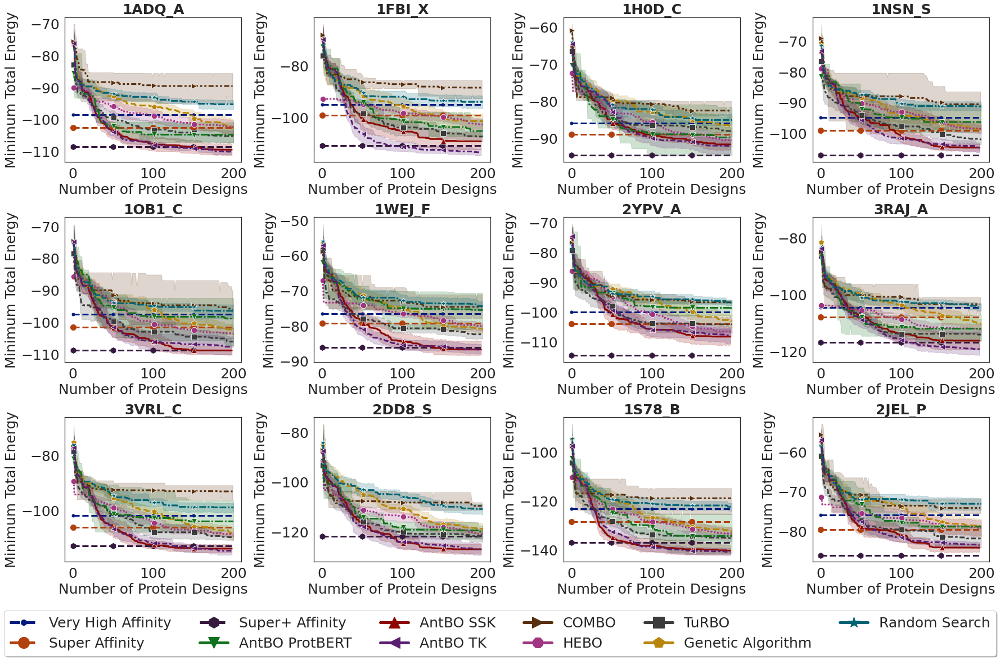

In [125]:
from tqdm import tqdm 
from copy import deepcopy 

# Markers = {'+','o','*','x','v','d','^','s','>','<'}
cols = 4
rows = 3
fig, axs = plt.subplots(nrows=rows, ncols=cols, figsize = (6.2*cols, 5*rows))
axs = axs.reshape(rows, cols)
row, col = 0, 0
fsize = 25
sns.set_style("white")
for antigen in tqdm(core_antigens):
    ax = axs[row, col] 
    if col == (cols-1):
        row += 1
        col = 0
    else:
        col += 1
    # Plot Absolut! Best
    min_best_affin = None
    try:
        tmp = thresholdPd[thresholdPd.AGname==antigen] 
        max_high_aff = tmp[tmp.type=='Heroes']['maxEnergy'].item()
        max_sh_affin = tmp[tmp.type=='SuperHeroes']['maxEnergy'].item()
        min_best_affin = tmp[tmp.type=='SuperHeroes']['minEnergy'].item()
        ax.plot(list(range(0, f_evals)), f_evals * [max_high_aff], marker=markerDINV['High Affinity'], markevery=50, markersize=10,
                 color=colourDINV['High Affinity'], linestyle='--', linewidth=3)
        ax.plot(list(range(0, f_evals)), f_evals * [max_sh_affin], marker=markerDINV['Super Affinity'], markevery=50, markersize=10,
                 color=colourDINV['Super Affinity'], linestyle='--', linewidth=3)
        print(antigen, max_high_aff, max_sh_affin, min_best_affin)
    except:
        pass
    
    sequences = None
    filenames = glob.glob(f"/mnt/data/CDRdata/RawBindingsMurine/{antigen}/*.txt")
    for i in range(len(filenames)):
        if i == 0:
            sequences = pd.read_csv(filenames[i], skiprows=1, sep='\t')
        else:
            sequences.append(pd.read_csv(filenames[i], skiprows=1, sep='\t'))
    
    min_energy = np.inf
    if (sequences is not None) or (min_best_affin is not None):
        if sequences is not None:
            min_energy = min(min_energy, sequences['Energy'].values.min())
        if min_best_affin is not None:
            min_energy = min(min_energy, min_best_affin)
        # min_energy *= -1.0
        f_evals = 200
        ax.plot(list(range(0, f_evals)), f_evals * [min_energy], marker=markerDINV['Absolut! 6.9M'], markevery=50, markersize=10,
                 color=sns.color_palette('rocket')[0], linestyle='--', linewidth=3)        
    else:
        pass 
    #Plot optimisers best
    ax.set_title(f"{antigen}", fontsize=fsize, fontweight="bold")
    ax.set_xlabel('Number of Protein Designs', fontsize=fsize)
    ax.set_ylabel('Minimum Total Energy', fontsize=fsize)
#     ax.grid()
    filtered = results[results['Antigen']==antigen]
    ax = sns.lineplot(data=filtered, ax=ax,  x='Num BB Evals', y='Best Binding Energy', hue = "Method", legend=False, linewidth=3, palette=colourDINV, style='Method', markers=markerDINV, markevery=50, markersize=10)
#     filtered = results[results['Antigen'].isin(core_antigens)]
#     filtered = filtered[~filtered['Method'].isin(core_optimisers)]
        

#     handles, labels = ax.get_legend_handles_labels()
#     ax.get_legend().set_visible(False)
#     plt.show()
#     break

ax.plot([], linestyle='--', color=colourDINV['High Affinity'], marker=markerDINV['High Affinity'], linewidth=5, markersize=20, label='Very High Affinity')
ax.plot([], linestyle='--', color=colourDINV['Super Affinity'], marker=markerDINV['Super Affinity'], linewidth=5, markersize=20, label='Super Affinity')
ax.plot([], linestyle='--', color=sns.color_palette('rocket')[0], marker=markerDINV['Absolut! 6.9M'], linewidth=5, markersize=20, label='Super+ Affinity')

for label_n in LabelDict.keys():
    if label_n in ['Absolut! 6.9M', 'Super Affinity', 'High Affinity']:
        pass
    else:
        ax.plot([], color=colourDINV[label_n], marker=markerDINV[label_n], label=LabelDict[label_n], linewidth=5, markersize=20)
    

handles, labels = ax.get_legend_handles_labels()
# handles = handles_all
# labels = labels_all
# labels = replace_labels(labels, LabelDict)
# labels, handles = zip(*sorted(zip(labels, handles)))
# for legend_handle in handles_all:
#     legend_handle._legmarker.set_markersize(20)
#     legend_handle.set_linewidth(20)
#     legend_handle._legmarker.set_markeredgewidth(20)
# handles_all = handles
# labels_all = labels

n_col_legend = len(labels)//2 + 1
lgd = fig.legend(handles, labels, bbox_to_anchor=(0.5, 0.0), ncol=n_col_legend, loc='upper center', fancybox=True, shadow=True, fontsize=25)
fig.tight_layout()
plt.savefig(os.path.join("/home/rladmin/antigenbinding/plots", "binding_vs_funct_evals.pdf"), bbox_extra_artists=(lgd, ), pad_inches=0.1, bbox_inches='tight')
plt.show()

In [23]:
order_all = [
 'BObert',
 'BO_ssk',
 'BO_transformed_overlap',
 'BO_COMBO',
 'HEBO',
 'TURBO',
 'GA']

100%|██████████████████████████████████████████████████████████████████████| 12/12 [00:01<00:00, 10.91it/s]


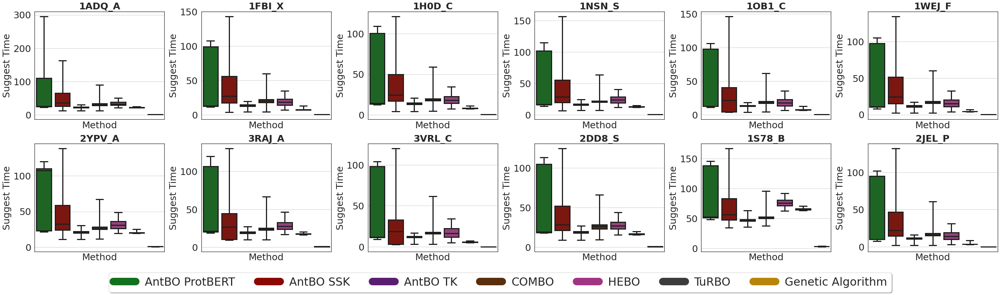

In [24]:
from tqdm import tqdm 
from copy import deepcopy 

cols = 6
rows = 2
fsize = 25
fig, axs = plt.subplots(nrows=rows, ncols=cols, figsize = (6.2*cols, 5*rows))
axs = axs.reshape(rows, cols)
matplotlib.rc('xtick', labelsize=fsize)
matplotlib.rc('ytick', labelsize=fsize)
row, col = 0, 0
plt.xticks(rotation=45)
sns.set_style("white")
for antigen in tqdm(core_antigens):
    
    ax = axs[row, col] 
    if col == (cols-1):
        row += 1
        col = 0
    else:
        col += 1
    ax.set_title(f"{antigen}", fontsize=fsize,fontweight="bold")
    ax.set_xlabel('# Protein Designs', fontsize=fsize)
    ax.set_ylabel('Suggestion Time', fontsize=fsize)
    ax.grid()
    filtered = results[results['Antigen']==antigen]
#     filtered = filtered[filtered.Method!='BObert']
#     ax = sns.lineplot(data=filtered, ax=ax,  x='Num BB Evals', y='Suggest Time', hue = "Method", legend=True)
#     handles, labels = ax.get_legend_handles_labels()
    ax = sns.boxplot(data=filtered,ax=ax, x="Method", y='Suggest Time', order=order_all,linewidth=3, palette=colourDINV, whis=100)
#     filtered = results[results['Antigen'].isin(core_antigens)]
#     filtered = filtered[~filtered['Method'].isin(core_optimisers)]
    ax.set_xticks([])
#     handles, labels = ax.get_legend_handles_labels()
#     ax.get_legend().set_visible(False)

for label_n in order_all:
    if 'Absolut! 6.9M'==label_n:
        pass
    else:
        ax.plot([], color=colourDINV[label_n], label=LabelDict[label_n], linewidth=20, markersize=20)
    
handles, labels = ax.get_legend_handles_labels()
# labels = replace_labels(labels, LabelDict)

# handles_all = handles
# labels_all = labels

n_col_legend = len(handles)
lgd = fig.legend(handles, labels, bbox_to_anchor=(0.5, 0.0), ncol=n_col_legend, loc='upper center', fancybox=True, shadow=True, fontsize=30)
fig.tight_layout()
# plt.tight_layout()
plt.savefig(os.path.join("/home/rladmin/antigenbinding/plots", "time_vs_funct_evals.pdf"), bbox_extra_artists=(lgd, ), pad_inches=0.1, bbox_inches='tight')
plt.show()


In [25]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

In [33]:
colourDINV

{'High Affinity': (0.0, 0.10980392156862745, 0.4980392156862745),
 'Absolut! 6.9M': (0.6941176470588235,
  0.25098039215686274,
  0.050980392156862744),
 'BObert': (0.07058823529411765, 0.44313725490196076, 0.10980392156862745),
 'BO_ssk': (0.5490196078431373, 0.03137254901960784, 0.0),
 'BO_transformed_overlap': (0.34901960784313724,
  0.11764705882352941,
  0.44313725490196076),
 'BO_COMBO': (0.34901960784313724, 0.1843137254901961, 0.050980392156862744),
 'HEBO': (0.6352941176470588, 0.20784313725490197, 0.5098039215686274),
 'TURBO': (0.23529411764705882, 0.23529411764705882, 0.23529411764705882),
 'GA': (0.7215686274509804, 0.5215686274509804, 0.0392156862745098),
 'RS': (0.0, 0.38823529411764707, 0.4549019607843137)}

In [36]:
order_all

['BObert',
 'BO_ssk',
 'BO_transformed_overlap',
 'BO_COMBO',
 'HEBO',
 'TURBO',
 'GA']

In [37]:
cols

6

  0%|                                                                               | 0/12 [00:00<?, ?it/s]

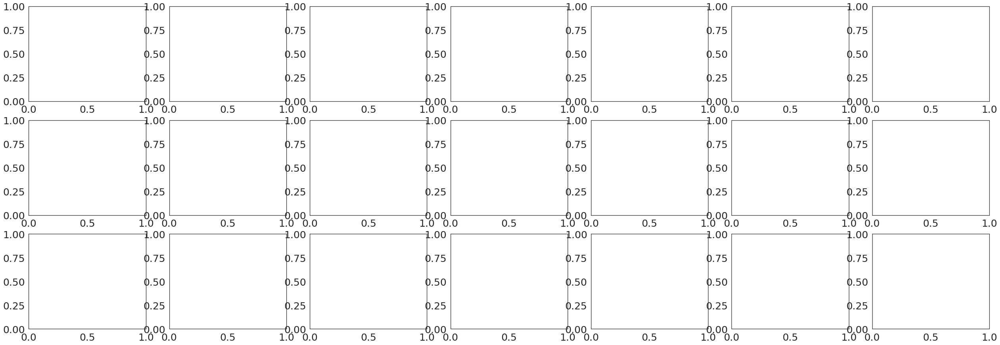


0it [00:00, ?it/s]

0 0 BObert


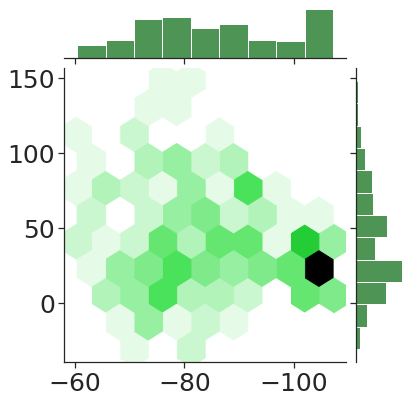

0 1 BO_ssk


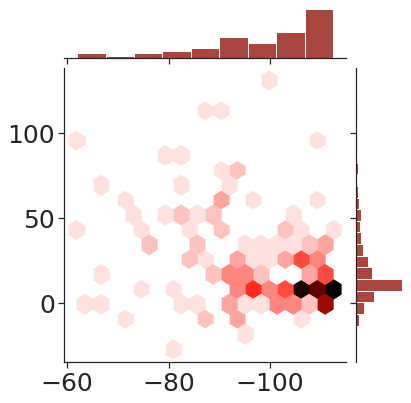

0 2 BO_transformed_overlap


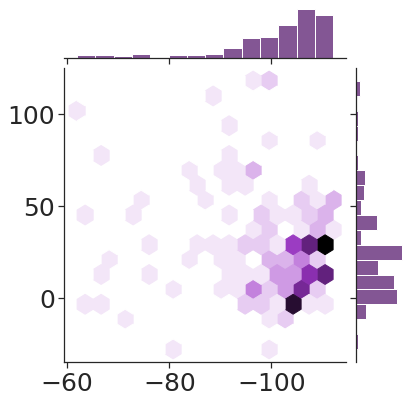

0 3 BO_COMBO


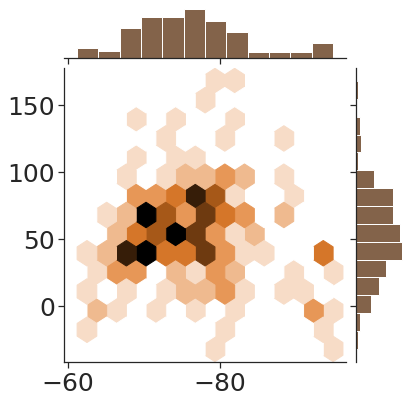

0 4 HEBO


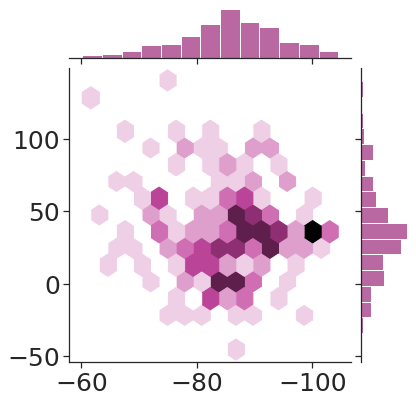

0 5 TURBO


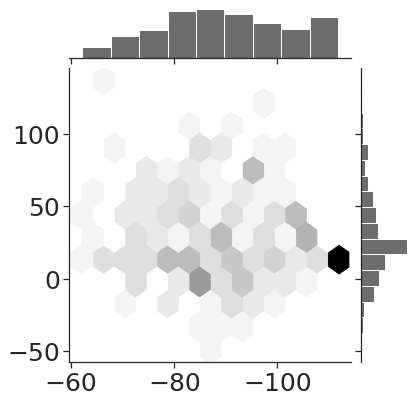

0 6 GA


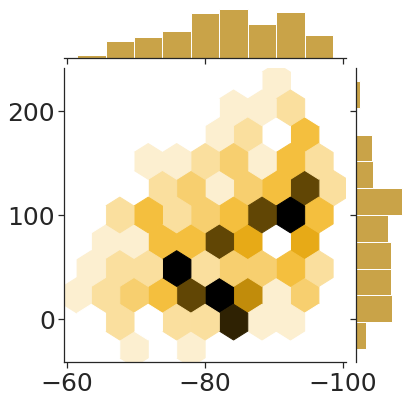


1it [00:03,  3.17s/it]

1 0 BObert


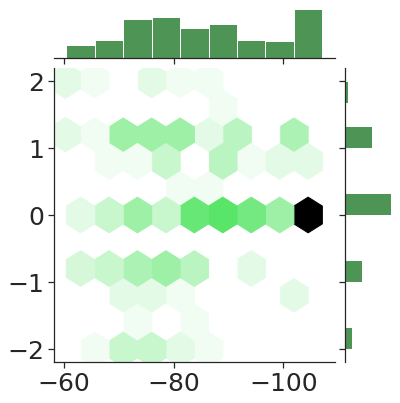

1 1 BO_ssk


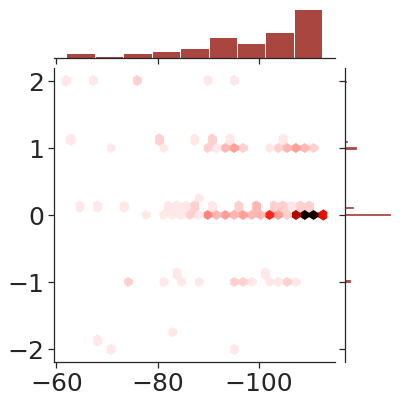

1 2 BO_transformed_overlap


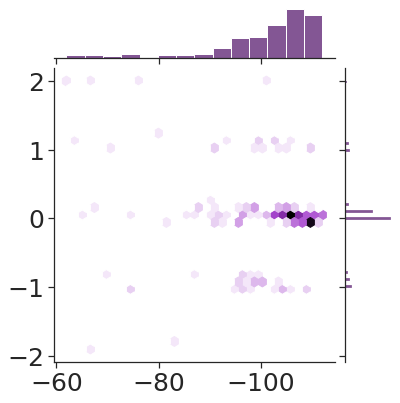

1 3 BO_COMBO


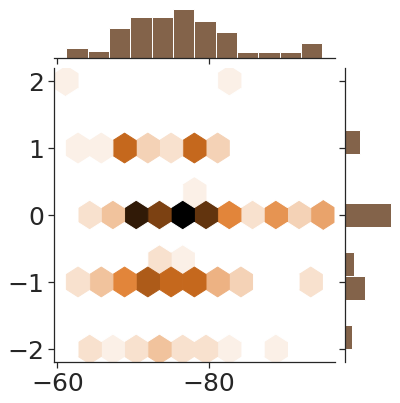

1 4 HEBO


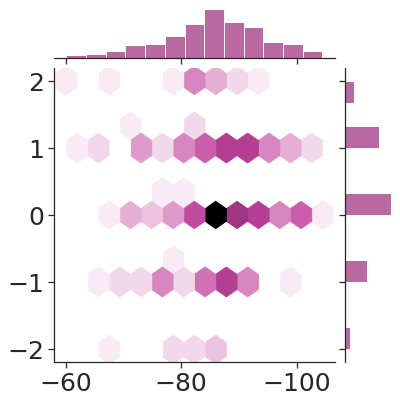

1 5 TURBO


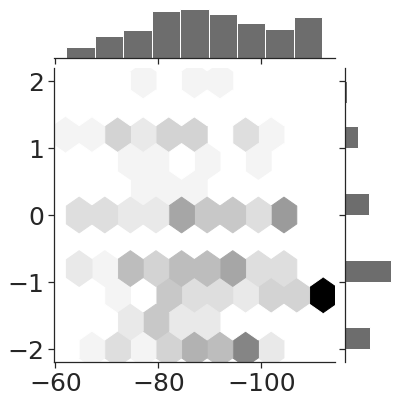

1 6 GA


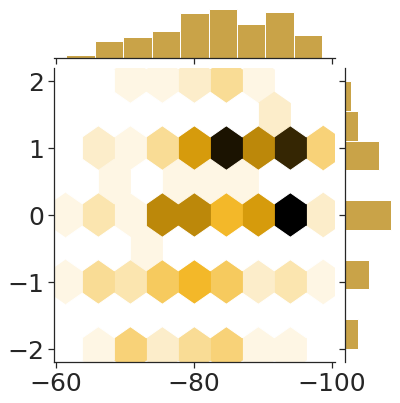


2it [00:06,  3.32s/it]

2 0 BObert


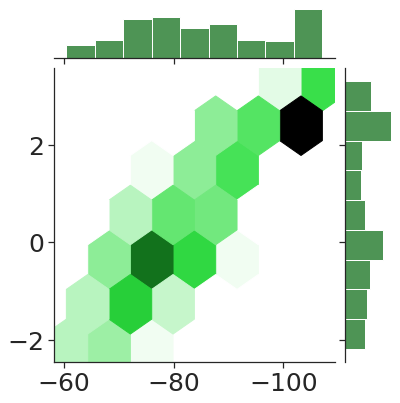

2 1 BO_ssk


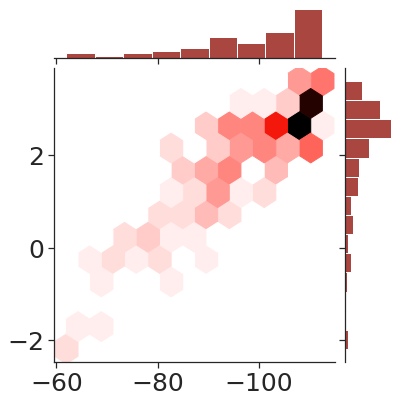

2 2 BO_transformed_overlap


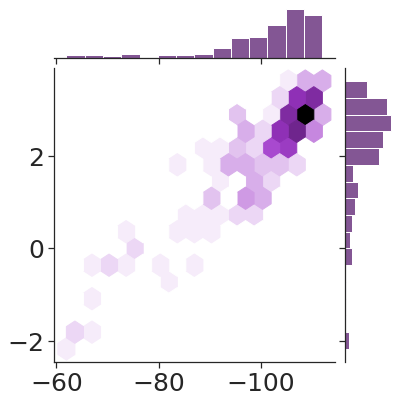

2 3 BO_COMBO


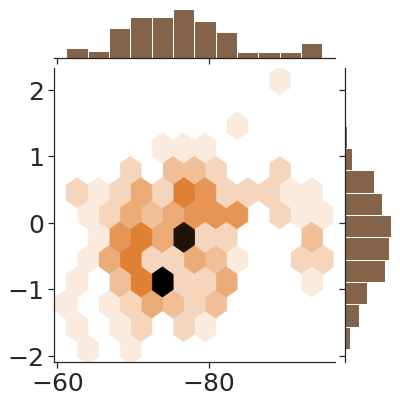

2 4 HEBO


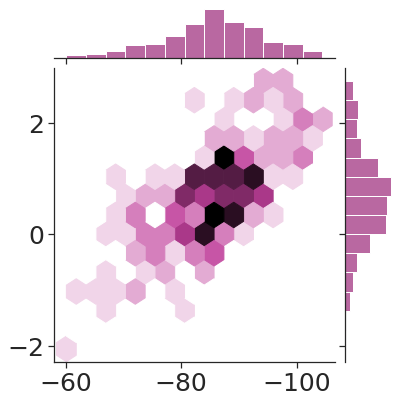

2 5 TURBO


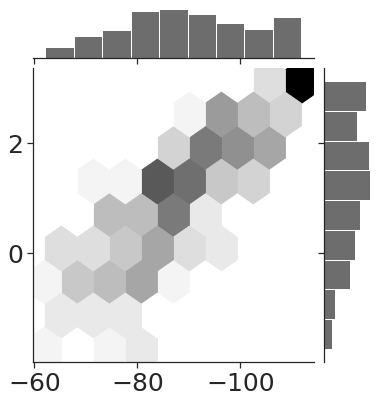

2 6 GA


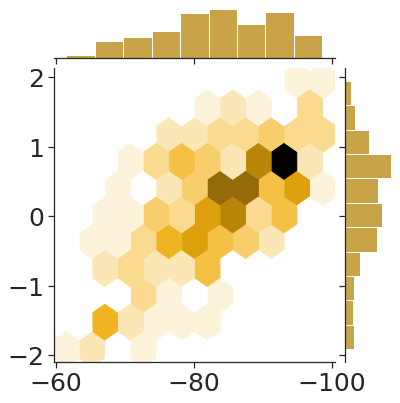


3it [00:10,  3.35s/it]
  8%|█████▉                                                                 | 1/12 [00:12<02:21, 12.85s/it]

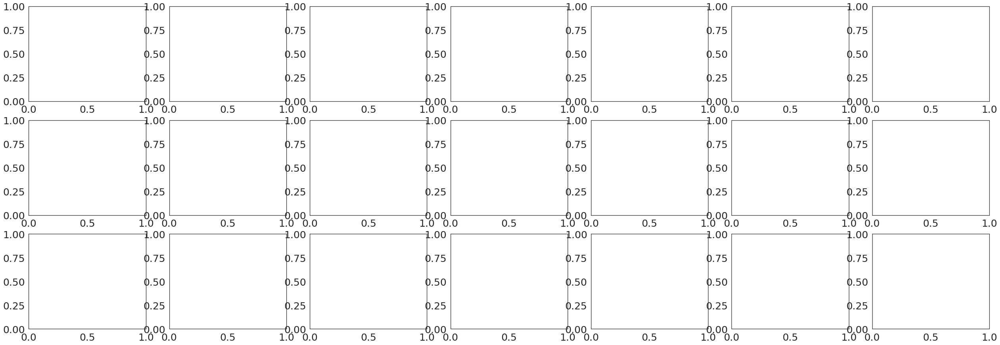


0it [00:00, ?it/s]

0 0 BObert


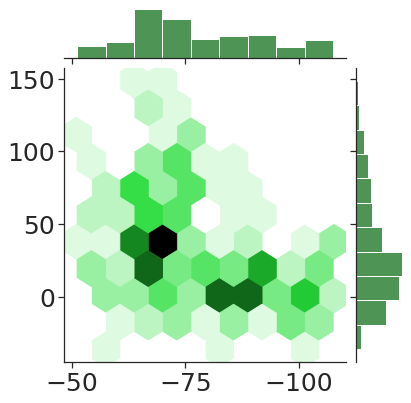

0 1 BO_ssk


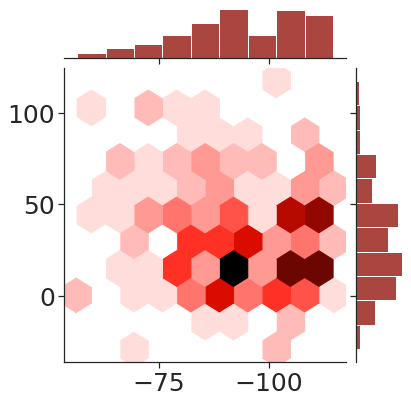

0 2 BO_transformed_overlap


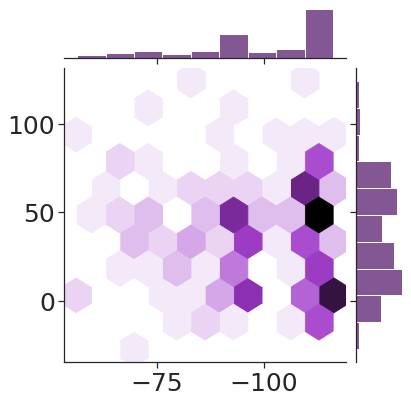

0 3 BO_COMBO


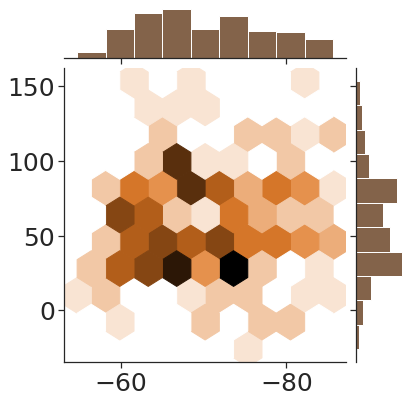

0 4 HEBO


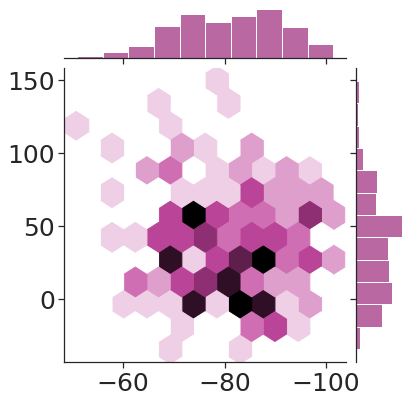

0 5 TURBO


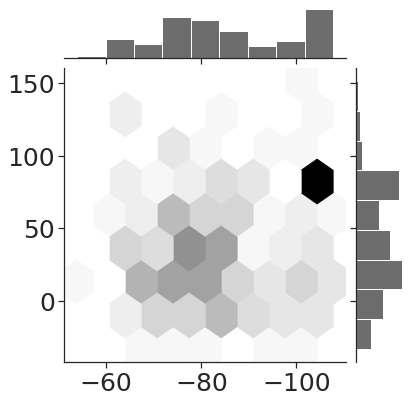

0 6 GA


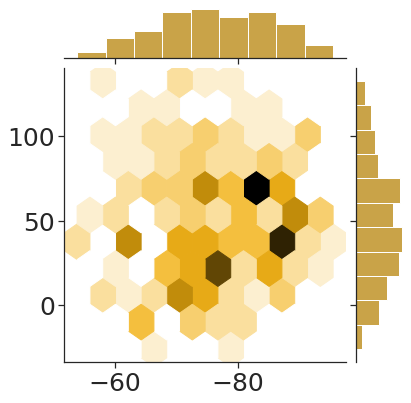


1it [00:02,  2.76s/it]

1 0 BObert


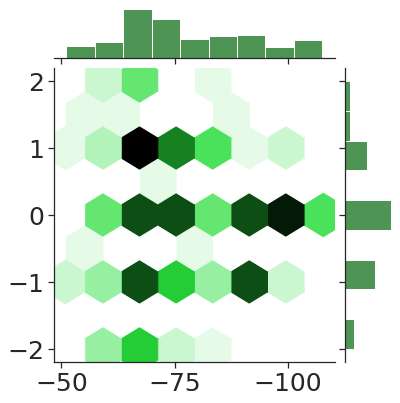

1 1 BO_ssk


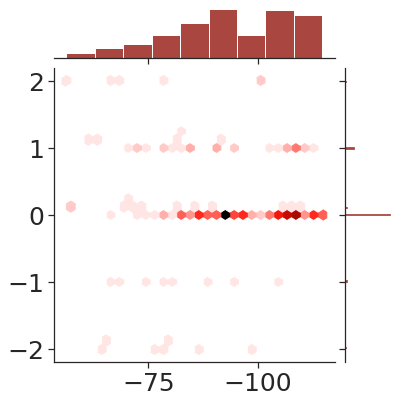

1 2 BO_transformed_overlap


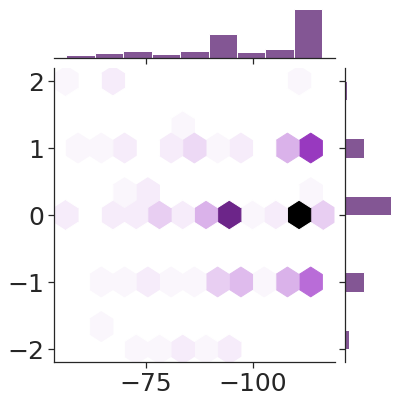

1 3 BO_COMBO


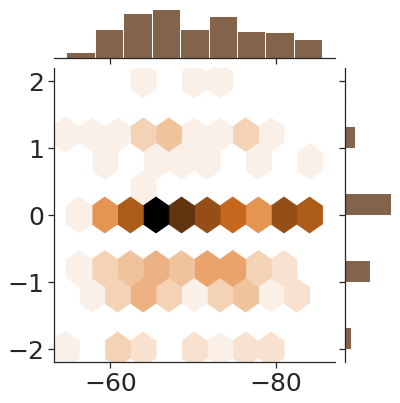

1 4 HEBO


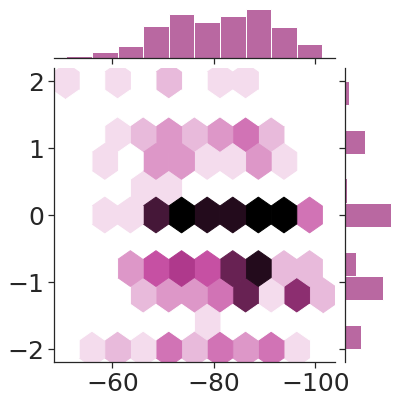

1 5 TURBO


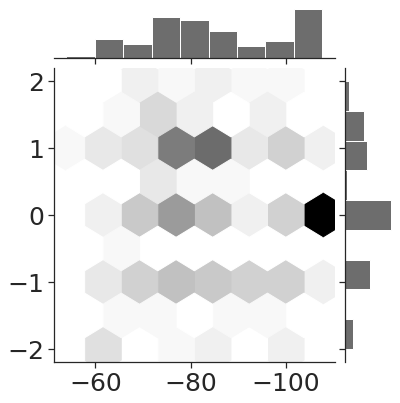

1 6 GA


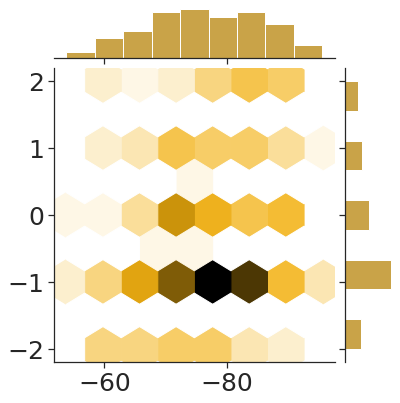


2it [00:06,  3.25s/it]

2 0 BObert


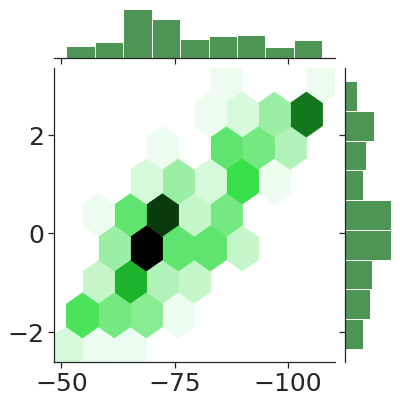

2 1 BO_ssk


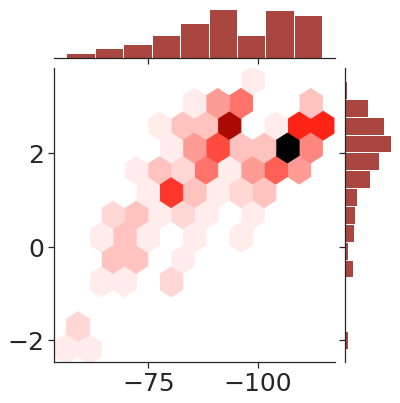

2 2 BO_transformed_overlap


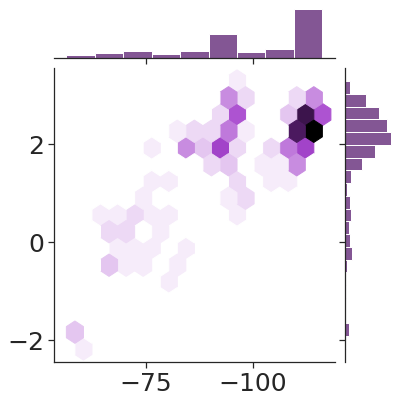

2 3 BO_COMBO


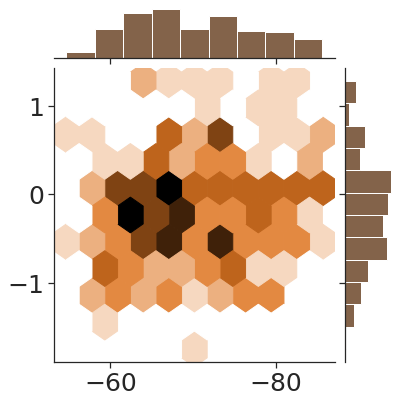

2 4 HEBO


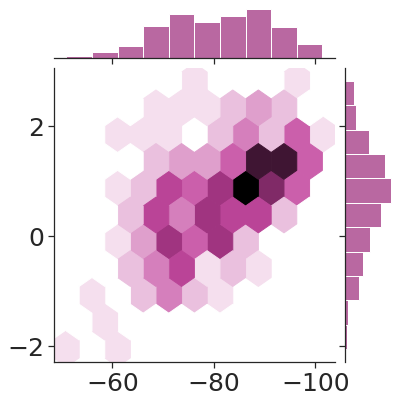

2 5 TURBO


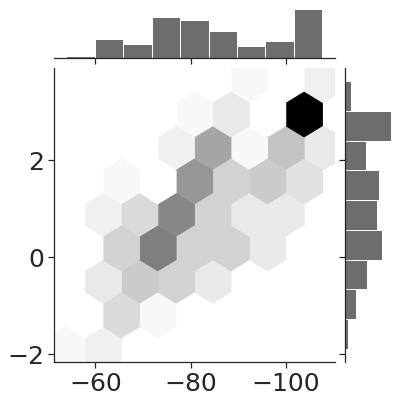

2 6 GA


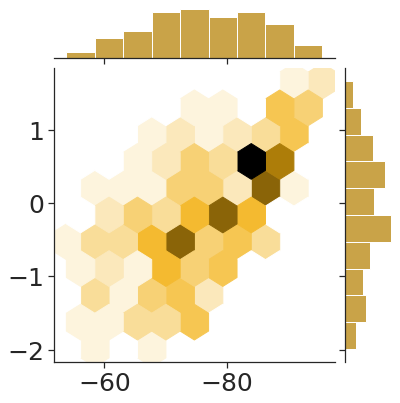


3it [00:09,  3.04s/it]
 17%|███████████▊                                                           | 2/12 [00:23<01:57, 11.74s/it]

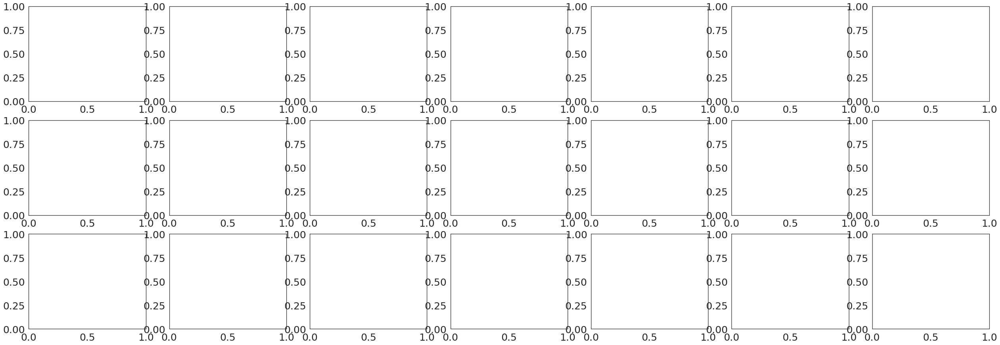


0it [00:00, ?it/s]

0 0 BObert


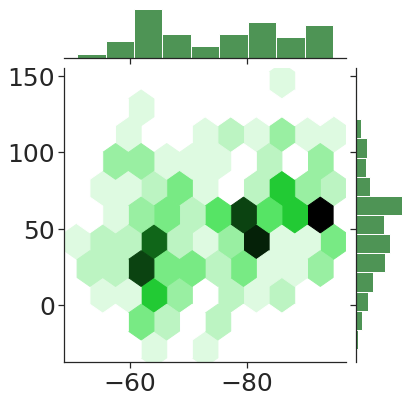

0 1 BO_ssk


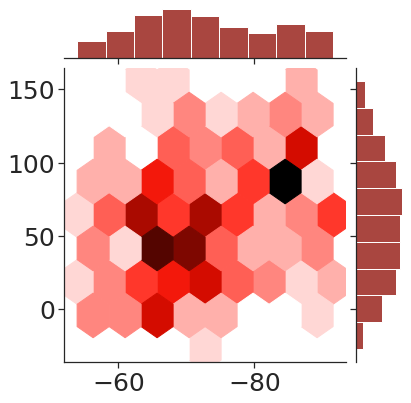

0 2 BO_transformed_overlap


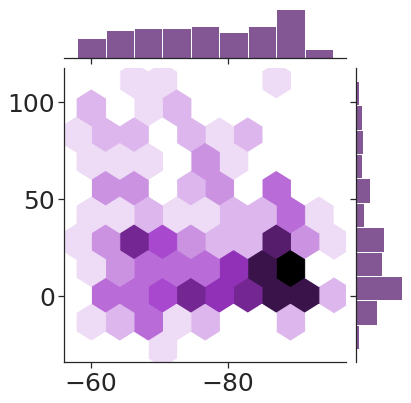

0 3 BO_COMBO


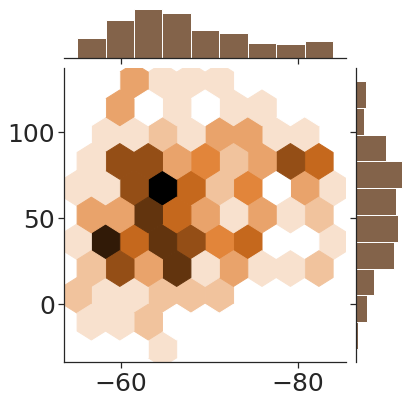

0 4 HEBO


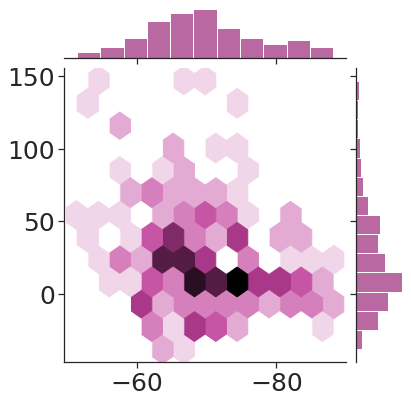

0 5 TURBO


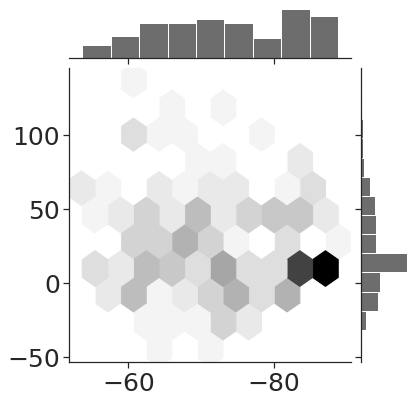

0 6 GA


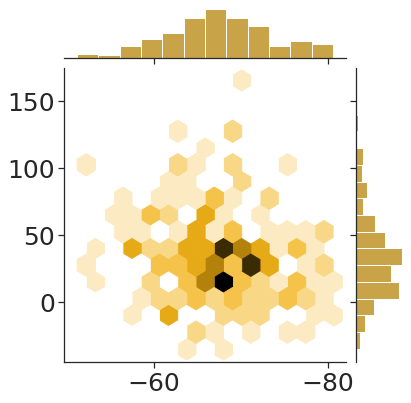


1it [00:02,  2.80s/it]

1 0 BObert


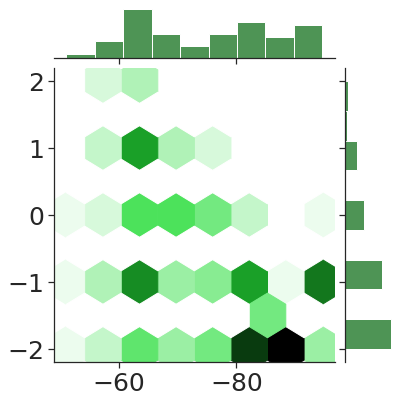

1 1 BO_ssk


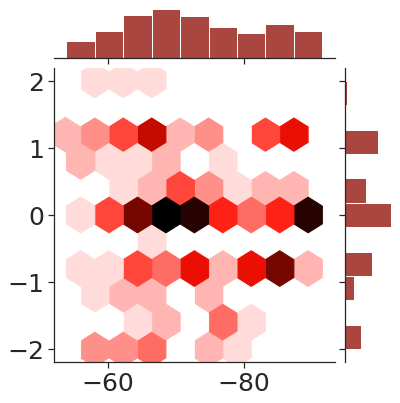

1 2 BO_transformed_overlap


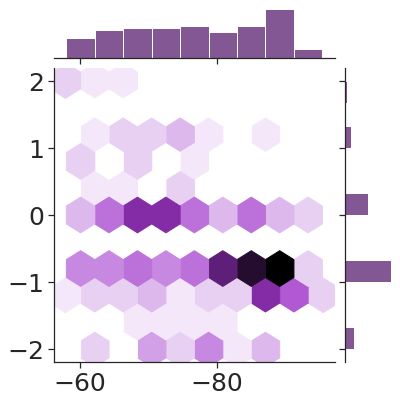

1 3 BO_COMBO


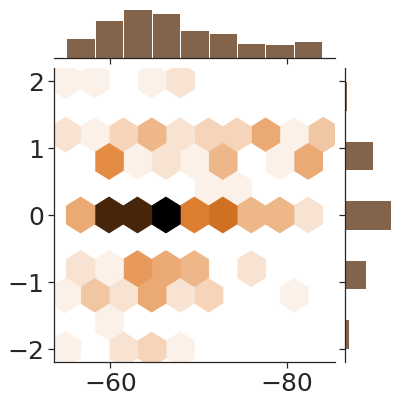

1 4 HEBO


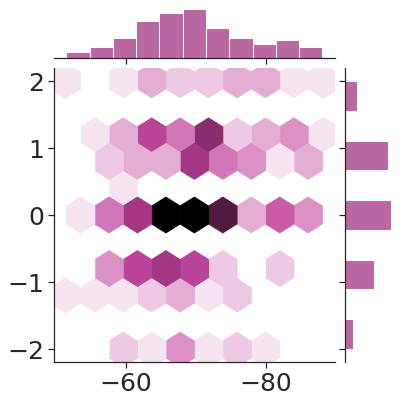

1 5 TURBO


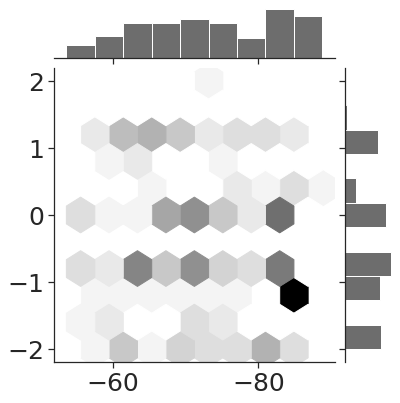

1 6 GA


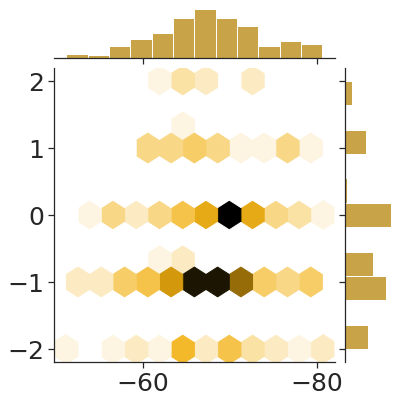


2it [00:06,  3.08s/it]

2 0 BObert


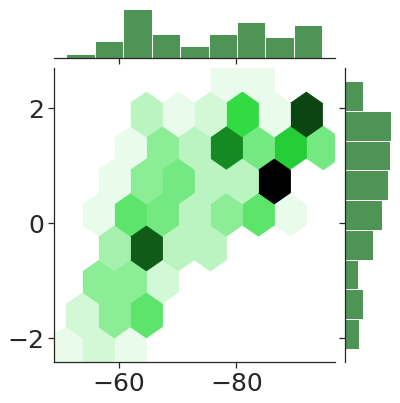

2 1 BO_ssk


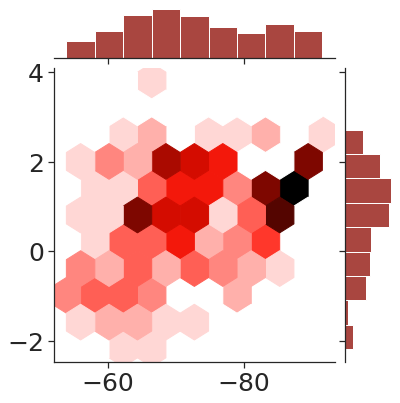

2 2 BO_transformed_overlap


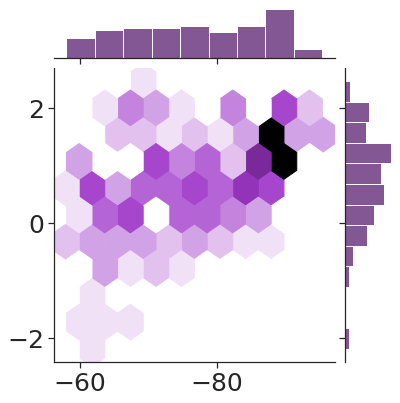

2 3 BO_COMBO


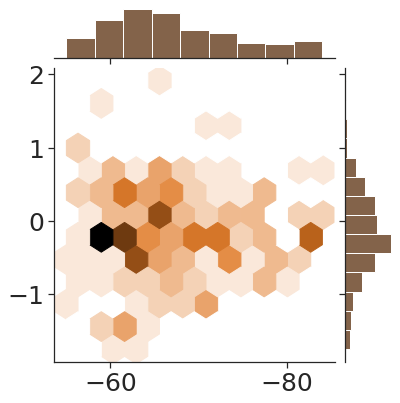

2 4 HEBO


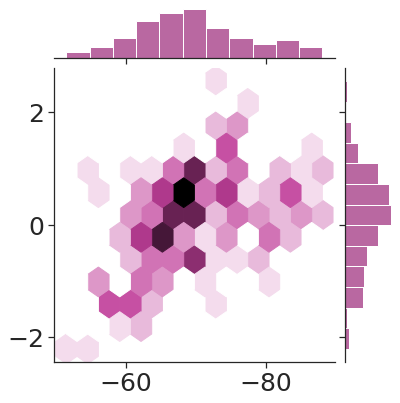

2 5 TURBO


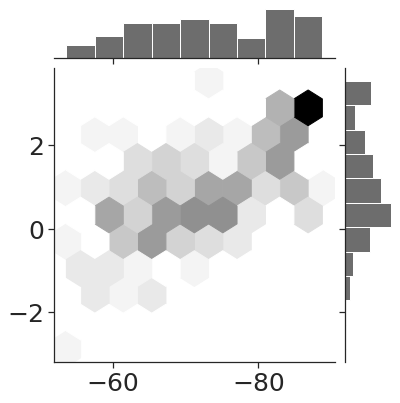

2 6 GA


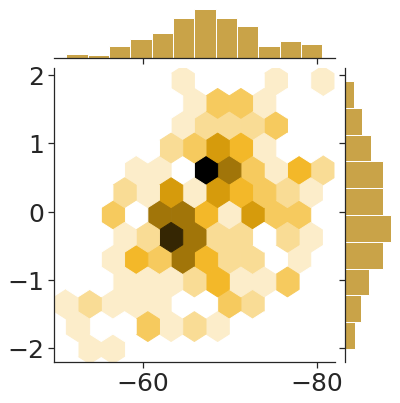


3it [00:08,  2.95s/it]
 25%|█████████████████▊                                                     | 3/12 [00:34<01:41, 11.26s/it]

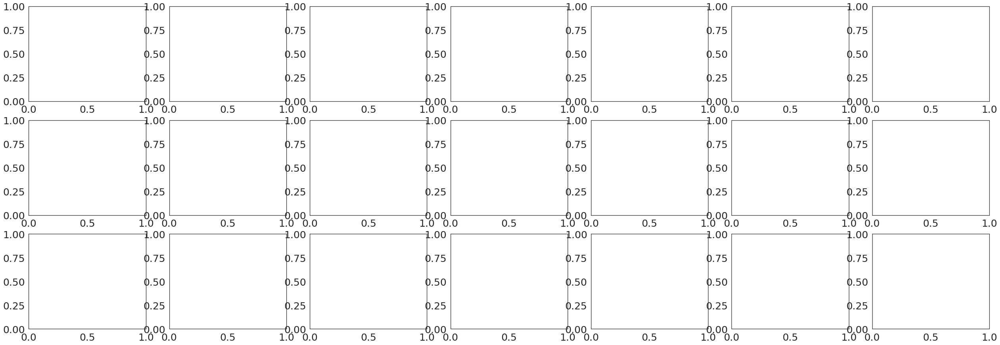


0it [00:00, ?it/s]

0 0 BObert


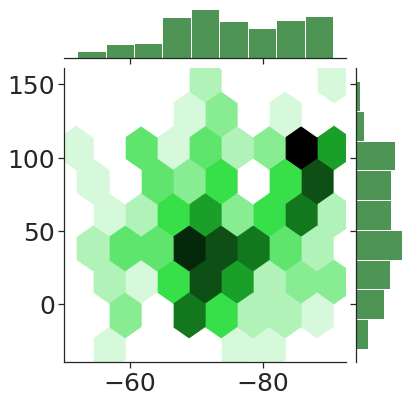

0 1 BO_ssk


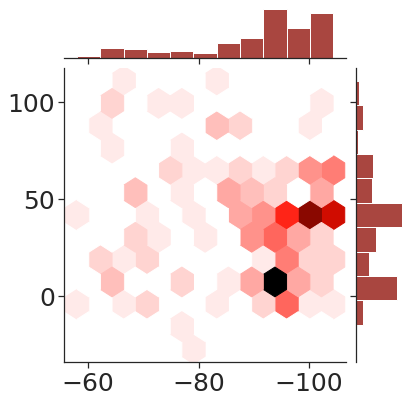

0 2 BO_transformed_overlap


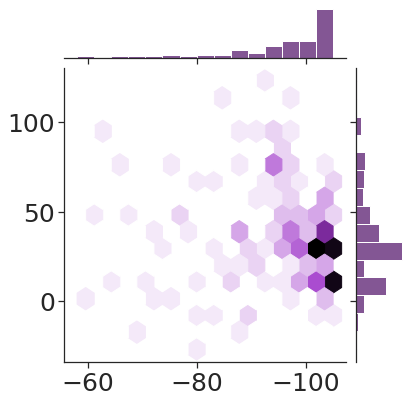

0 3 BO_COMBO


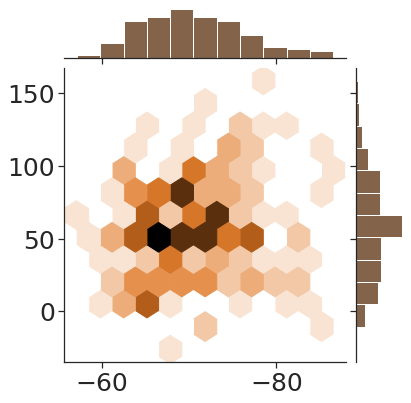

0 4 HEBO


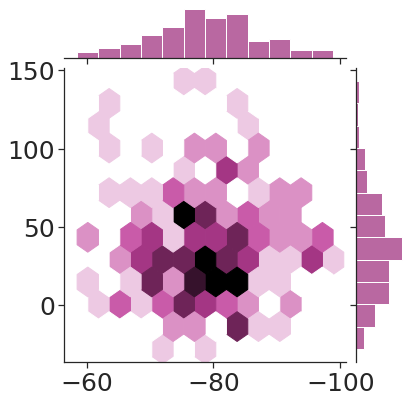

0 5 TURBO


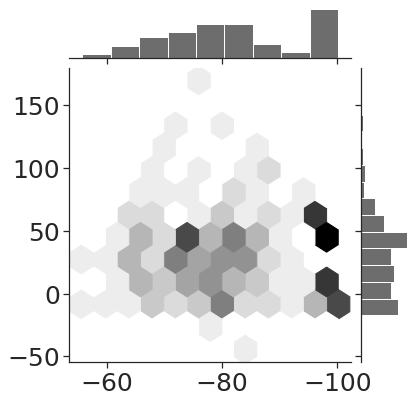

0 6 GA


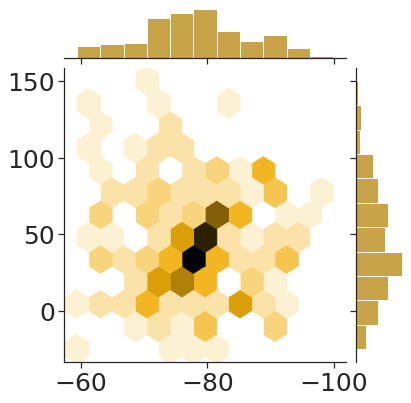


1it [00:03,  3.35s/it]

1 0 BObert


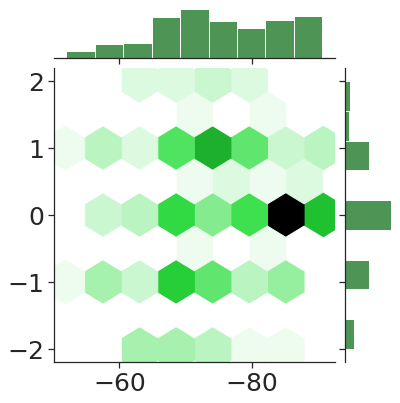

1 1 BO_ssk


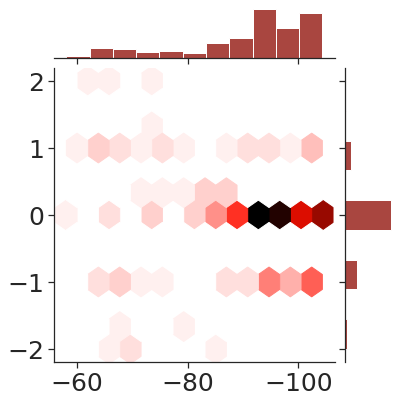

1 2 BO_transformed_overlap


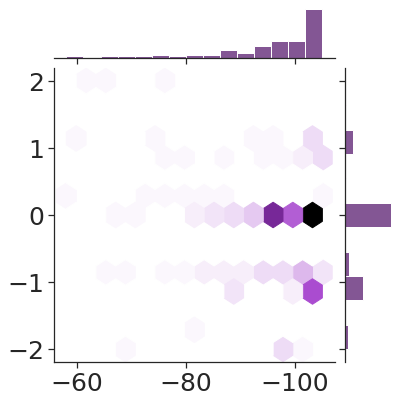

1 3 BO_COMBO


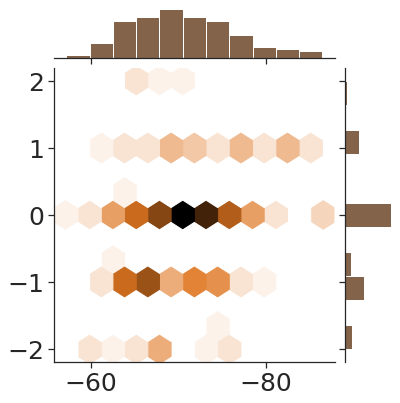

1 4 HEBO


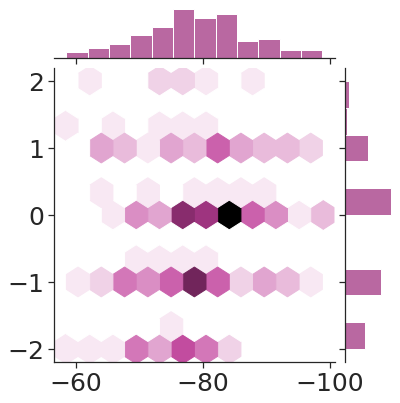

1 5 TURBO


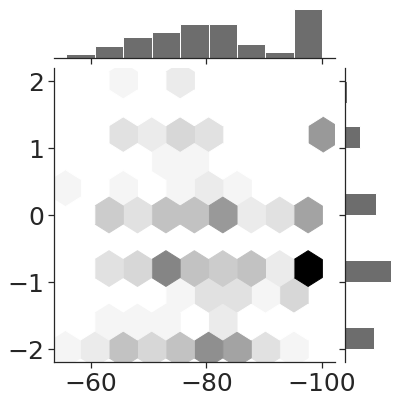

1 6 GA


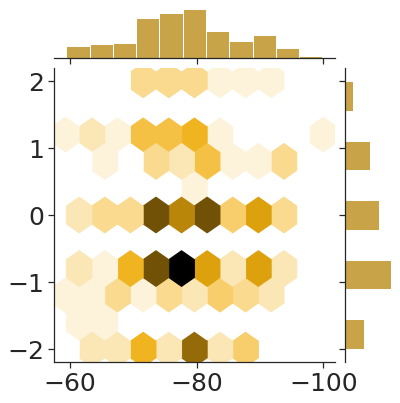


2it [00:06,  3.05s/it]

2 0 BObert


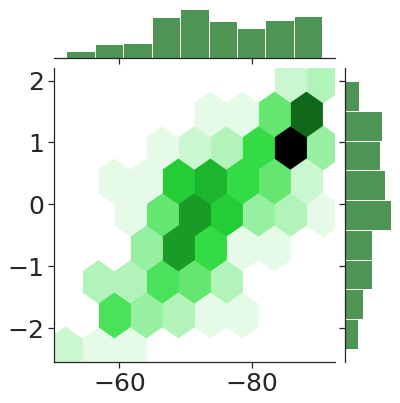

2 1 BO_ssk


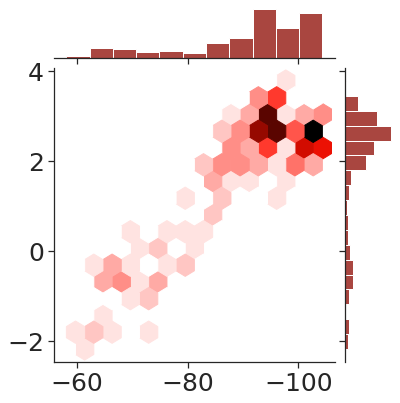

2 2 BO_transformed_overlap


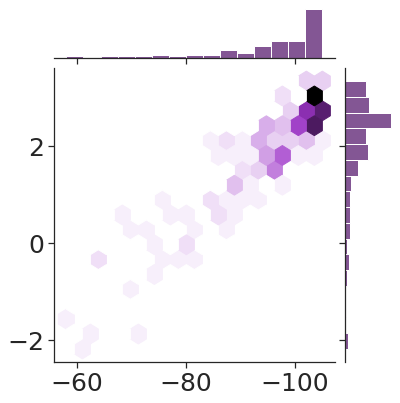

2 3 BO_COMBO


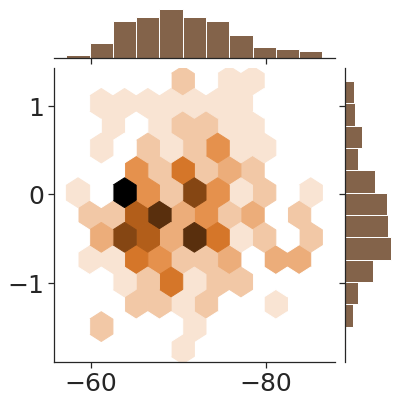

2 4 HEBO


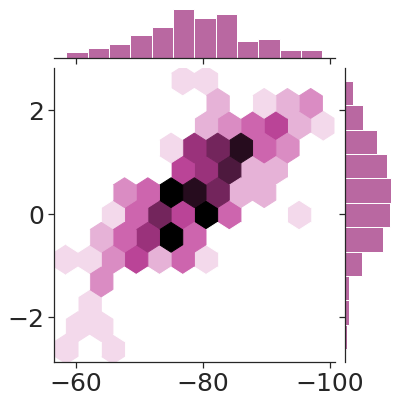

2 5 TURBO


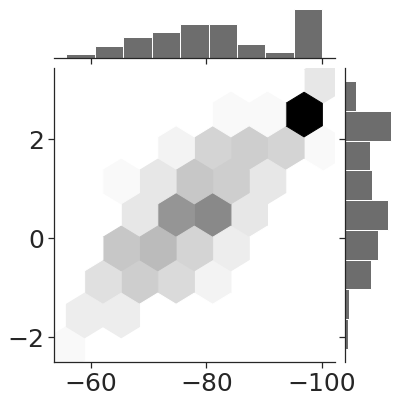

2 6 GA


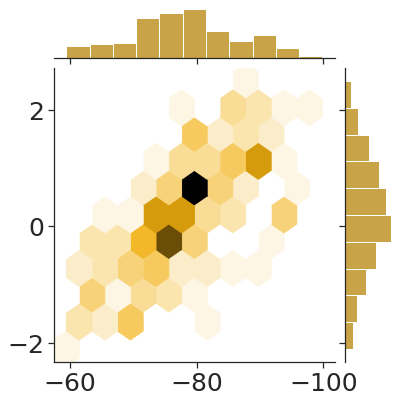


3it [00:09,  3.01s/it]
 33%|███████████████████████▋                                               | 4/12 [00:45<01:28, 11.10s/it]

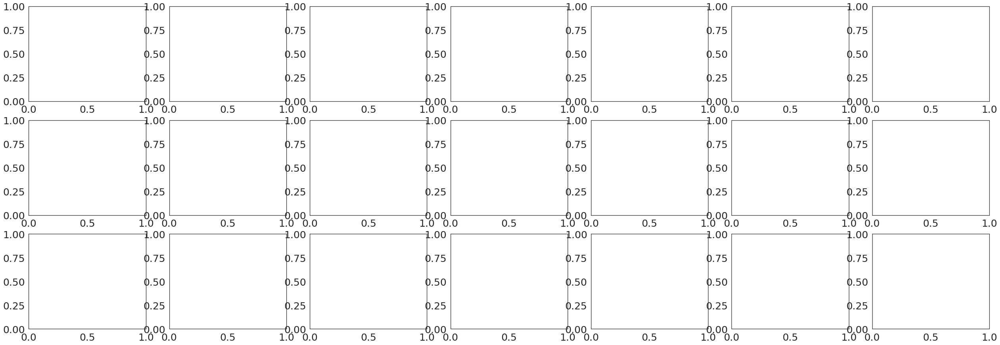


0it [00:00, ?it/s]

0 0 BObert


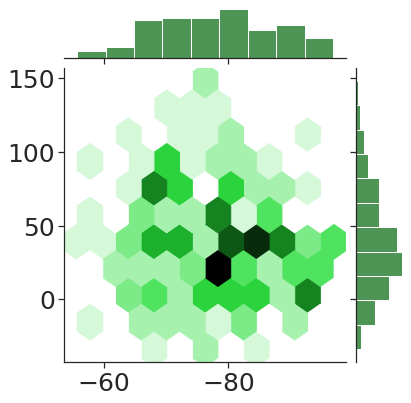

0 1 BO_ssk


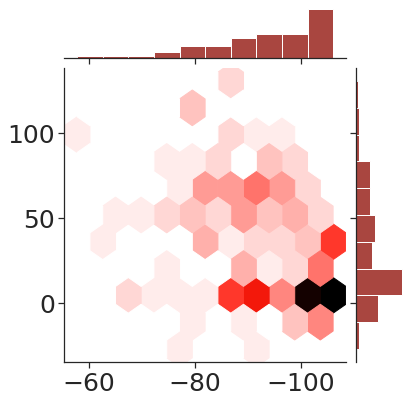

0 2 BO_transformed_overlap


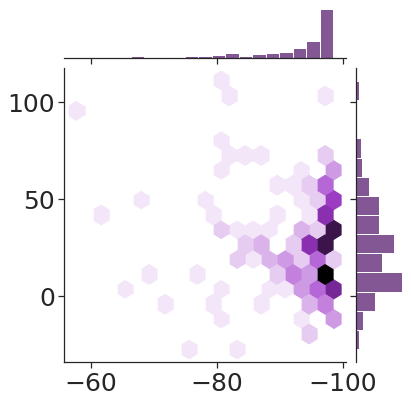

0 3 BO_COMBO


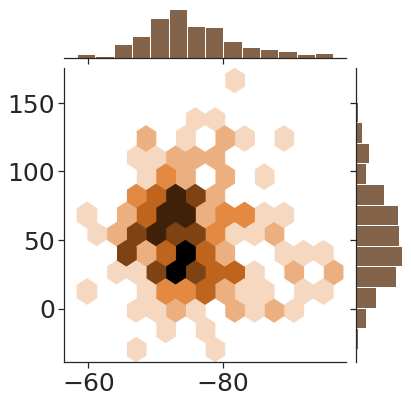

0 4 HEBO


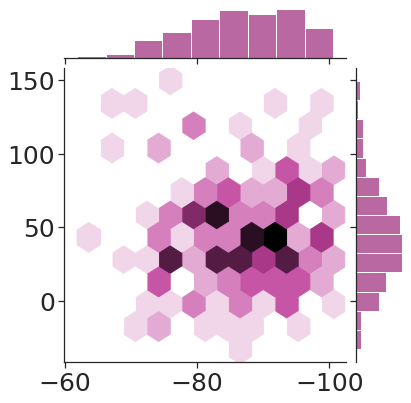

0 5 TURBO


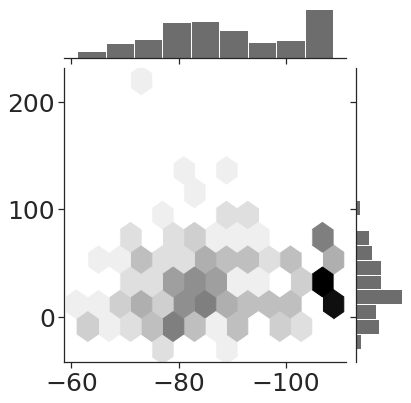

0 6 GA


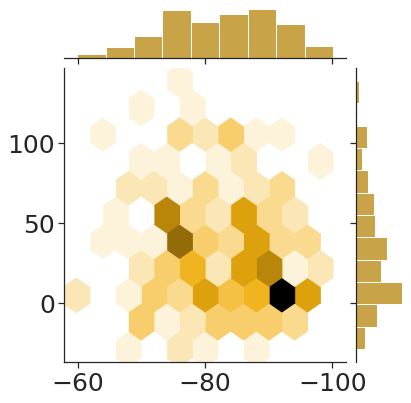


1it [00:03,  3.31s/it]

1 0 BObert


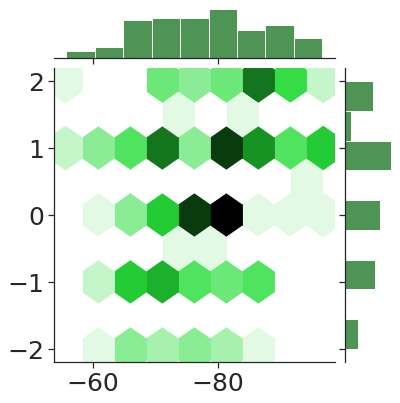

1 1 BO_ssk


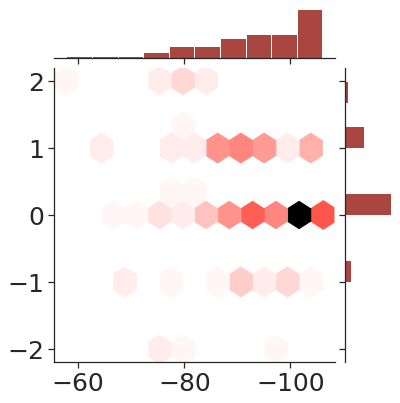

1 2 BO_transformed_overlap


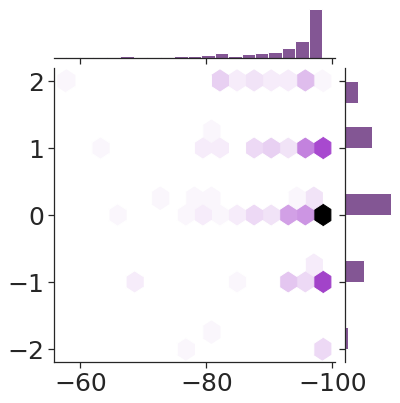

1 3 BO_COMBO


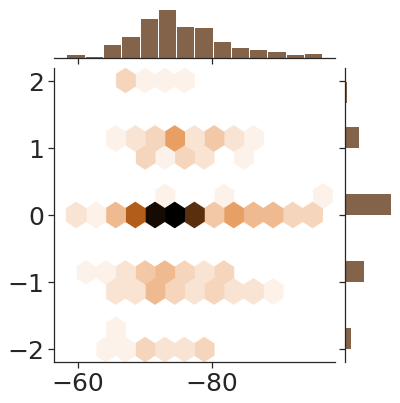

1 4 HEBO


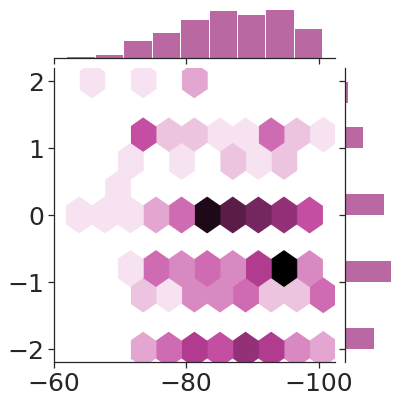

1 5 TURBO


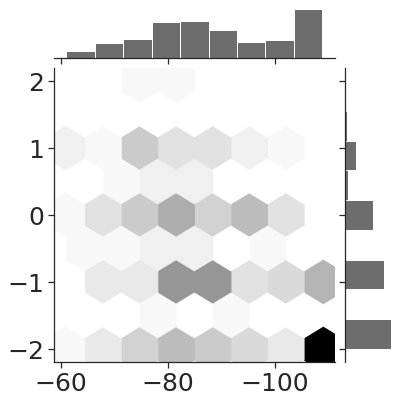

1 6 GA


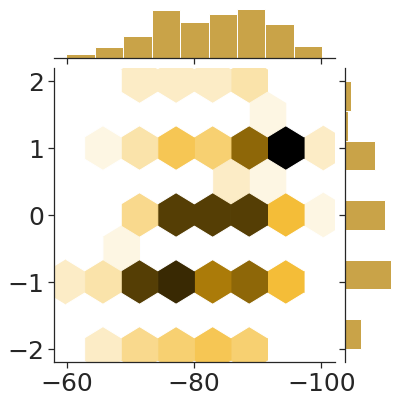


2it [00:06,  3.05s/it]

2 0 BObert


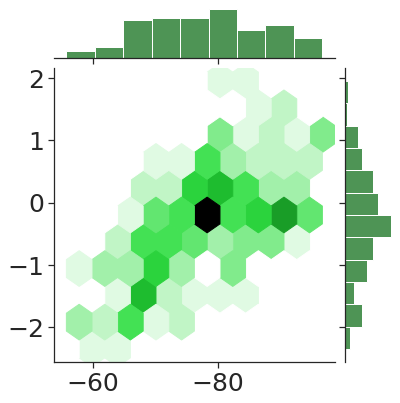

2 1 BO_ssk


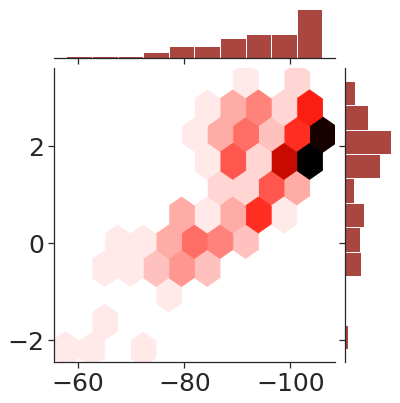

2 2 BO_transformed_overlap


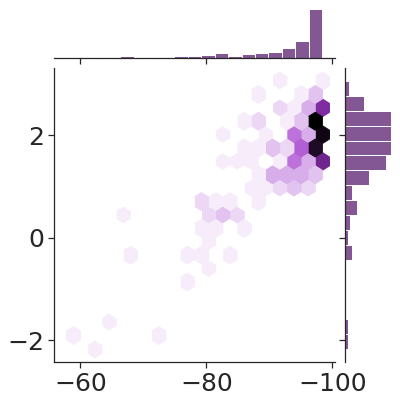

2 3 BO_COMBO


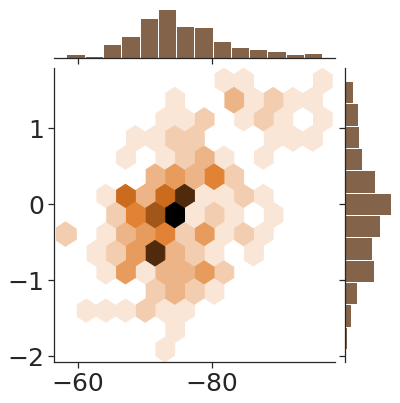

2 4 HEBO


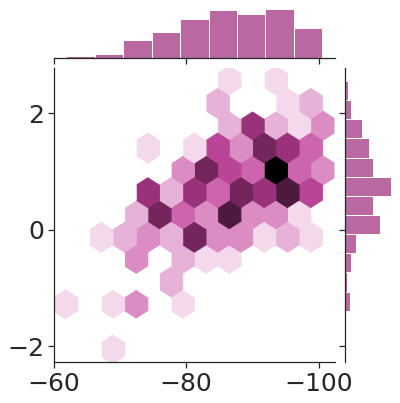

2 5 TURBO


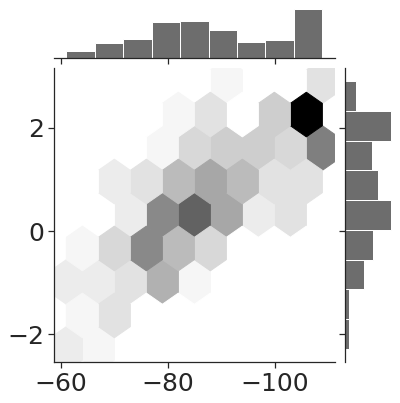

2 6 GA


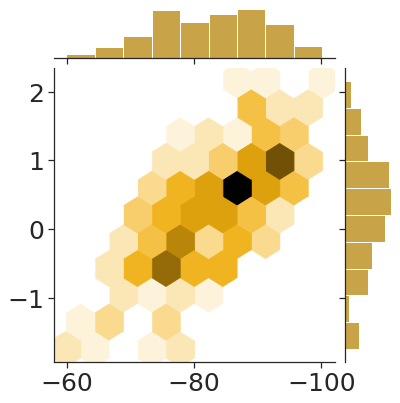


3it [00:09,  3.02s/it]
 42%|█████████████████████████████▌                                         | 5/12 [00:56<01:17, 11.02s/it]

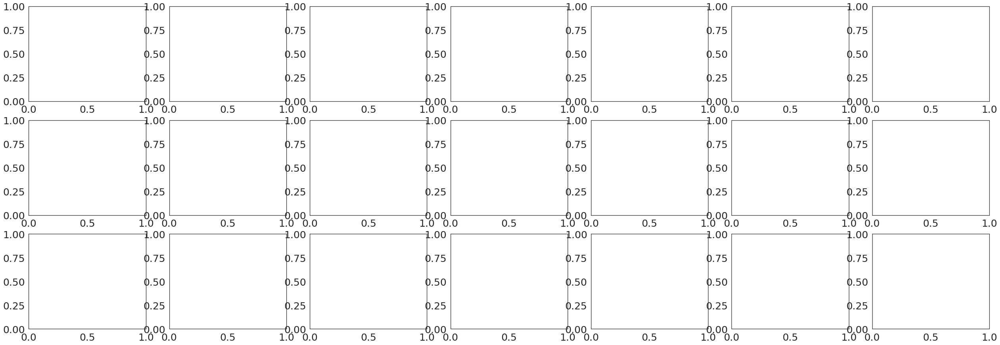


0it [00:00, ?it/s]

0 0 BObert


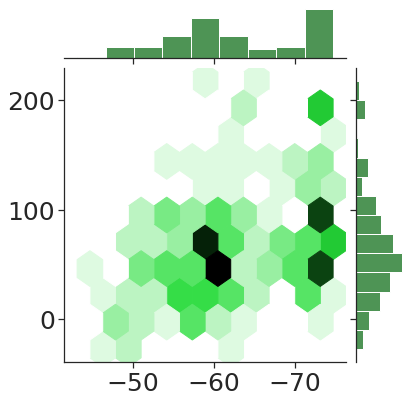

0 1 BO_ssk


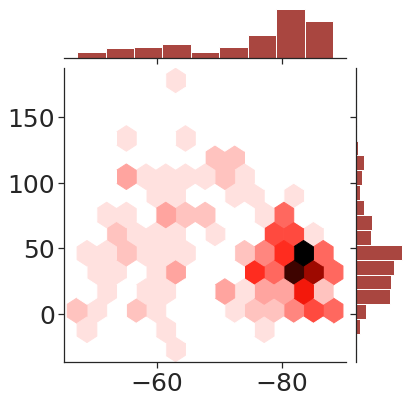

0 2 BO_transformed_overlap


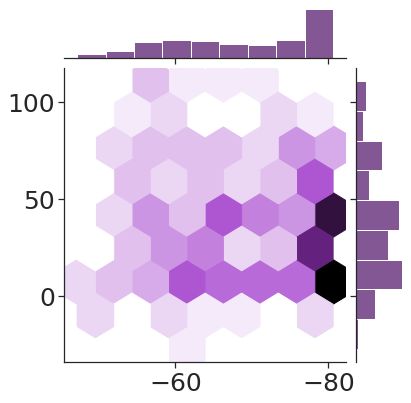

0 3 BO_COMBO


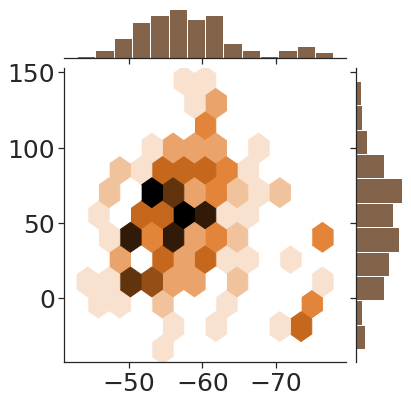

0 4 HEBO


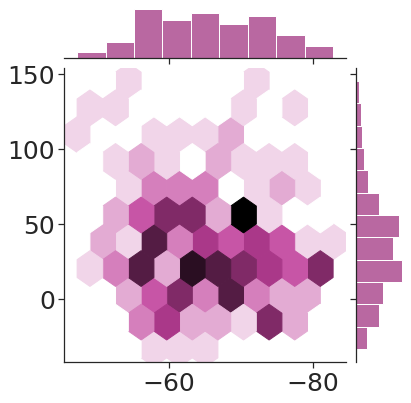

0 5 TURBO


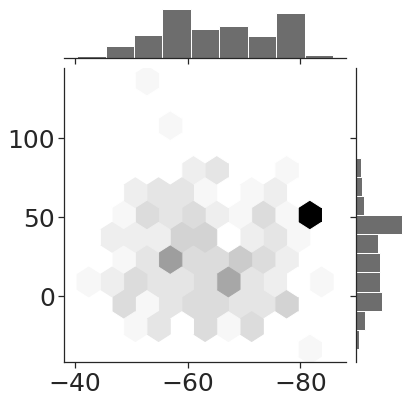

0 6 GA


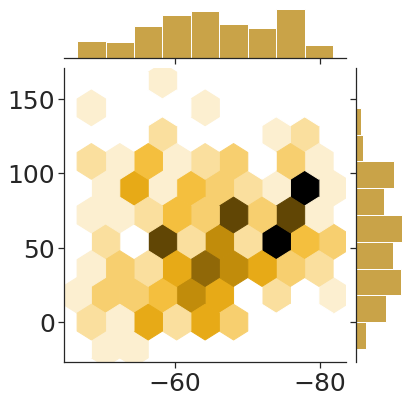


1it [00:02,  2.80s/it]

1 0 BObert


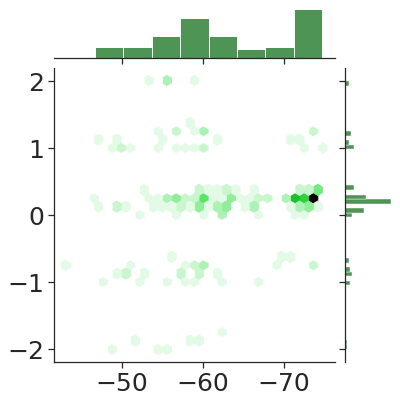

1 1 BO_ssk


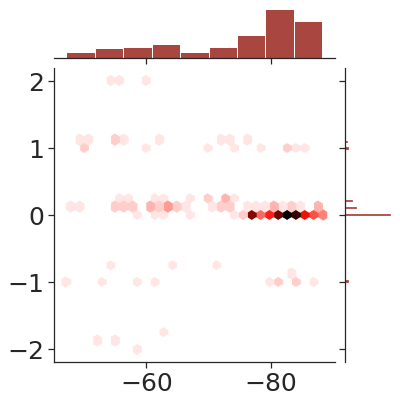

1 2 BO_transformed_overlap


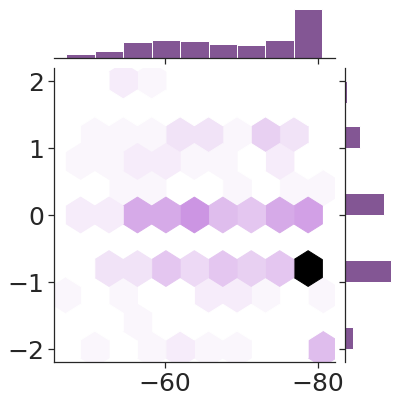

1 3 BO_COMBO


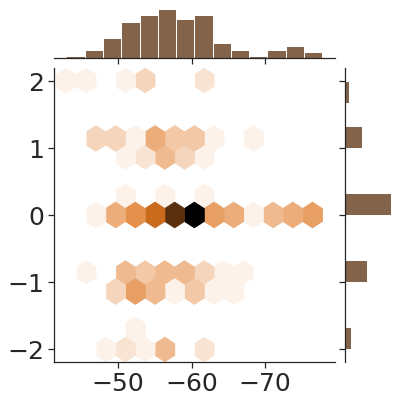

1 4 HEBO


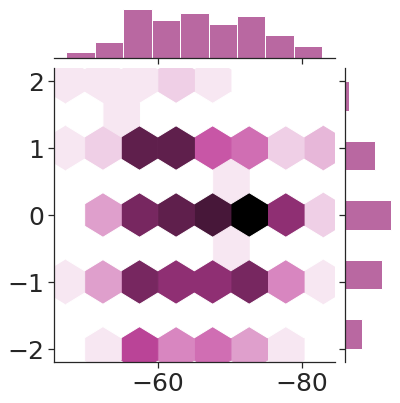

1 5 TURBO


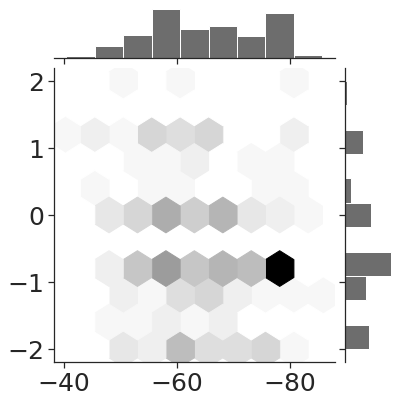

1 6 GA


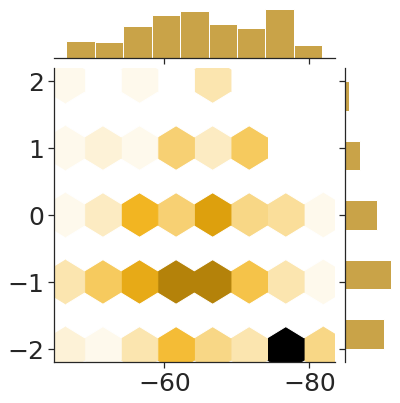


2it [00:06,  3.04s/it]

2 0 BObert


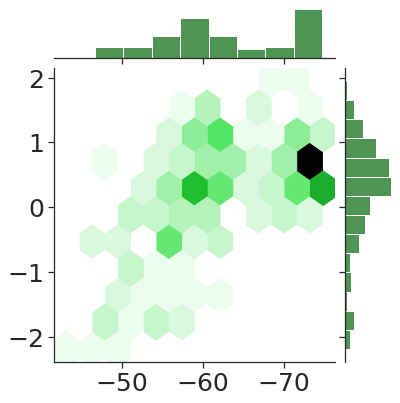

2 1 BO_ssk


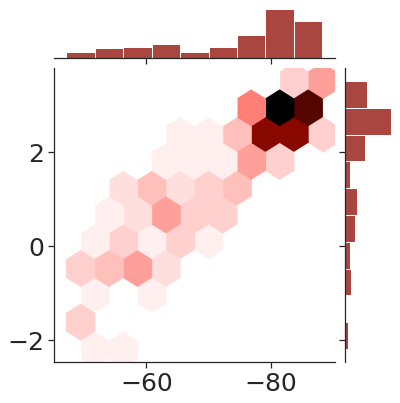

2 2 BO_transformed_overlap


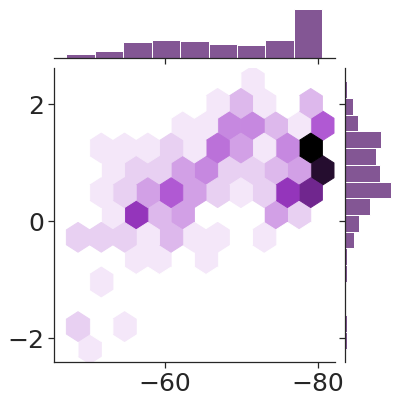

2 3 BO_COMBO


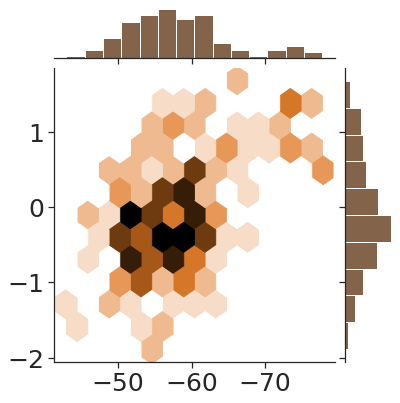

2 4 HEBO


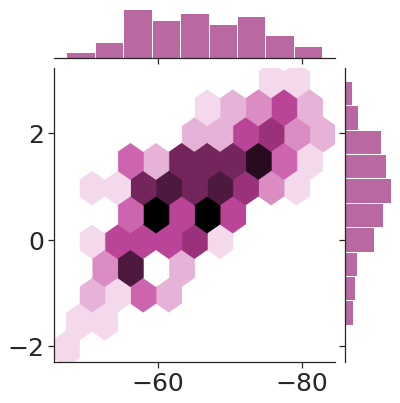

2 5 TURBO


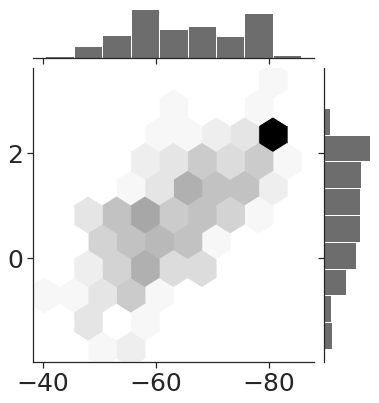

2 6 GA


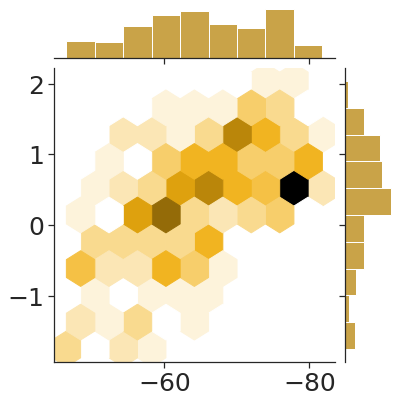


3it [00:09,  3.10s/it]
 50%|███████████████████████████████████▌                                   | 6/12 [01:07<01:07, 11.21s/it]

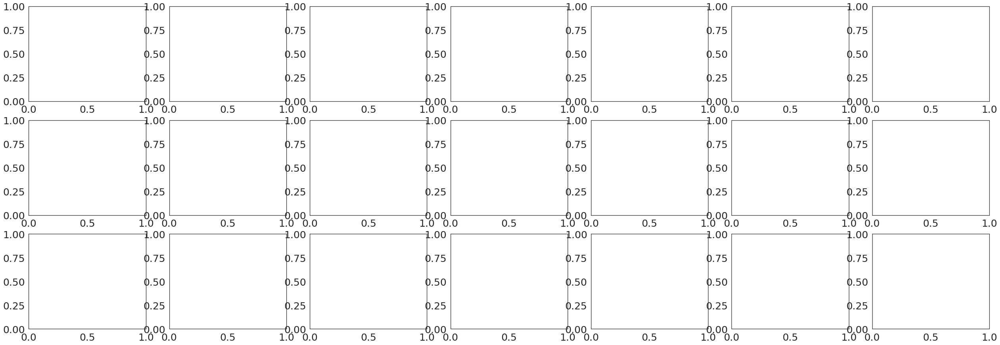


0it [00:00, ?it/s]

0 0 BObert


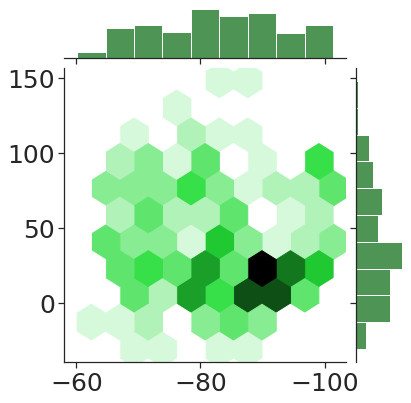

0 1 BO_ssk


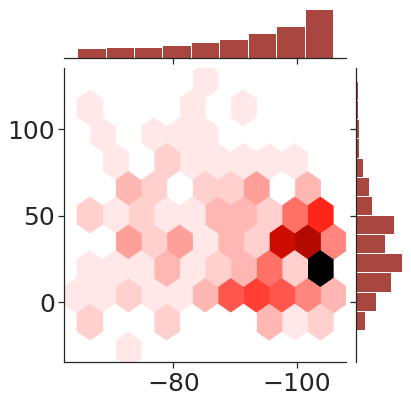

0 2 BO_transformed_overlap


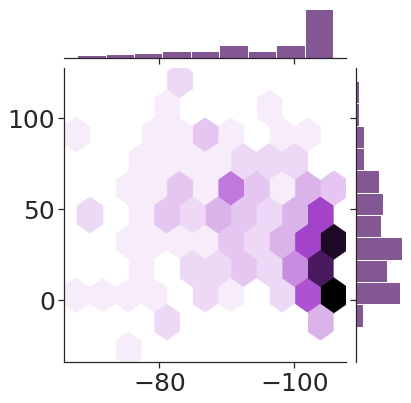

0 3 BO_COMBO


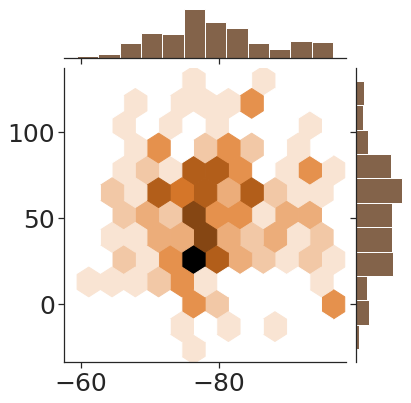

0 4 HEBO


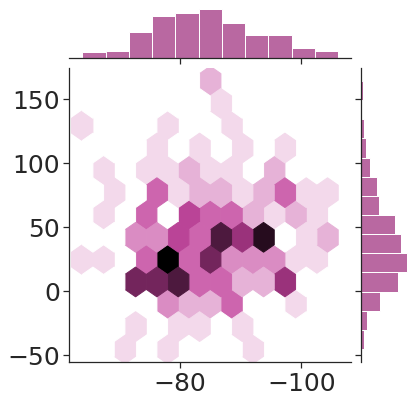

0 5 TURBO


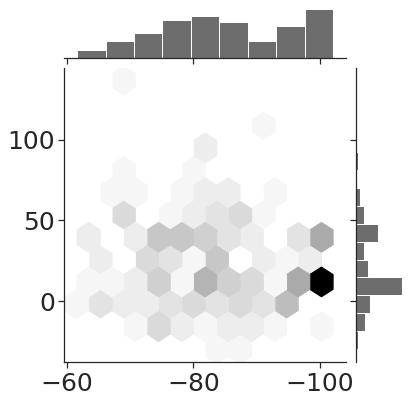

0 6 GA


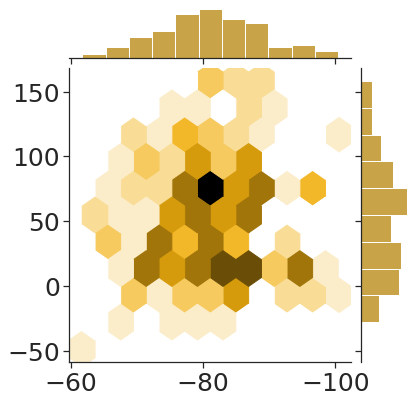


1it [00:02,  2.79s/it]

1 0 BObert


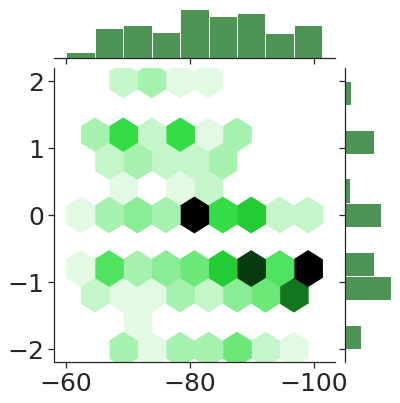

1 1 BO_ssk


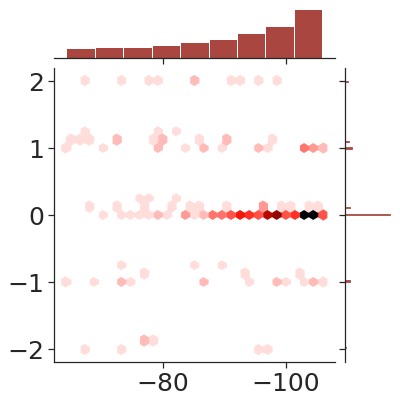

1 2 BO_transformed_overlap


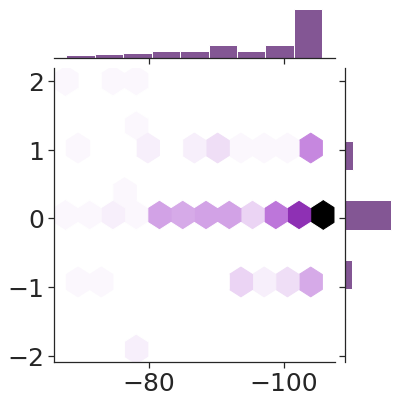

1 3 BO_COMBO


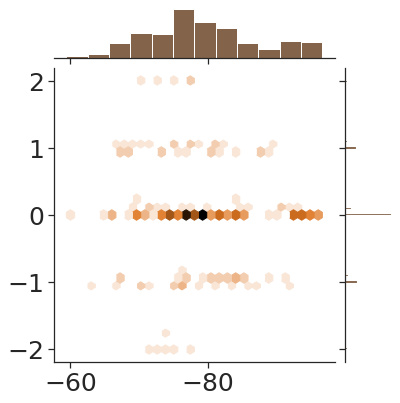

1 4 HEBO


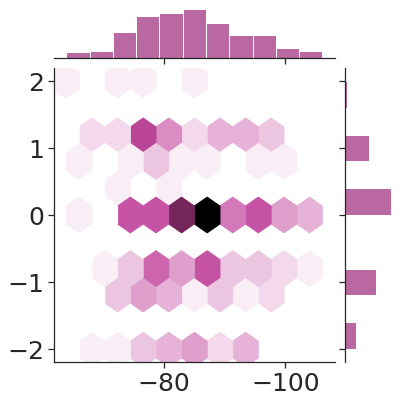

1 5 TURBO


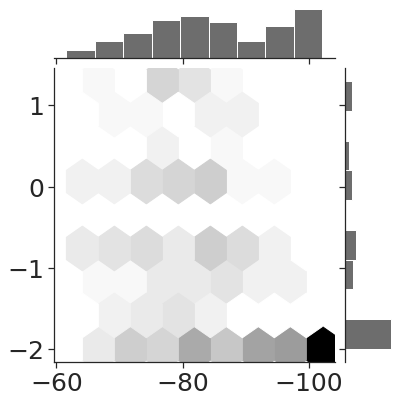

1 6 GA


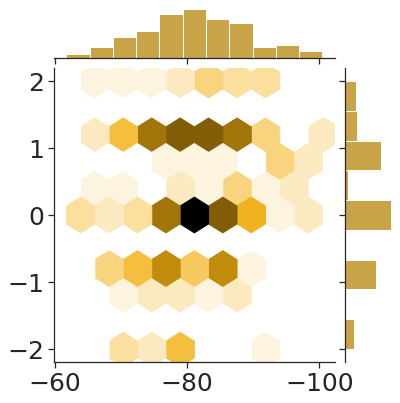


2it [00:06,  3.50s/it]

2 0 BObert


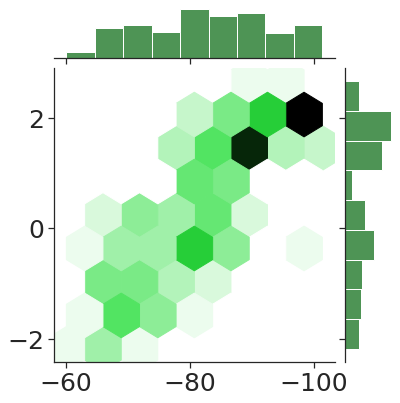

2 1 BO_ssk


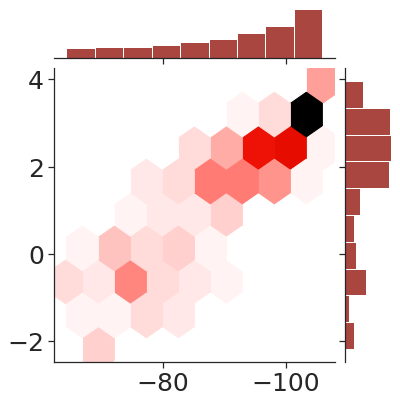

2 2 BO_transformed_overlap


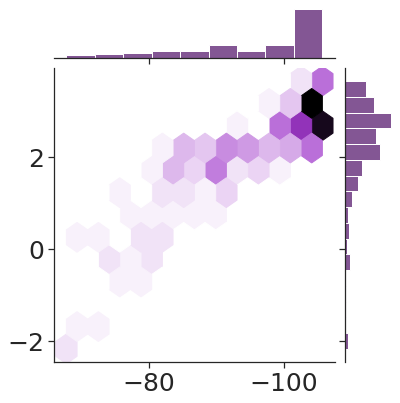

2 3 BO_COMBO


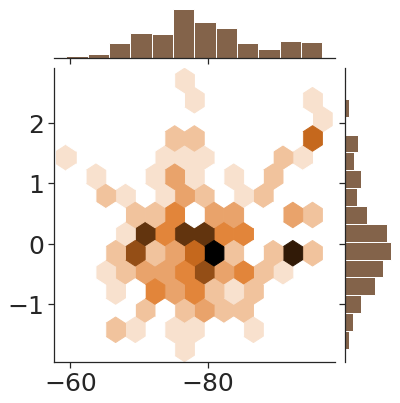

2 4 HEBO


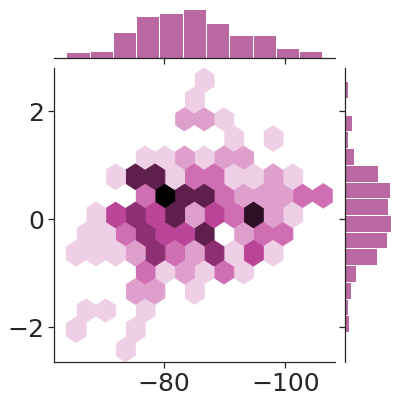

2 5 TURBO


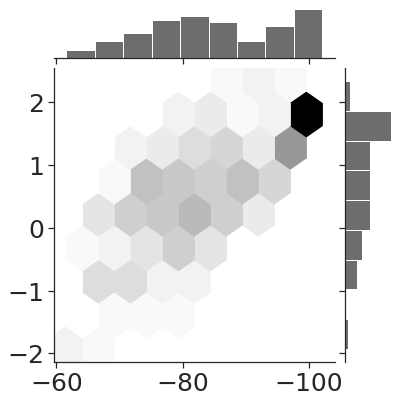

2 6 GA


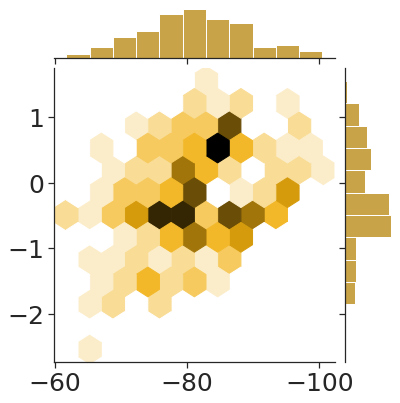


3it [00:09,  3.20s/it]
 58%|█████████████████████████████████████████▍                             | 7/12 [01:19<00:56, 11.27s/it]

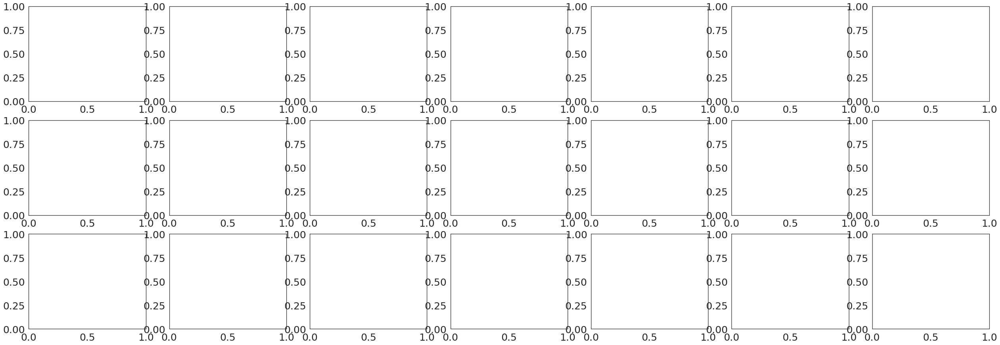


0it [00:00, ?it/s]

0 0 BObert


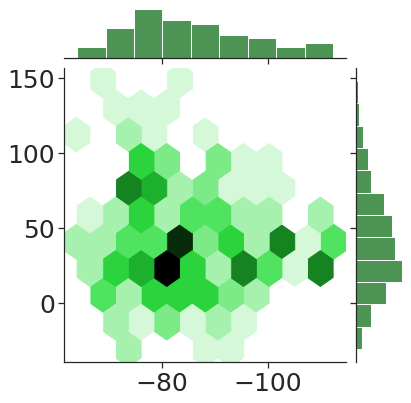

0 1 BO_ssk


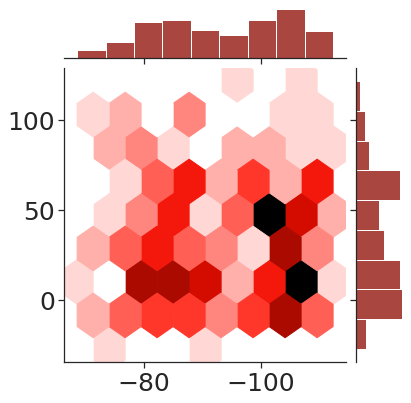

0 2 BO_transformed_overlap


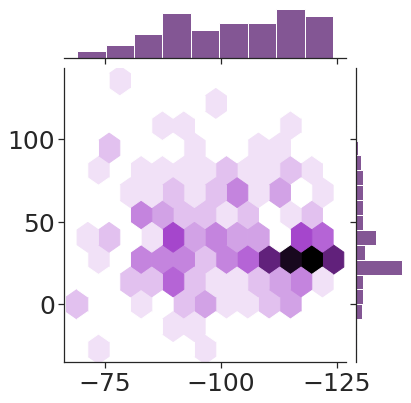

0 3 BO_COMBO


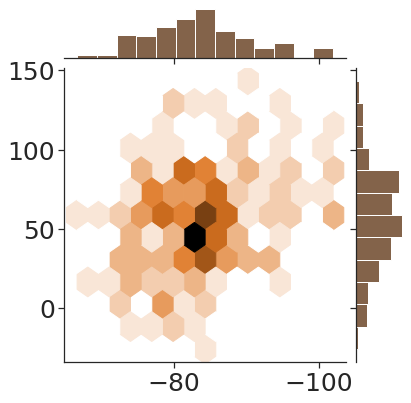

0 4 HEBO


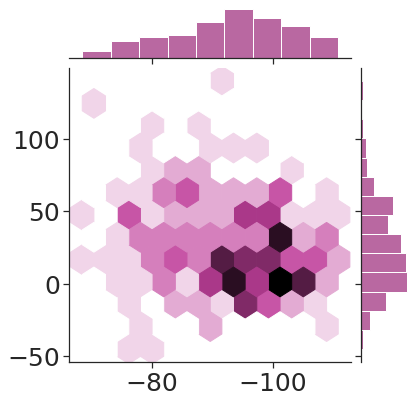

0 5 TURBO


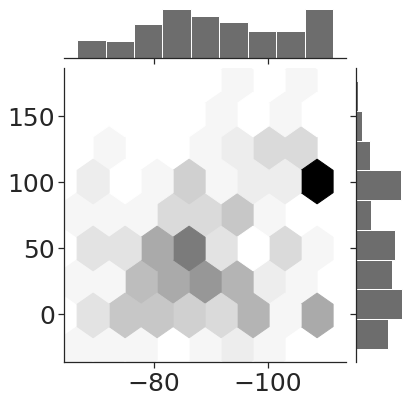

0 6 GA


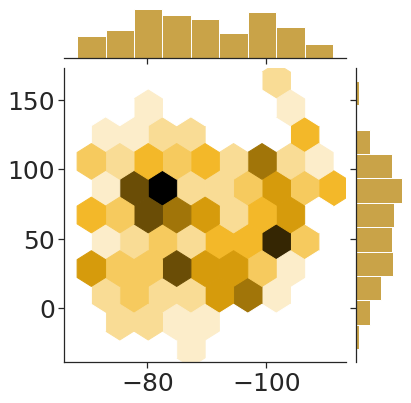


1it [00:02,  2.79s/it]

1 0 BObert


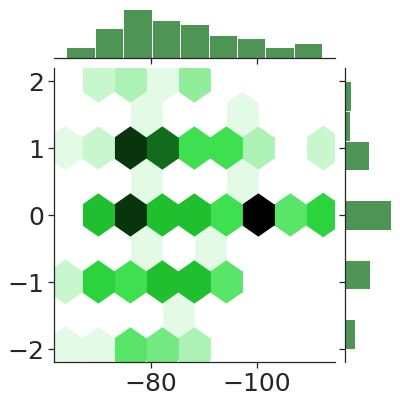

1 1 BO_ssk


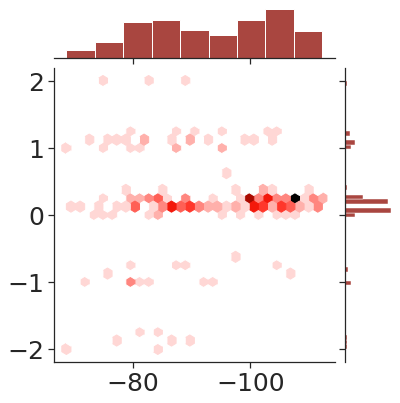

1 2 BO_transformed_overlap


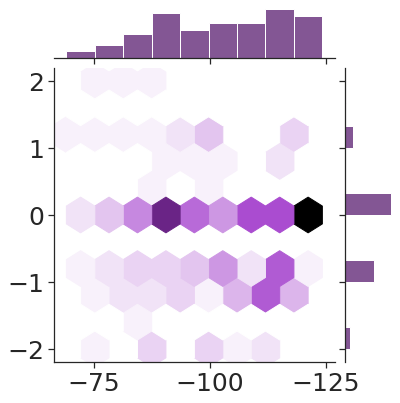

1 3 BO_COMBO


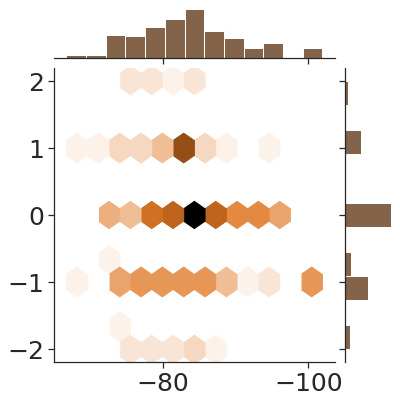

1 4 HEBO


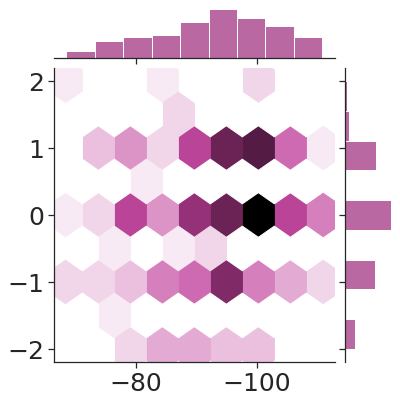

1 5 TURBO


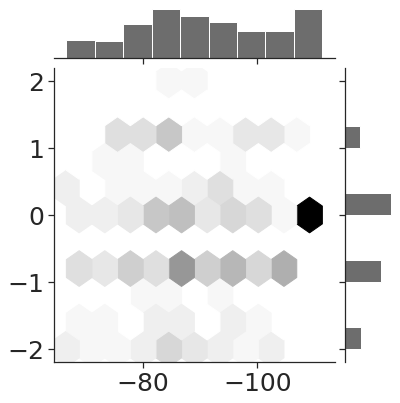

1 6 GA


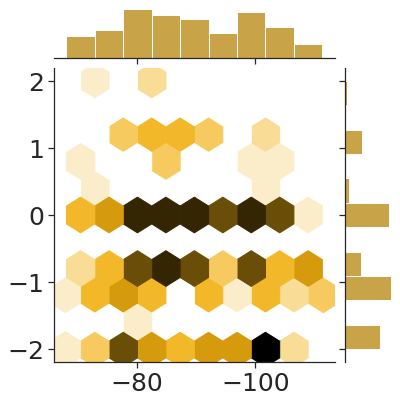


2it [00:06,  3.15s/it]

2 0 BObert


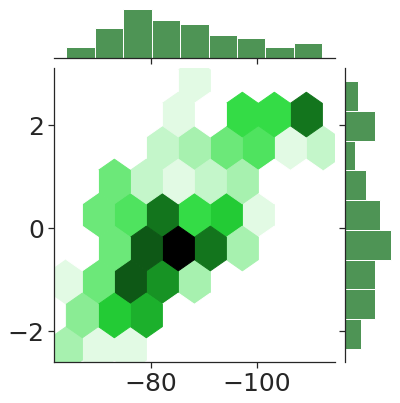

2 1 BO_ssk


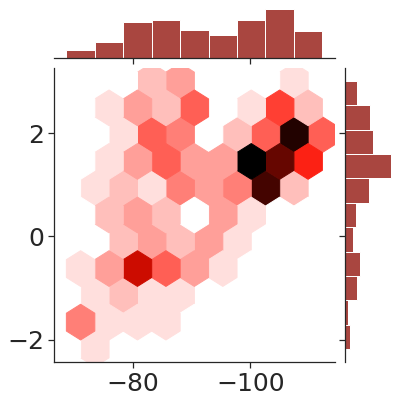

2 2 BO_transformed_overlap


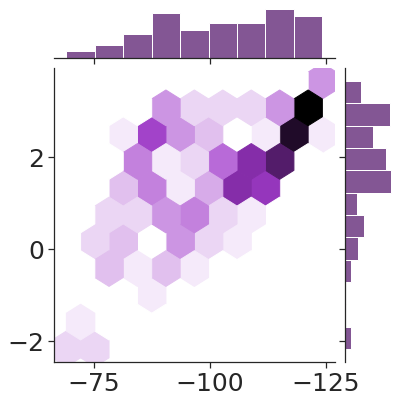

2 3 BO_COMBO


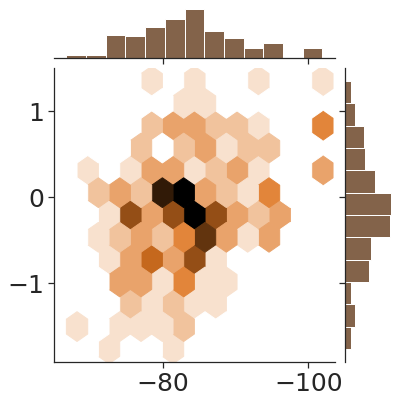

2 4 HEBO


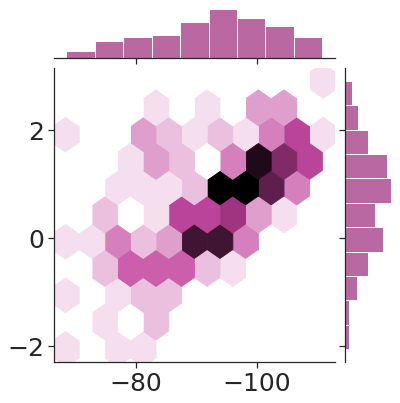

2 5 TURBO


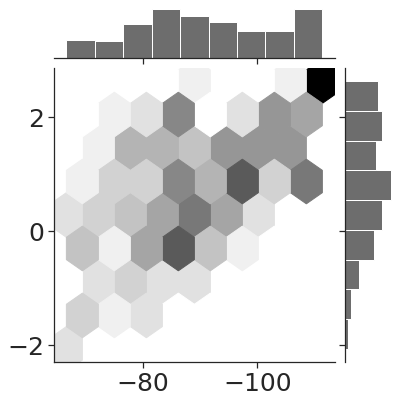

2 6 GA


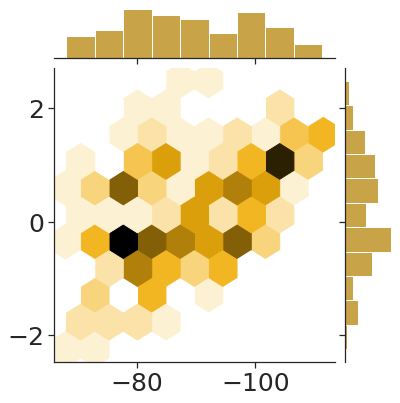


3it [00:08,  2.98s/it]
 67%|███████████████████████████████████████████████▎                       | 8/12 [01:29<00:44, 11.11s/it]

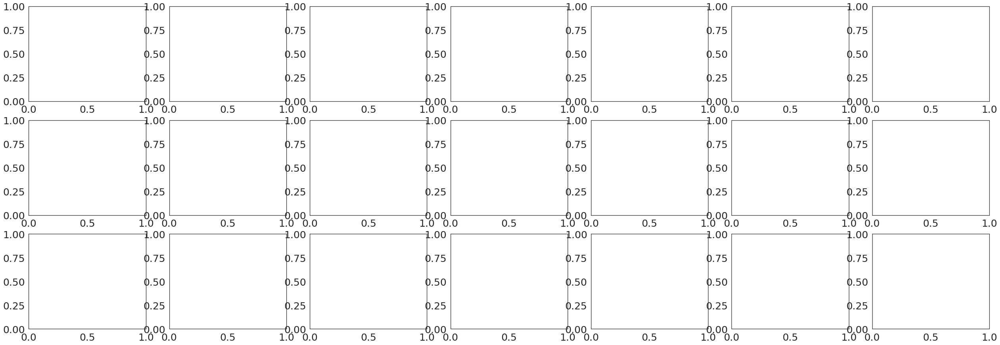


0it [00:00, ?it/s]

0 0 BObert


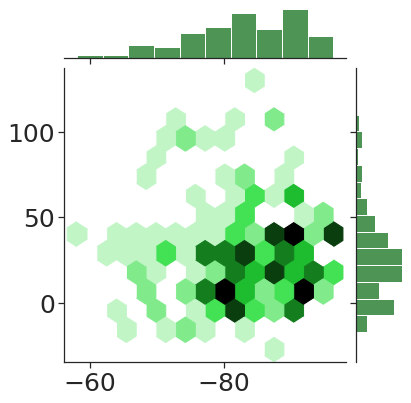

0 1 BO_ssk


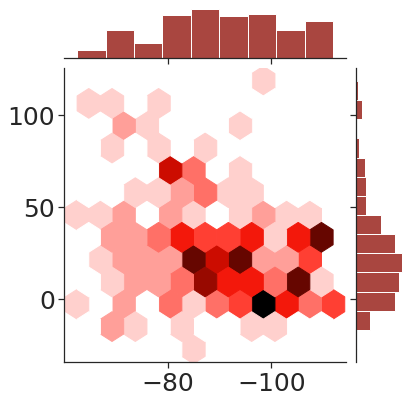

0 2 BO_transformed_overlap


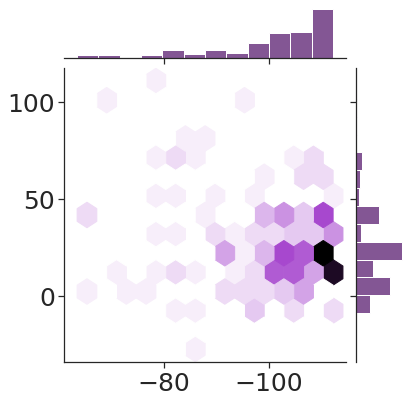

0 3 BO_COMBO


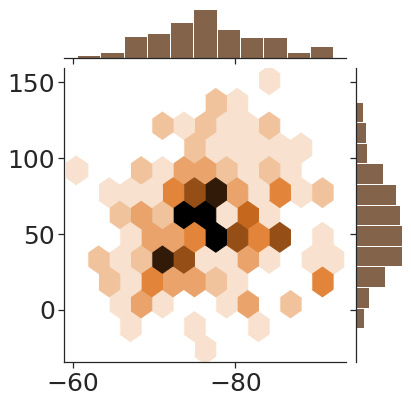

0 4 HEBO


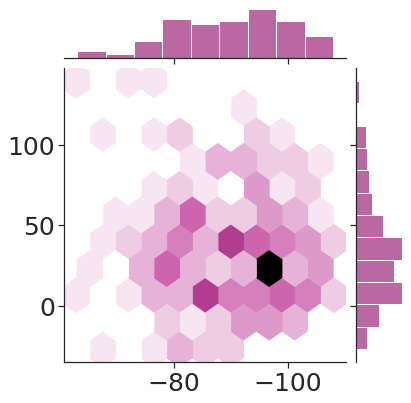

0 5 TURBO


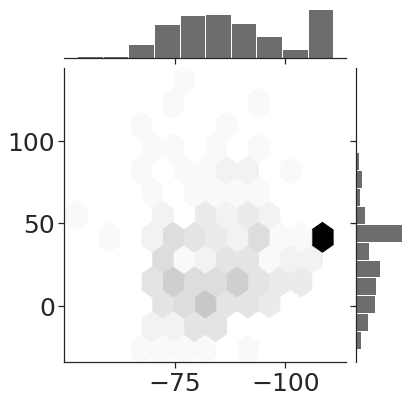

0 6 GA


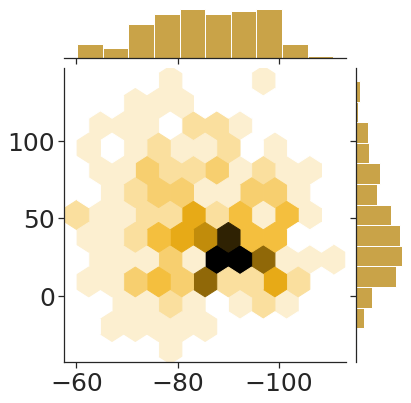


1it [00:03,  3.26s/it]

1 0 BObert


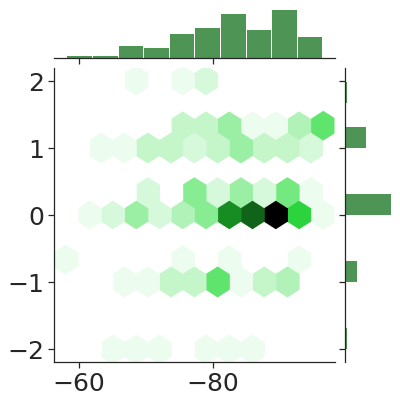

1 1 BO_ssk


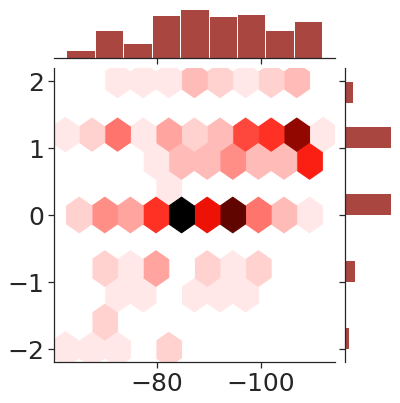

1 2 BO_transformed_overlap


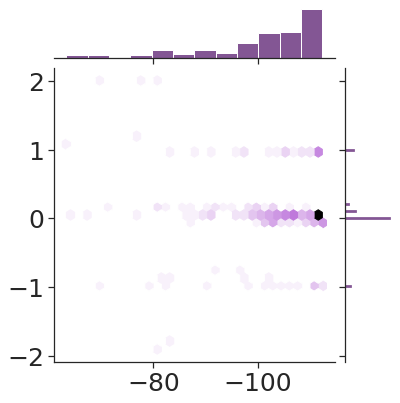

1 3 BO_COMBO


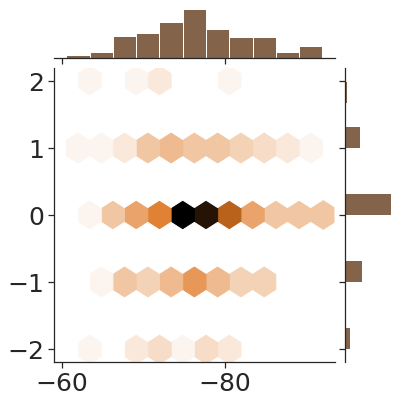

1 4 HEBO


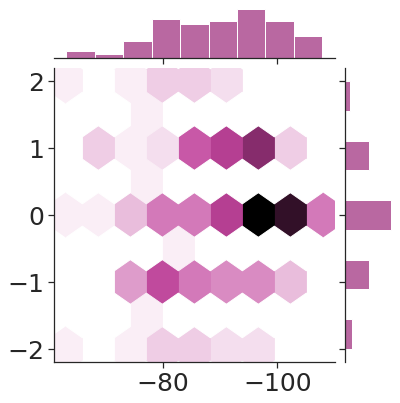

1 5 TURBO


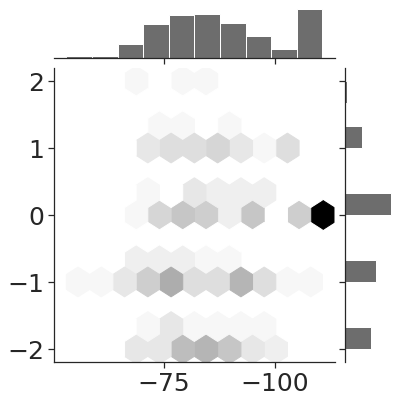

1 6 GA


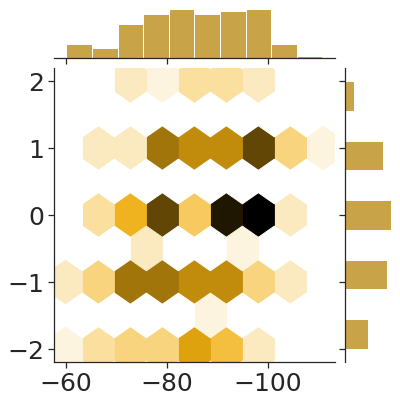


2it [00:06,  3.15s/it]

2 0 BObert


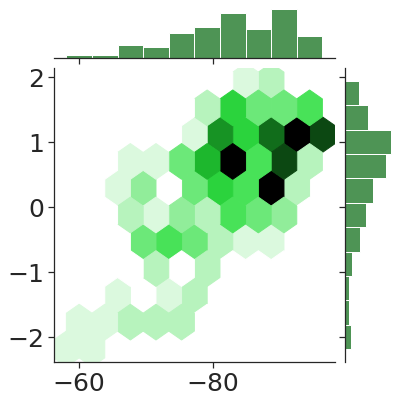

2 1 BO_ssk


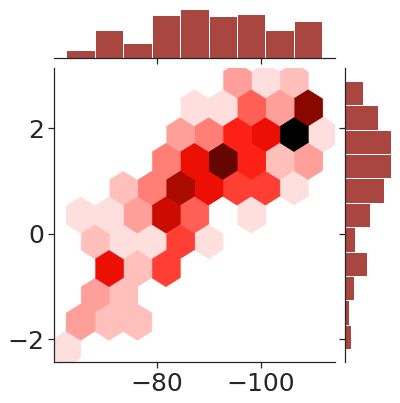

2 2 BO_transformed_overlap


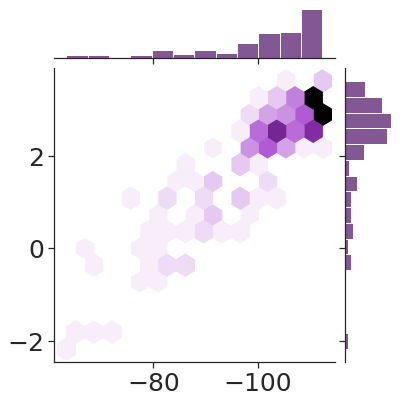

2 3 BO_COMBO


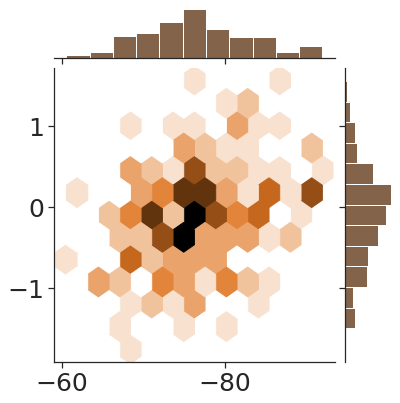

2 4 HEBO


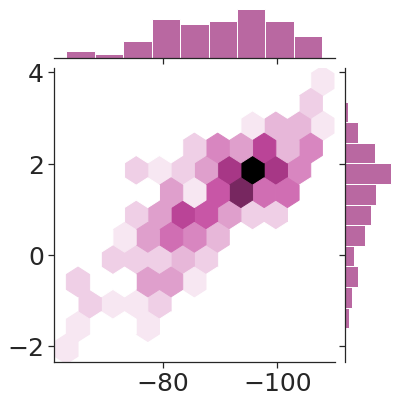

2 5 TURBO


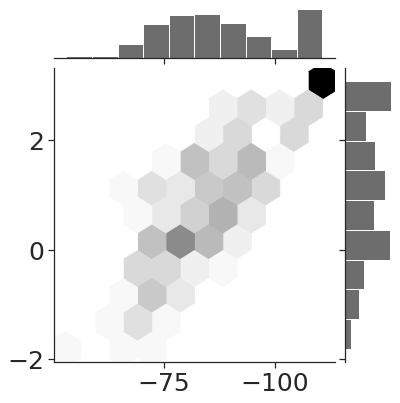

2 6 GA


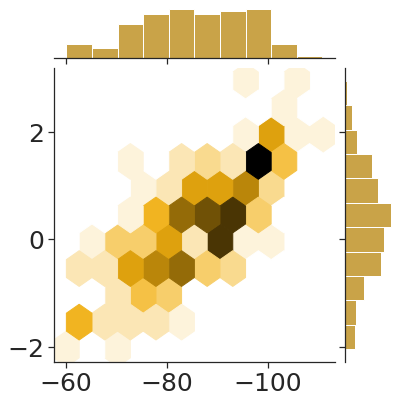


3it [00:09,  3.04s/it]
 75%|█████████████████████████████████████████████████████▎                 | 9/12 [01:40<00:33, 11.06s/it]

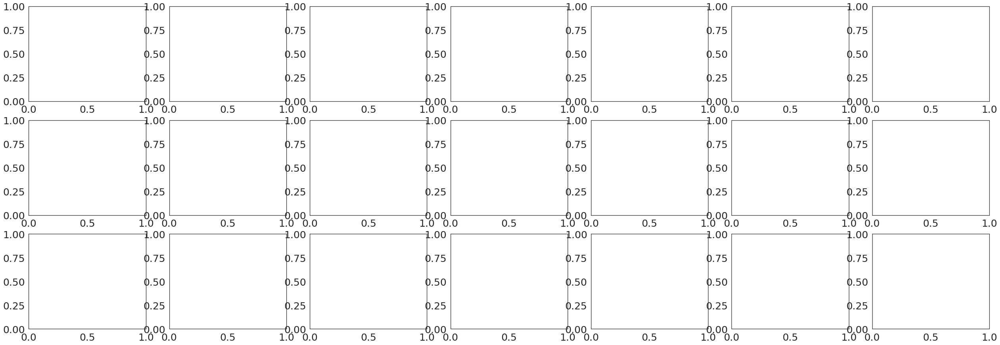


0it [00:00, ?it/s]

0 0 BObert


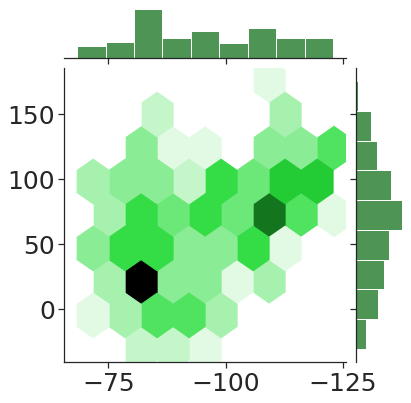

0 1 BO_ssk


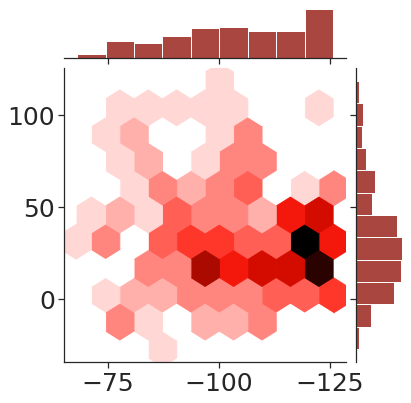

0 2 BO_transformed_overlap


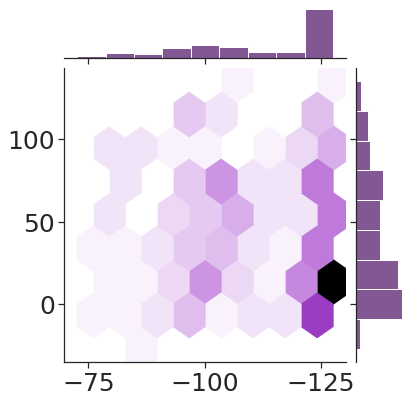

0 3 BO_COMBO


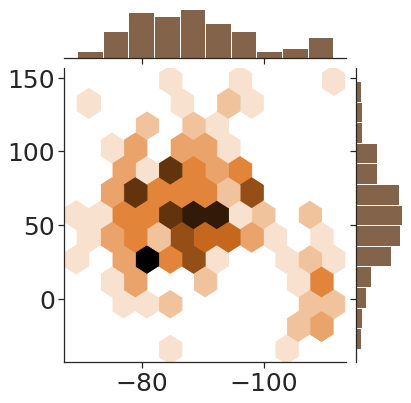

0 4 HEBO


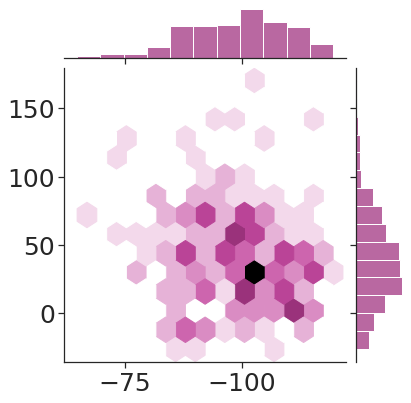

0 5 TURBO


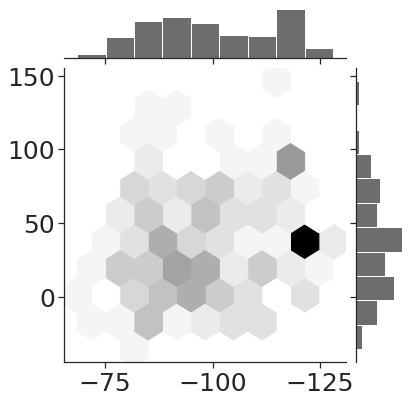

0 6 GA


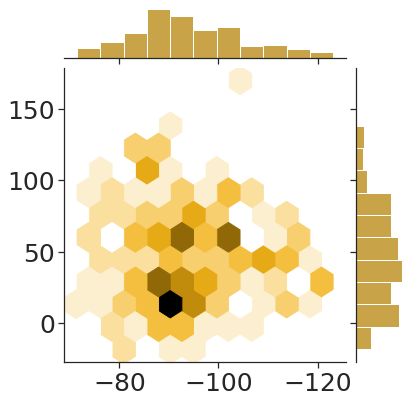


1it [00:02,  2.78s/it]

1 0 BObert


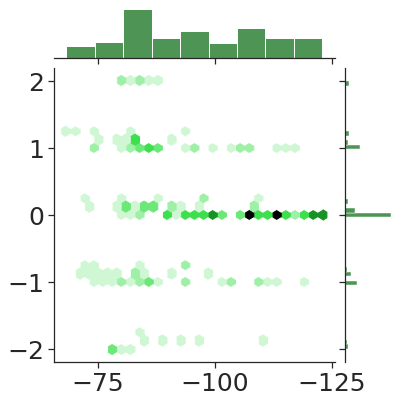

1 1 BO_ssk


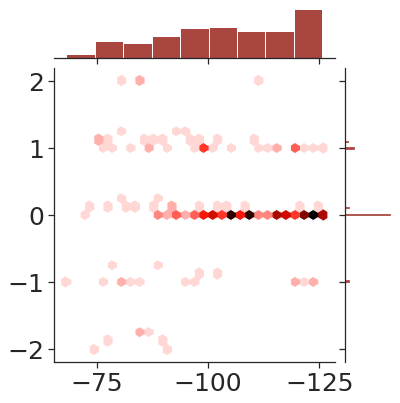

1 2 BO_transformed_overlap


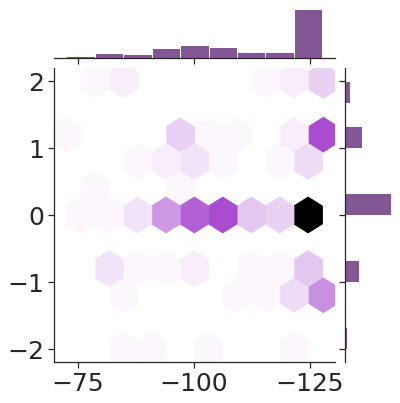

1 3 BO_COMBO


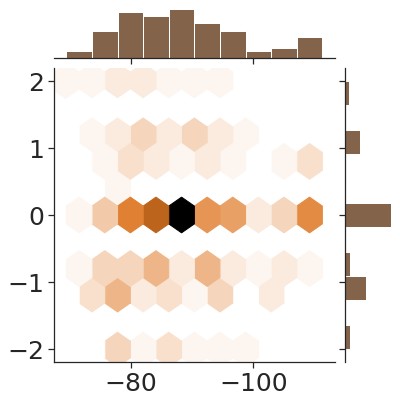

1 4 HEBO


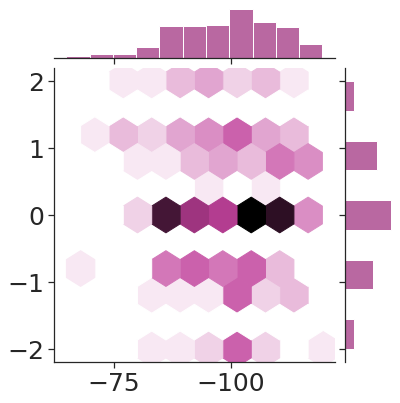

1 5 TURBO


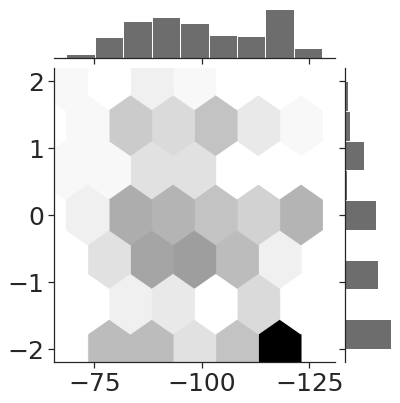

1 6 GA


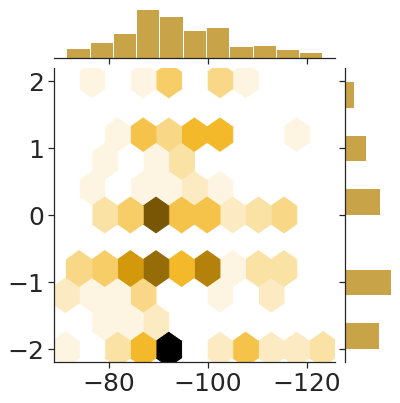


2it [00:05,  3.02s/it]

2 0 BObert


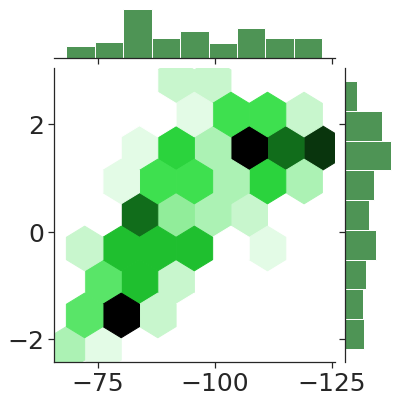

2 1 BO_ssk


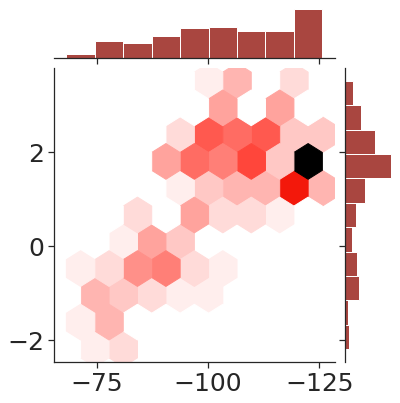

2 2 BO_transformed_overlap


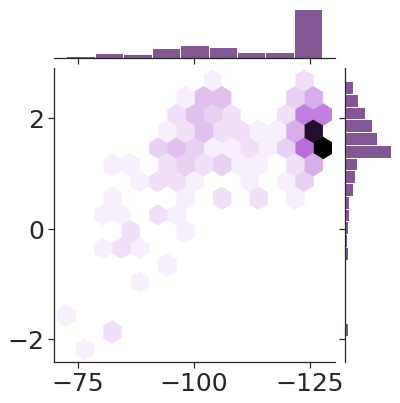

2 3 BO_COMBO


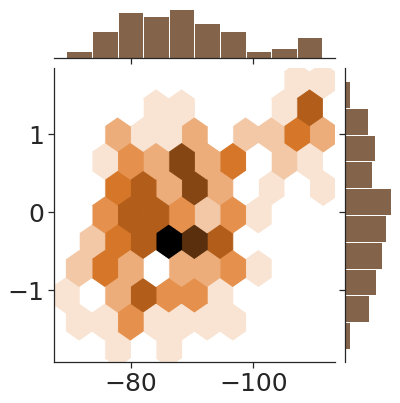

2 4 HEBO


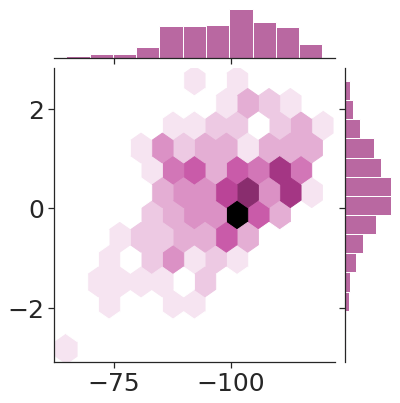

2 5 TURBO


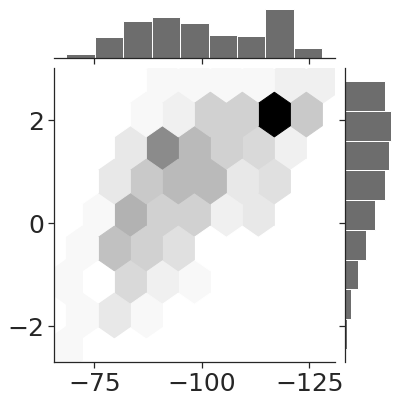

2 6 GA


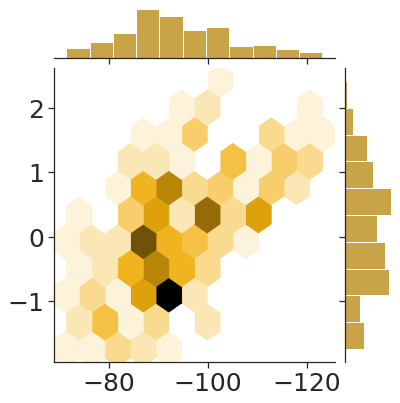


3it [00:09,  3.09s/it]
 83%|██████████████████████████████████████████████████████████▎           | 10/12 [01:52<00:22, 11.20s/it]

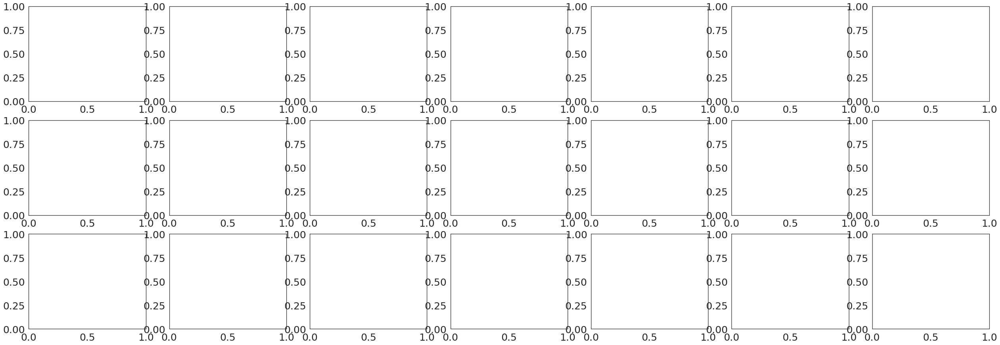


0it [00:00, ?it/s]

0 0 BObert


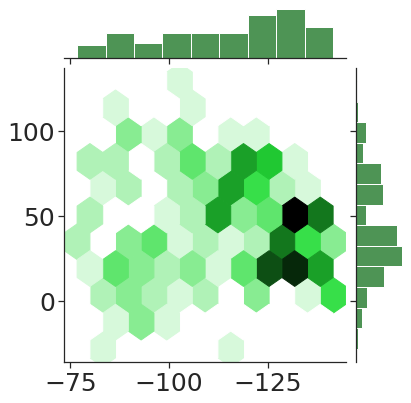

0 1 BO_ssk


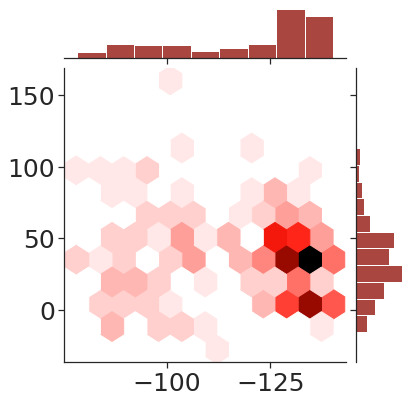

0 2 BO_transformed_overlap


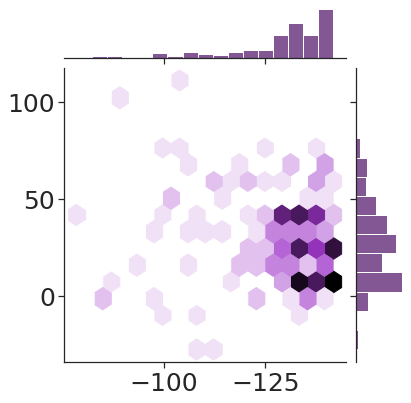

0 3 BO_COMBO


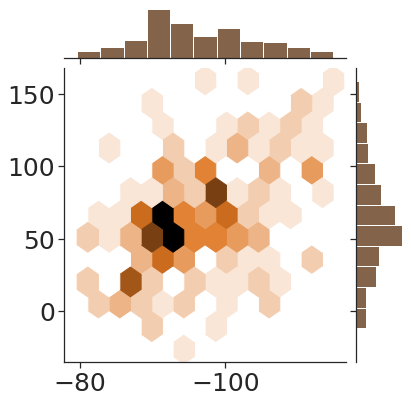

0 4 HEBO


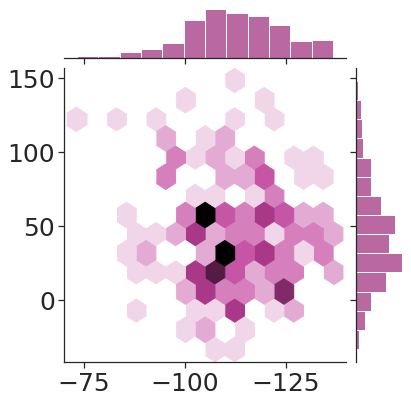

0 5 TURBO


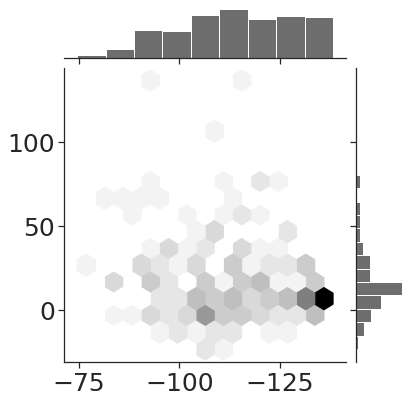

0 6 GA


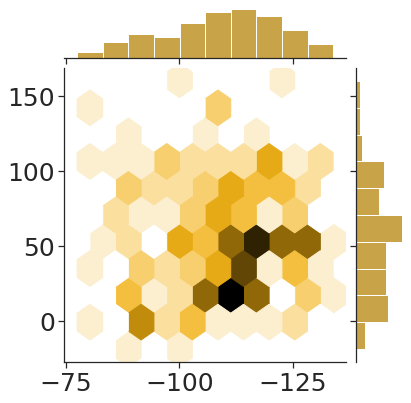


1it [00:02,  2.85s/it]

1 0 BObert


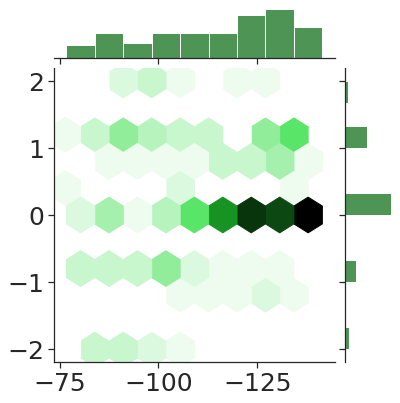

1 1 BO_ssk


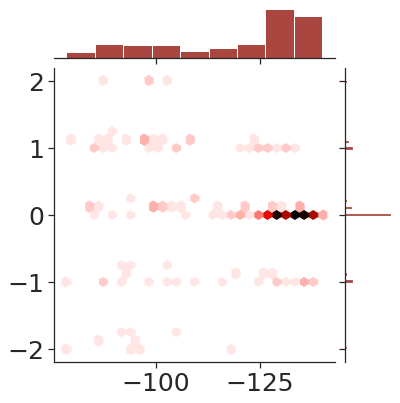

1 2 BO_transformed_overlap


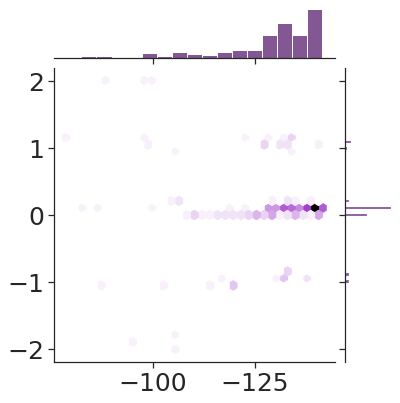

1 3 BO_COMBO


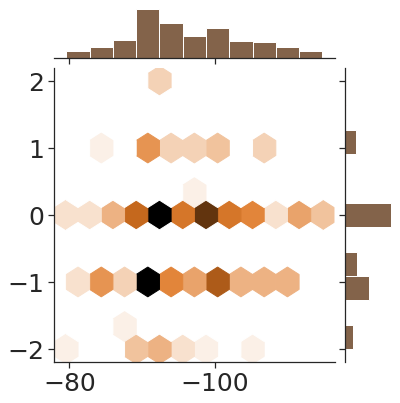

1 4 HEBO


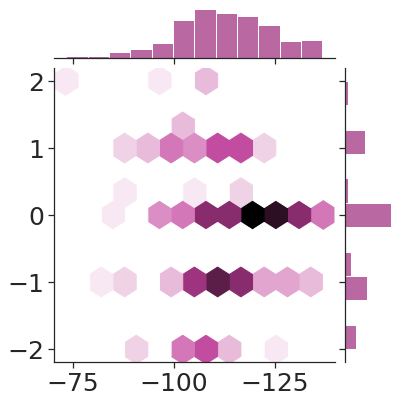

1 5 TURBO


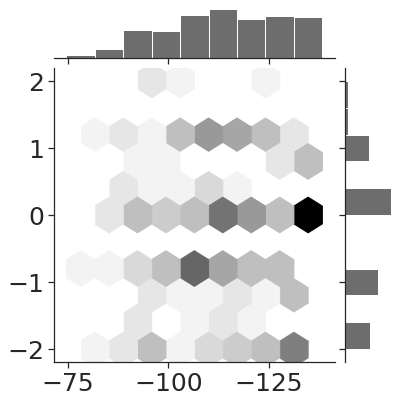

1 6 GA


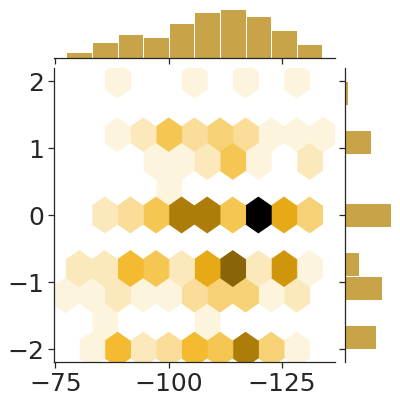


2it [00:06,  3.15s/it]

2 0 BObert


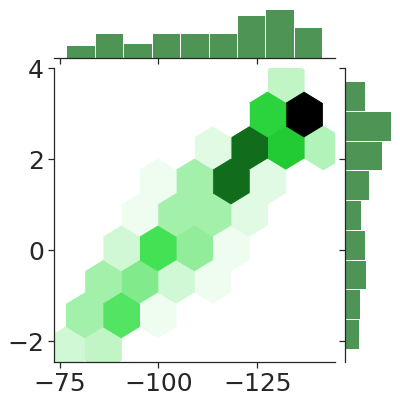

2 1 BO_ssk


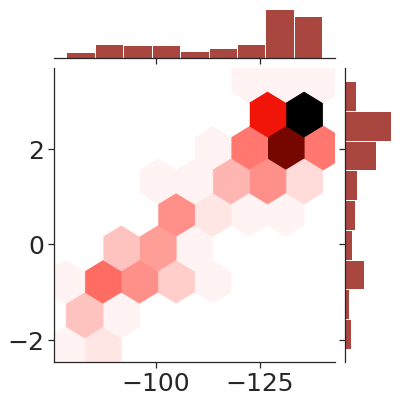

2 2 BO_transformed_overlap


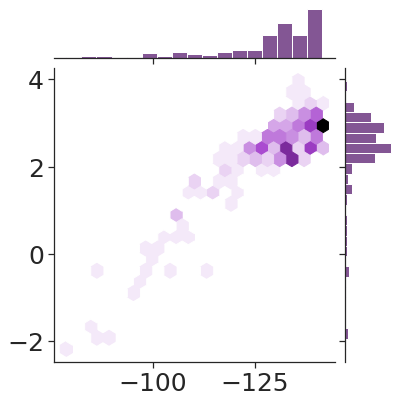

2 3 BO_COMBO


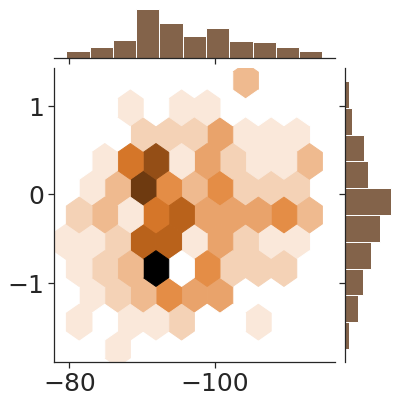

2 4 HEBO


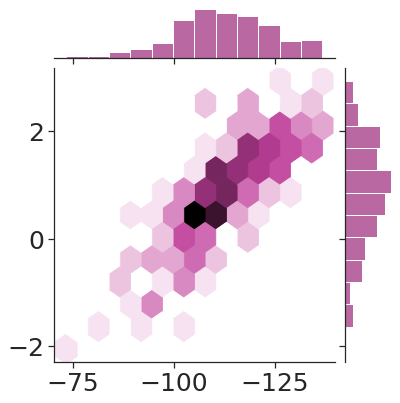

2 5 TURBO


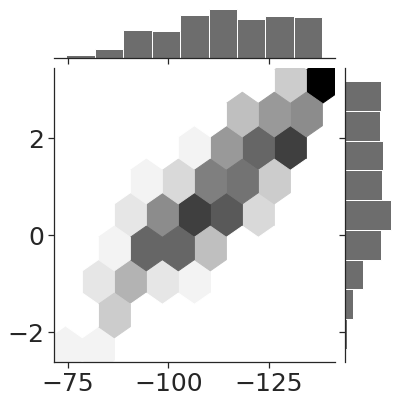

2 6 GA


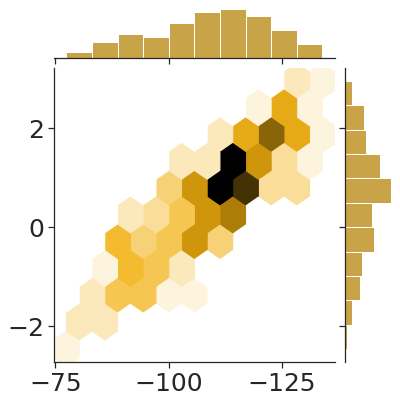


3it [00:09,  3.17s/it]
 92%|████████████████████████████████████████████████████████████████▏     | 11/12 [02:03<00:11, 11.23s/it]

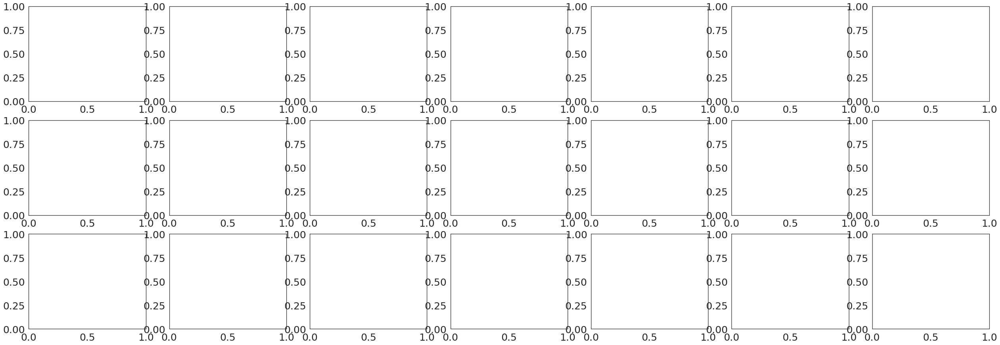


0it [00:00, ?it/s]

0 0 BObert


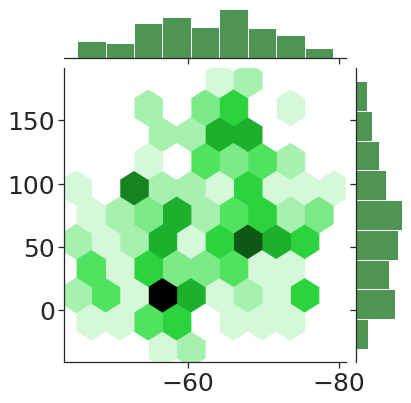

0 1 BO_ssk


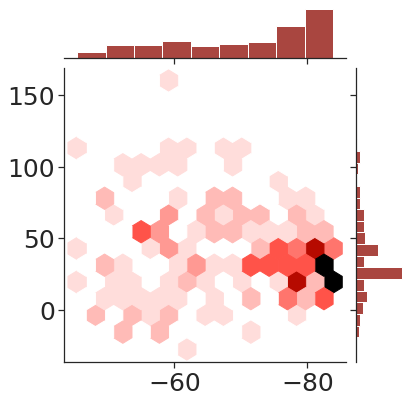

0 2 BO_transformed_overlap


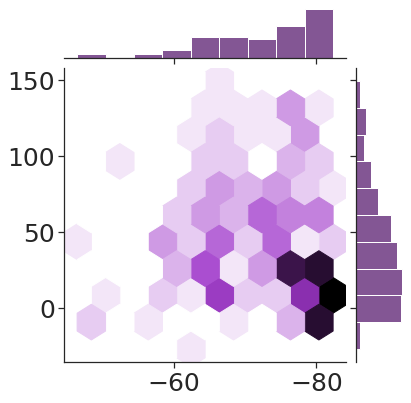

0 3 BO_COMBO


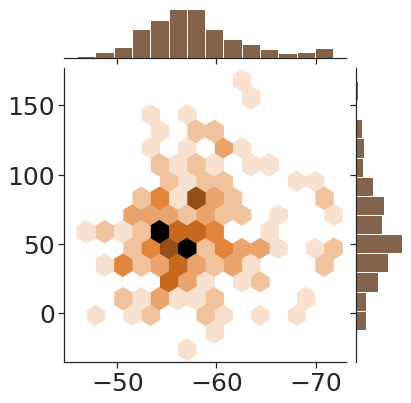

0 4 HEBO


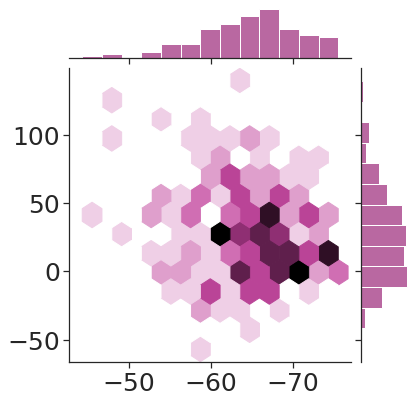

0 5 TURBO


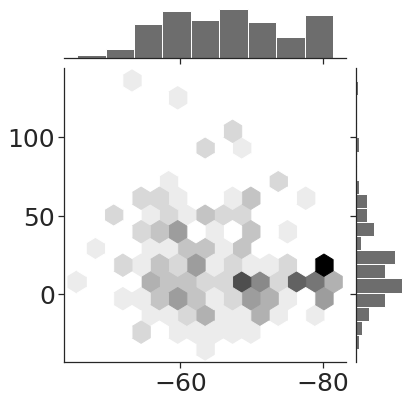

0 6 GA


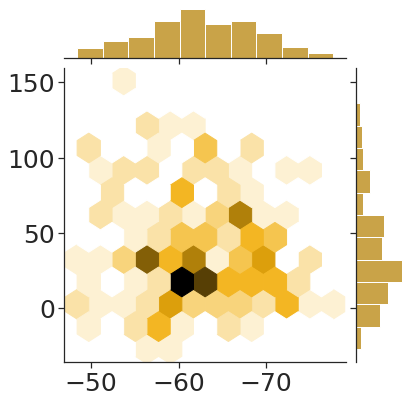


1it [00:02,  2.86s/it]

1 0 BObert


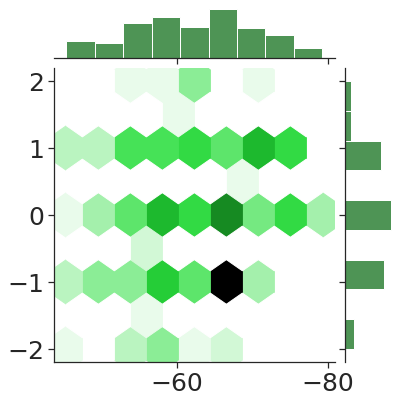

1 1 BO_ssk


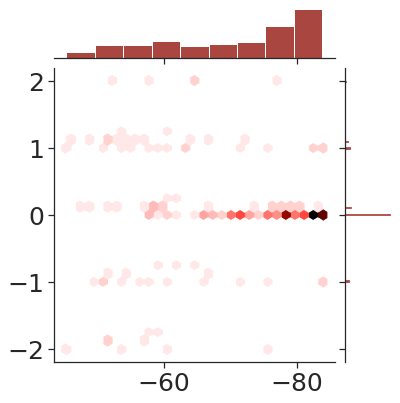

1 2 BO_transformed_overlap


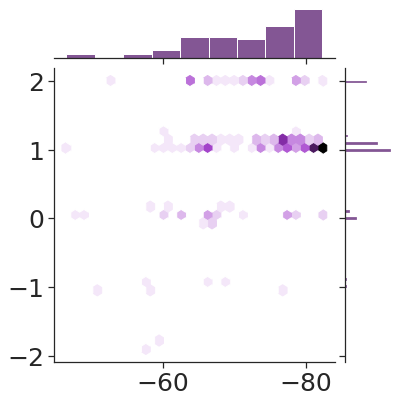

1 3 BO_COMBO


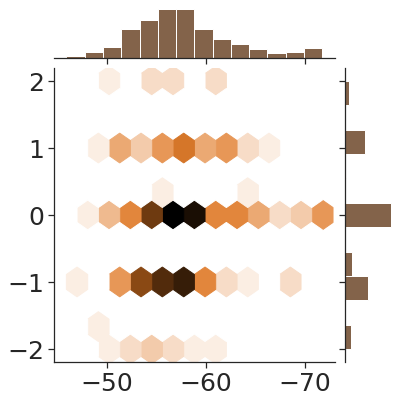

1 4 HEBO


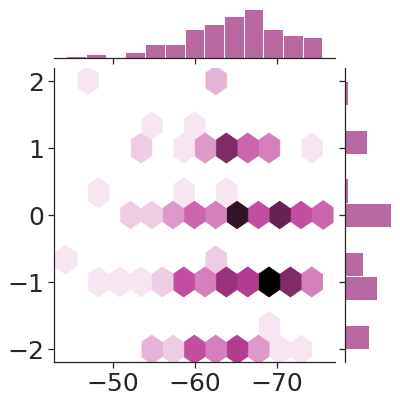

1 5 TURBO


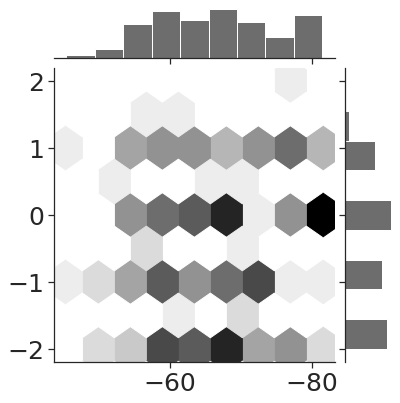

1 6 GA


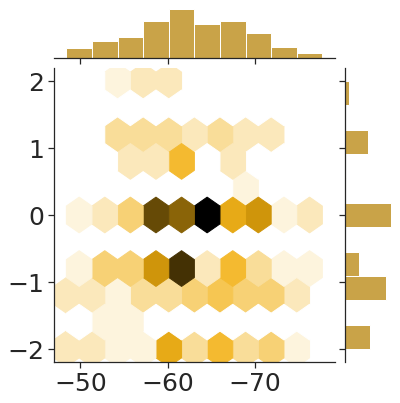


2it [00:06,  3.40s/it]

2 0 BObert


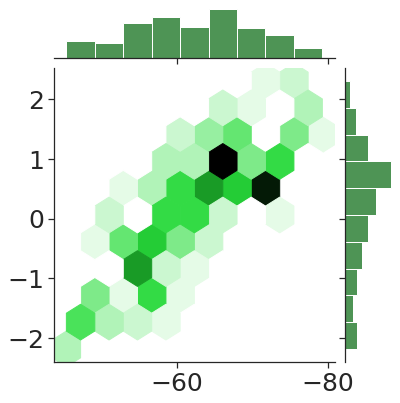

2 1 BO_ssk


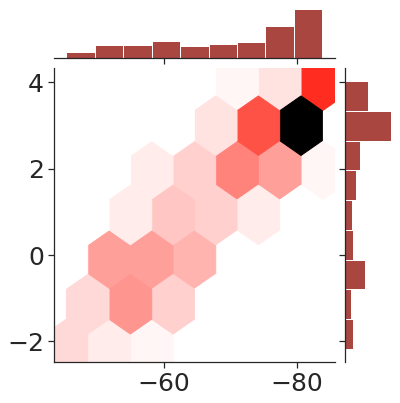

2 2 BO_transformed_overlap


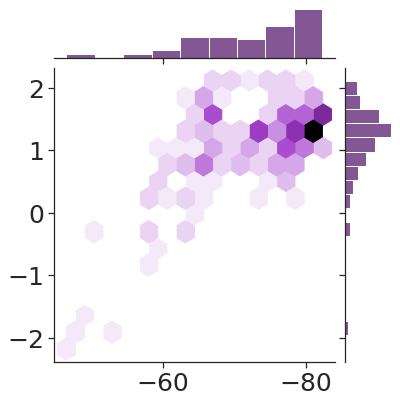

2 3 BO_COMBO


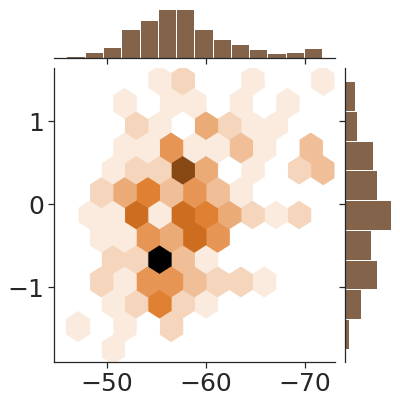

2 4 HEBO


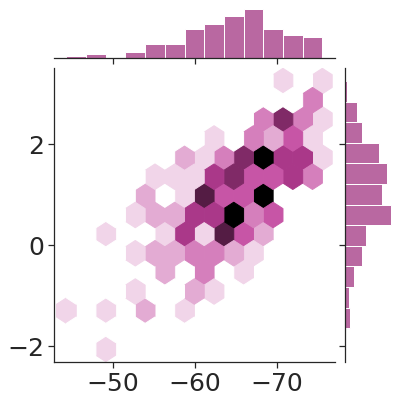

2 5 TURBO


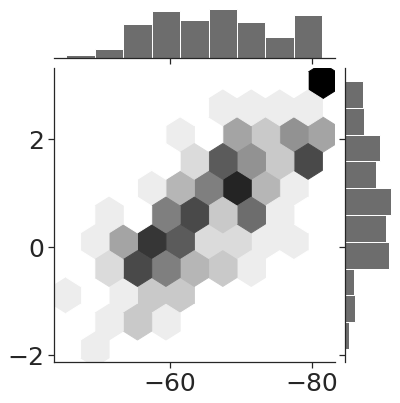

2 6 GA


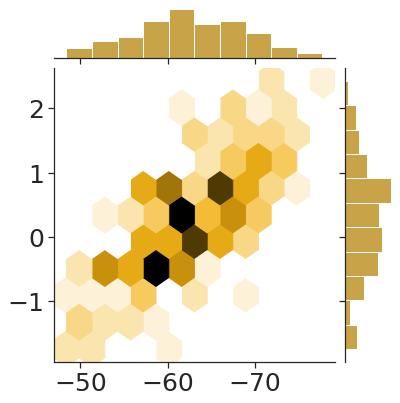


3it [00:09,  3.15s/it]
100%|██████████████████████████████████████████████████████████████████████| 12/12 [02:14<00:00, 11.25s/it]


In [122]:
from tqdm import tqdm
for antigen in tqdm(core_antigens):
    developability_scores = ["Last Instability Index", "Last Charge", "Last Hydropathicity"]
    sarscov2 = results[results['Antigen']==antigen]
    sarscov2 = sarscov2[sarscov2['Seed']==42]
    row, col = 0, 0
    cols = len(order_all)
    rows = 3
    fig, axs = plt.subplots(nrows=rows, ncols=cols, figsize = (6.2*cols, 5*rows))
    axs = axs.reshape(rows, cols)
    plt.show()
    with sns.axes_style("ticks"):
        for row, name in tqdm(enumerate(developability_scores)):
            col = 0
            for method in order_all:
                if method=='Random Search':
                    continue 
                print(row, col, method)
                color = colourDINV[method]
                ax = axs[row, col] 
                filtered = sarscov2[sarscov2['Method']==method]
                g = sns.jointplot(data=filtered, x="Last Binding Energy", y=name, kind="hex", color=color)
                matplotlib.rc('xtick', labelsize=fsize)
                matplotlib.rc('ytick', labelsize=fsize)

    #             g.ax_joint.axes.set_xlabel('Last Binding Energy', fontsize=16)
    #             g.ax_joint.axes.set_ylabel(name, fontsize=16)
                g.ax_joint.axes.set_xlabel('', fontsize=fsize)
                g.ax_joint.axes.set_ylabel('', fontsize=fsize)
    #             g.ax_joint.axes.set_title(f"{method} 2DD8_S", fontsize=16)
                g.ax_joint.axes.invert_xaxis()
                g.savefig(f'hex_{row}_{col}_{antigen}.png')
                plt.show()
                plt.close(g.fig)
                col += 1


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 67.25it/s]


0 0 BObert
0 1 BO_ssk
0 2 BO_transformed_overlap
0 3 BO_COMBO
0 4 HEBO
0 5 TURBO
0 6 GA


  0%|                                                                                | 0/7 [00:00<?, ?it/s]

1 0 BObert
1 1 BO_ssk
1 2 BO_transformed_overlap
1 3 BO_COMBO
1 4 HEBO
1 5 TURBO
1 6 GA


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 75.33it/s]


2 0 BObert
2 1 BO_ssk
2 2 BO_transformed_overlap
2 3 BO_COMBO
2 4 HEBO
2 5 TURBO
2 6 GA


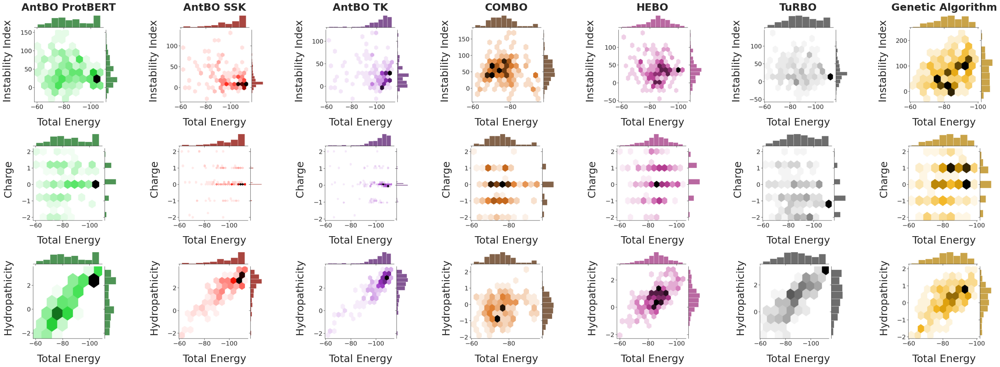

100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 71.84it/s]


0 0 BObert
0 1 BO_ssk
0 2 BO_transformed_overlap
0 3 BO_COMBO
0 4 HEBO
0 5 TURBO
0 6 GA


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 75.94it/s]


1 0 BObert
1 1 BO_ssk
1 2 BO_transformed_overlap
1 3 BO_COMBO
1 4 HEBO
1 5 TURBO
1 6 GA


  0%|                                                                                | 0/7 [00:00<?, ?it/s]

2 0 BObert


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 73.36it/s]


2 1 BO_ssk
2 2 BO_transformed_overlap
2 3 BO_COMBO
2 4 HEBO
2 5 TURBO
2 6 GA


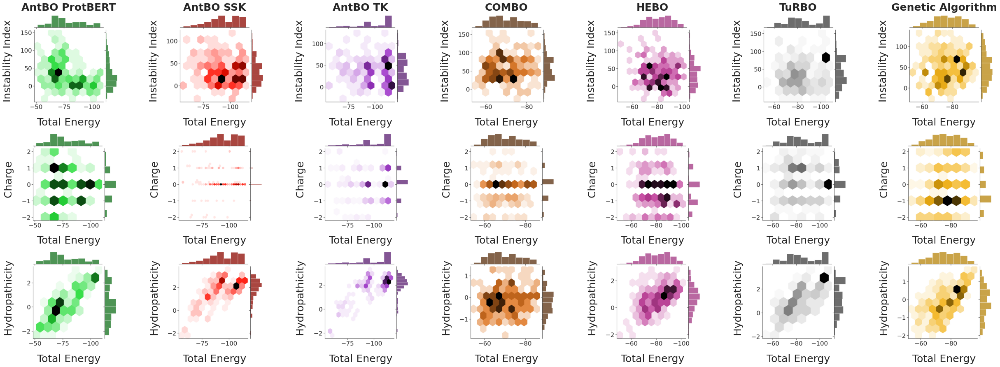

100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 68.97it/s]


0 0 BObert
0 1 BO_ssk
0 2 BO_transformed_overlap
0 3 BO_COMBO
0 4 HEBO
0 5 TURBO
0 6 GA


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 72.19it/s]


1 0 BObert
1 1 BO_ssk
1 2 BO_transformed_overlap
1 3 BO_COMBO
1 4 HEBO
1 5 TURBO
1 6 GA


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 72.28it/s]


2 0 BObert
2 1 BO_ssk
2 2 BO_transformed_overlap
2 3 BO_COMBO
2 4 HEBO
2 5 TURBO
2 6 GA


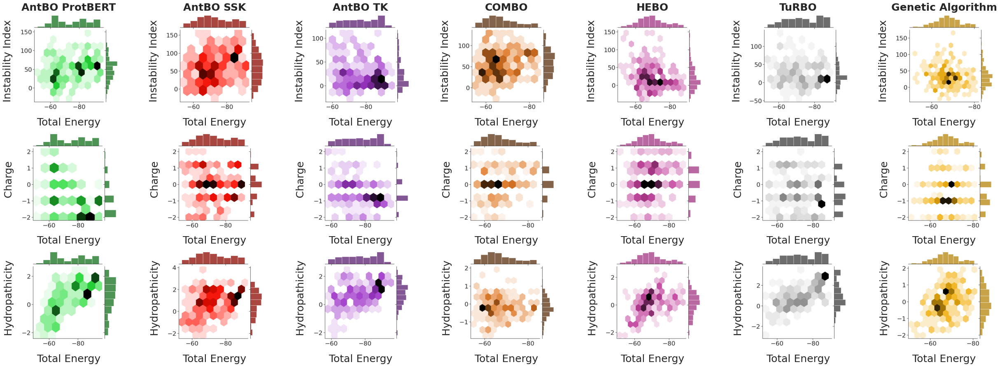

100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 69.41it/s]


0 0 BObert
0 1 BO_ssk
0 2 BO_transformed_overlap
0 3 BO_COMBO
0 4 HEBO
0 5 TURBO
0 6 GA


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 72.29it/s]


1 0 BObert
1 1 BO_ssk
1 2 BO_transformed_overlap
1 3 BO_COMBO
1 4 HEBO
1 5 TURBO
1 6 GA


  0%|                                                                                | 0/7 [00:00<?, ?it/s]

2 0 BObert


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 72.38it/s]


2 1 BO_ssk
2 2 BO_transformed_overlap
2 3 BO_COMBO
2 4 HEBO
2 5 TURBO
2 6 GA


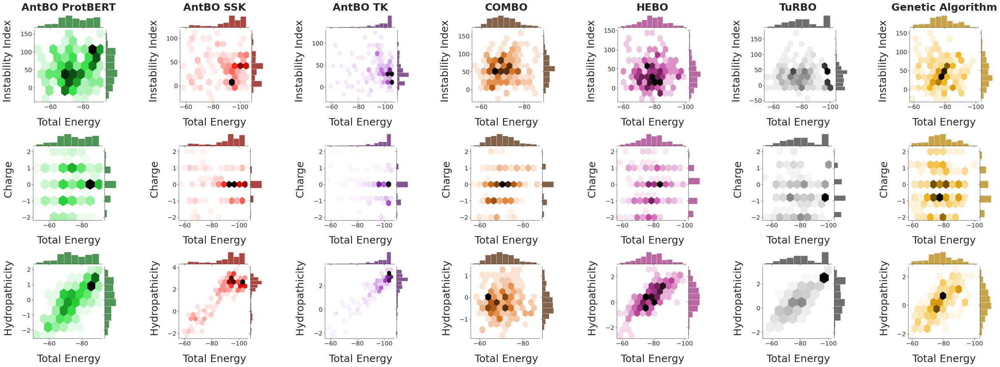

100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 69.29it/s]


0 0 BObert
0 1 BO_ssk
0 2 BO_transformed_overlap
0 3 BO_COMBO
0 4 HEBO
0 5 TURBO
0 6 GA


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 73.13it/s]


1 0 BObert
1 1 BO_ssk
1 2 BO_transformed_overlap
1 3 BO_COMBO
1 4 HEBO
1 5 TURBO
1 6 GA


  0%|                                                                                | 0/7 [00:00<?, ?it/s]

2 0 BObert


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 72.67it/s]


2 1 BO_ssk
2 2 BO_transformed_overlap
2 3 BO_COMBO
2 4 HEBO
2 5 TURBO
2 6 GA


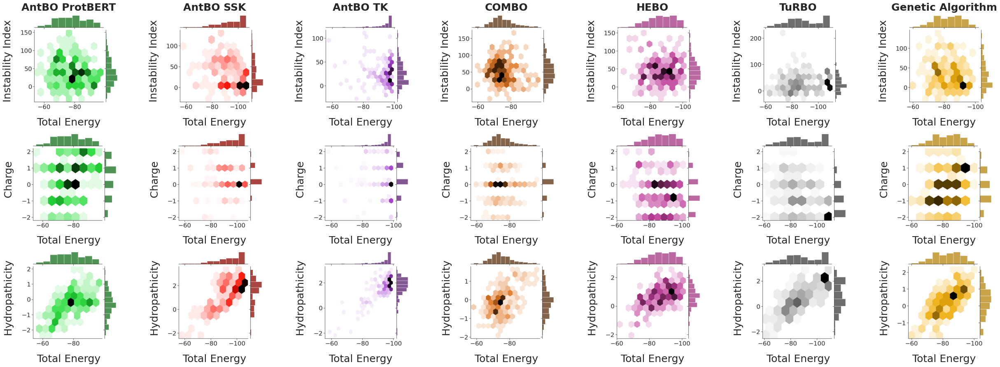

100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 69.28it/s]


0 0 BObert
0 1 BO_ssk
0 2 BO_transformed_overlap
0 3 BO_COMBO
0 4 HEBO
0 5 TURBO
0 6 GA


  0%|                                                                                | 0/7 [00:00<?, ?it/s]

1 0 BObert
1 1 BO_ssk
1 2 BO_transformed_overlap
1 3 BO_COMBO
1 4 HEBO


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 11.67it/s]


1 5 TURBO
1 6 GA


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 79.57it/s]


2 0 BObert
2 1 BO_ssk
2 2 BO_transformed_overlap
2 3 BO_COMBO
2 4 HEBO
2 5 TURBO
2 6 GA


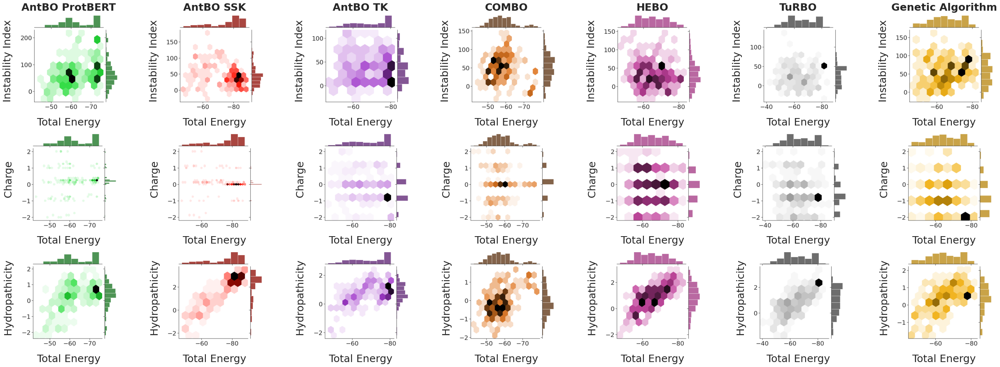

100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 69.40it/s]


0 0 BObert
0 1 BO_ssk
0 2 BO_transformed_overlap
0 3 BO_COMBO
0 4 HEBO
0 5 TURBO
0 6 GA


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 77.44it/s]


1 0 BObert
1 1 BO_ssk
1 2 BO_transformed_overlap
1 3 BO_COMBO
1 4 HEBO
1 5 TURBO
1 6 GA


  0%|                                                                                | 0/7 [00:00<?, ?it/s]

2 0 BObert


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 78.94it/s]


2 1 BO_ssk
2 2 BO_transformed_overlap
2 3 BO_COMBO
2 4 HEBO
2 5 TURBO
2 6 GA


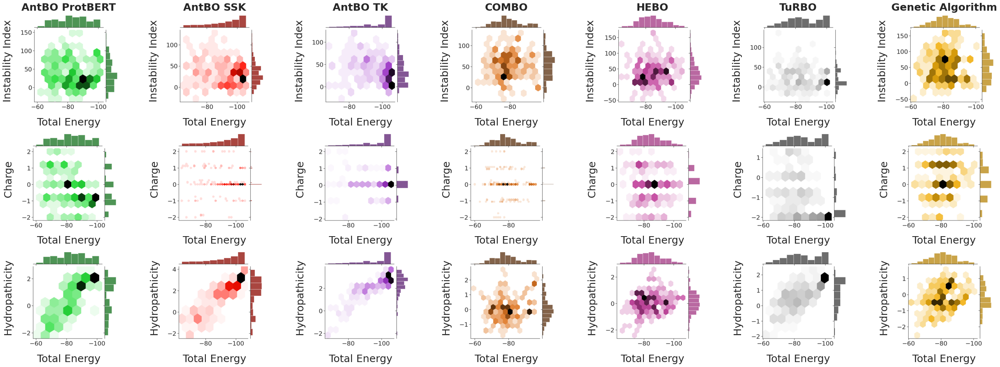

100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 68.92it/s]


0 0 BObert
0 1 BO_ssk
0 2 BO_transformed_overlap
0 3 BO_COMBO
0 4 HEBO
0 5 TURBO
0 6 GA


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 77.10it/s]


1 0 BObert
1 1 BO_ssk
1 2 BO_transformed_overlap
1 3 BO_COMBO
1 4 HEBO
1 5 TURBO
1 6 GA


  0%|                                                                                | 0/7 [00:00<?, ?it/s]

2 0 BObert


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 77.66it/s]


2 1 BO_ssk
2 2 BO_transformed_overlap
2 3 BO_COMBO
2 4 HEBO
2 5 TURBO
2 6 GA


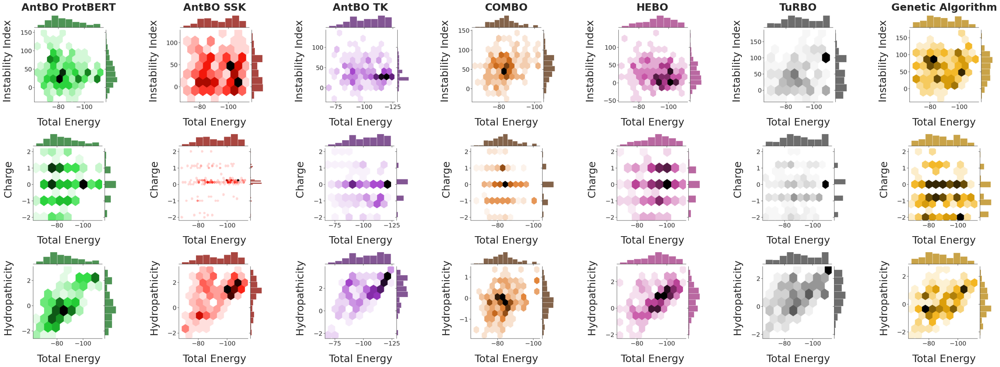

100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.04it/s]


0 0 BObert
0 1 BO_ssk
0 2 BO_transformed_overlap
0 3 BO_COMBO
0 4 HEBO
0 5 TURBO
0 6 GA


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 77.51it/s]


1 0 BObert
1 1 BO_ssk
1 2 BO_transformed_overlap
1 3 BO_COMBO
1 4 HEBO
1 5 TURBO
1 6 GA


  0%|                                                                                | 0/7 [00:00<?, ?it/s]

2 0 BObert


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 77.43it/s]


2 1 BO_ssk
2 2 BO_transformed_overlap
2 3 BO_COMBO
2 4 HEBO
2 5 TURBO
2 6 GA


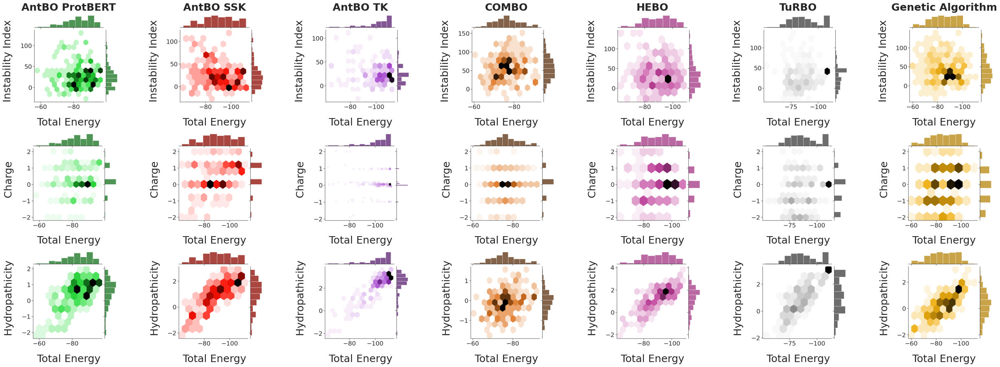

100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.82it/s]


0 0 BObert
0 1 BO_ssk
0 2 BO_transformed_overlap
0 3 BO_COMBO
0 4 HEBO
0 5 TURBO
0 6 GA


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 78.39it/s]


1 0 BObert
1 1 BO_ssk
1 2 BO_transformed_overlap
1 3 BO_COMBO
1 4 HEBO
1 5 TURBO
1 6 GA


  0%|                                                                                | 0/7 [00:00<?, ?it/s]

2 0 BObert


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 77.56it/s]


2 1 BO_ssk
2 2 BO_transformed_overlap
2 3 BO_COMBO
2 4 HEBO
2 5 TURBO
2 6 GA


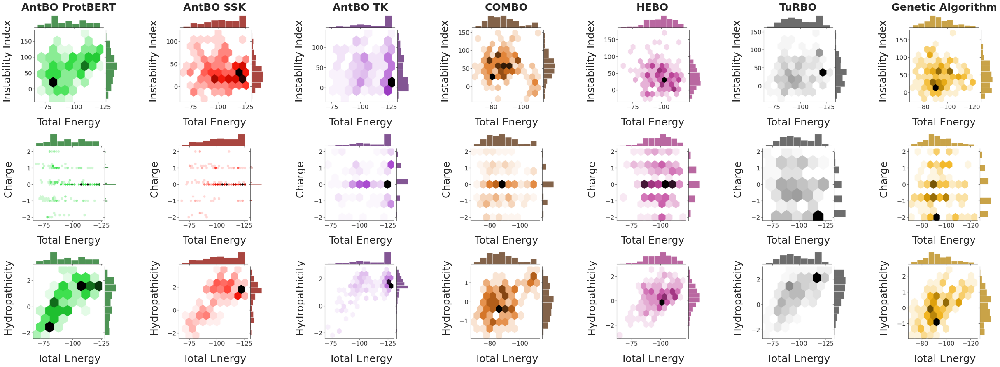

100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.12it/s]


0 0 BObert
0 1 BO_ssk
0 2 BO_transformed_overlap
0 3 BO_COMBO
0 4 HEBO
0 5 TURBO
0 6 GA


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 78.09it/s]


1 0 BObert
1 1 BO_ssk
1 2 BO_transformed_overlap
1 3 BO_COMBO
1 4 HEBO
1 5 TURBO
1 6 GA


  0%|                                                                                | 0/7 [00:00<?, ?it/s]

2 0 BObert


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 77.67it/s]


2 1 BO_ssk
2 2 BO_transformed_overlap
2 3 BO_COMBO
2 4 HEBO
2 5 TURBO
2 6 GA


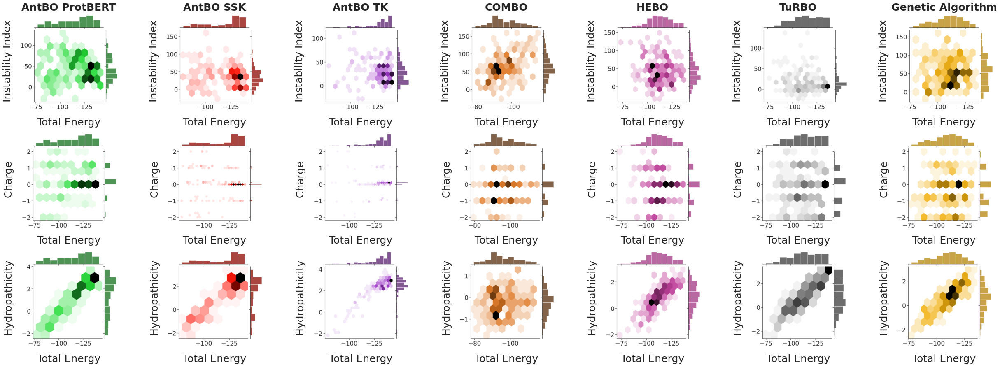

100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 68.99it/s]


0 0 BObert
0 1 BO_ssk
0 2 BO_transformed_overlap
0 3 BO_COMBO
0 4 HEBO
0 5 TURBO
0 6 GA


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 77.57it/s]


1 0 BObert
1 1 BO_ssk
1 2 BO_transformed_overlap
1 3 BO_COMBO
1 4 HEBO
1 5 TURBO
1 6 GA


  0%|                                                                                | 0/7 [00:00<?, ?it/s]

2 0 BObert


100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 77.52it/s]


2 1 BO_ssk
2 2 BO_transformed_overlap
2 3 BO_COMBO
2 4 HEBO
2 5 TURBO
2 6 GA


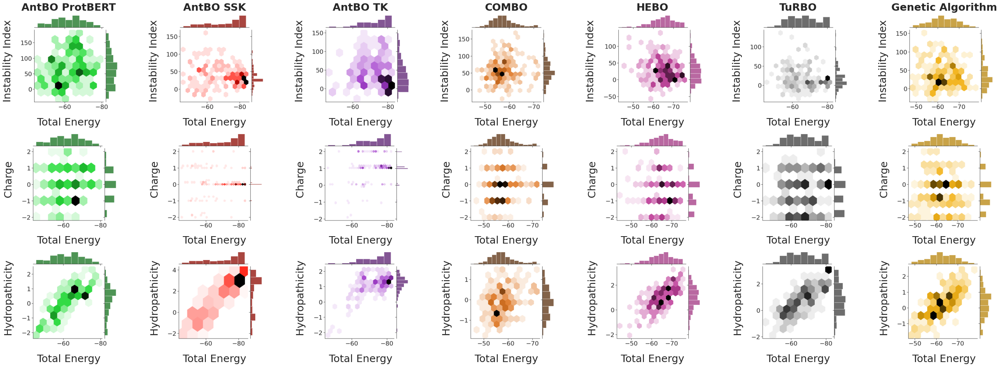

In [123]:
# sarscov2 = results[results['Antigen']=='2DD8_S']
# try:
#     labels_new = replace_labels(labels_new, LabelDictinv)
# except:
#     print(labels_new)
with sns.axes_style("dark"):
    for antigen in core_antigens:
        cols = 7
        rows = 3
        fig, axs = plt.subplots(nrows=rows, ncols=cols, figsize = (6.2*cols, 5*rows))
        axs = axs.reshape(rows, cols)
        row, col = 0, 0
        for row, name in enumerate(developability_scores):
            col = 0
            for method in tqdm(order_all):
                if method=='Random Search':
                    continue 
                print(row, col, method)
                ax = axs[row, col] 
                if row==0:
                    ax.set_title(f"{LabelDict[method]}", fontsize=fsize,fontweight="bold")
                else:
                    ax.set_title(f" ", fontsize=fsize)
    #             if row==2:
                ax.set_xlabel('Total Energy', fontsize=fsize)
    #             else:
    #                 ax.set_xlabel(' ', fontsize=16)
                name = name.replace('Last ',' ')

                ax.set_ylabel(name, fontsize=fsize)
                # 2DD8_S  sars-cov2 Antigen 
    #             filtered = sarscov2[sarscov2['Method']==method]
    #             sns.jointplot(ax=ax, data=filtered, x="Last Binding Energy", y=name, kind="hex", color=handle.get_color())
    #             ax.invert_xaxis()
                ax.imshow(mpimg.imread(f'hex_{row}_{col}_{antigen}.png'))
                ax.axes.xaxis.set_ticklabels([])
                ax.axes.yaxis.set_ticklabels([])
                col += 1


        plt.savefig(os.path.join("/home/rladmin/antigenbinding/plots", f"dev_scores_{antigen}.pdf"))
        plt.show()

In [ ]:
filt = results[results['Num BB Evals']==198]
# filt.groupby(['Antigen', 'Method']).mean(0)
filt.drop(['Seed', 'Num BB Evals'], axis=1)
filt.to_csv('all_data.csv')

In [ ]:
handles_app = [handles_all[i] for i in [0,3,5,7]]

In [ ]:
labels_app = [labels_all[i] for i in [0,3,5,7]]

In [ ]:
LabelDict.keys()

In [194]:
thresholdPd[thresholdPd.AGname==antigen] 

,AGname,type,minEnergy,maxEnergy,nLines,nSeqs


In [236]:
thresholdPd[thresholdPd.type=='Mascotte']

,AGname,type,minEnergy,maxEnergy,nLines,nSeqs
2,1ADQ_A,Mascotte,-98.50,-94.19,71859,43033
7,1FBI_X,Mascotte,-95.16,-89.99,65088,37113
12,1FNS_A,Mascotte,-118.35,-112.48,72739,52623
17,1FSK_A,Mascotte,-88.36,-83.83,67842,49858
22,1H0D_C,Mascotte,-85.99,-82.04,66862,47263
...,...,...,...,...,...,...
687,5MES_A,Mascotte,-112.46,-106.80,81596,47244
692,5T5F_A,Mascotte,-110.17,-105.02,75459,52673
697,5TH9_A,Mascotte,-124.05,-117.76,71795,39422
702,5TLJ_X,Mascotte,-95.49,-91.28,81197,46030


In [54]:
sarscov = results[results.Antigen=='2DD8_S']
sarscov = sarscov[sarscov.Method=='BO_transformed_overlap']
sarscov = sarscov[sarscov.Seed==42]
sarscov.iloc[[0,49,59,149,197]]['Last Protein'].values

array(['HICAGFWHMPI', 'FFCMNILCLRG', 'FFGMNIVCLWL', 'FIEASELYSPL',
       'FINPGILYIPF'], dtype=object)

  0%|                                                                              | 0/179 [00:00<?, ?it/s]

1FNS_A -118.36 -123.33 -131.8


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


1FNS_A -131.8 -118.36


  1%|▍                                                                     | 1/179 [00:18<53:53, 18.17s/it]

1FSK_A -88.37 -92.28 -97.69
1FSK_A -97.69 -88.37


  1%|▊                                                                     | 2/179 [00:35<51:39, 17.51s/it]

1JPS_T -118.02 -121.98 -128.2


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


1JPS_T -128.2 -118.02


  2%|█▏                                                                    | 3/179 [00:54<54:09, 18.46s/it]

1KB5_AB -114.43 -118.37 -128.46
1KB5_AB -128.46 -114.43


  2%|█▌                                                                  | 4/179 [01:51<1:38:15, 33.69s/it]

1MHP_A -108.68 -114.43


  3%|█▉                                                                  | 5/179 [02:18<1:30:13, 31.11s/it]

1NCA_N -120.08 -114.43


  3%|██▎                                                                 | 6/179 [02:37<1:18:07, 27.10s/it]

1NCB_N -119.46 -124.71 -129.55


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


1NCB_N -129.55 -119.46


  4%|██▋                                                                 | 7/179 [02:59<1:13:03, 25.49s/it]

1OAZ_A -108.42 -112.85 -119.75
1OAZ_A -119.75 -108.42


  4%|███                                                                 | 8/179 [03:17<1:05:34, 23.01s/it]

1OSP_O -108.03 -110.93 -116.26
1OSP_O -116.26 -108.03


  5%|███▍                                                                | 9/179 [03:34<1:00:02, 21.19s/it]

1PKQ_J -101.89 -107.31 -112.48
1PKQ_J -112.48 -101.89


  6%|███▊                                                                 | 10/179 [03:46<51:38, 18.33s/it]

1QFW_AB -101.08 -105.39 -113.16
1QFW_AB -113.16 -101.08


  6%|████▏                                                                | 11/179 [03:58<45:55, 16.40s/it]

1RJL_C -91.02 -93.95 -99.96
1RJL_C -99.96 -91.02


  7%|████▋                                                                | 12/179 [04:15<46:02, 16.54s/it]

1TQB_A -111.39 -115.08 -122.52
1TQB_A -122.52 -111.39


  7%|█████                                                                | 13/179 [04:27<42:00, 15.18s/it]

1YJD_C -92.32 -94.99 -101.15
1YJD_C -101.15 -92.32


  8%|█████▍                                                               | 14/179 [04:44<42:59, 15.63s/it]

1ZTX_E -101.68 -105.66 -114.47
1ZTX_E -114.47 -101.68


  8%|█████▊                                                               | 15/179 [05:02<45:12, 16.54s/it]

2ARJ_RQ -112.07 -116.23 -121.64
2ARJ_RQ -121.64 -112.07


  9%|██████▏                                                              | 16/179 [05:22<47:31, 17.49s/it]

2B2X_A -96.24 -101.1 -105.66
2B2X_A -105.66 -96.24


  9%|██████▌                                                              | 17/179 [05:41<48:06, 17.82s/it]

2FD6_AU -120.18 -124.64 -135.58
2FD6_AU -135.58 -120.18


 10%|██████▉                                                              | 18/179 [06:01<49:52, 18.58s/it]

2IH3_C -102.62 -106.05 -113.04


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


2IH3_C -113.04 -102.62


 11%|███████▋                                                             | 20/179 [06:21<38:27, 14.51s/it]

2Q8A_A -106.67 -111.41 -120.65
2Q8A_A -120.65 -106.67


 12%|███████▊                                                           | 21/179 [07:25<1:10:30, 26.77s/it]/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


2R0K_A -115.12 -106.67


 12%|████████▏                                                          | 22/179 [07:45<1:05:56, 25.20s/it]

2R29_A -95.83 -99.92 -108.24


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


2R29_A -108.24 -95.83


 13%|████████▌                                                          | 23/179 [08:03<1:00:25, 23.24s/it]

2R4R_A -114.76 -118.62 -125.64
2R4R_A -125.64 -114.76


 13%|████████▉                                                          | 24/179 [08:44<1:12:16, 27.98s/it]

2R56_A -96.57 -100.3 -105.81


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


2R56_A -105.81 -96.57


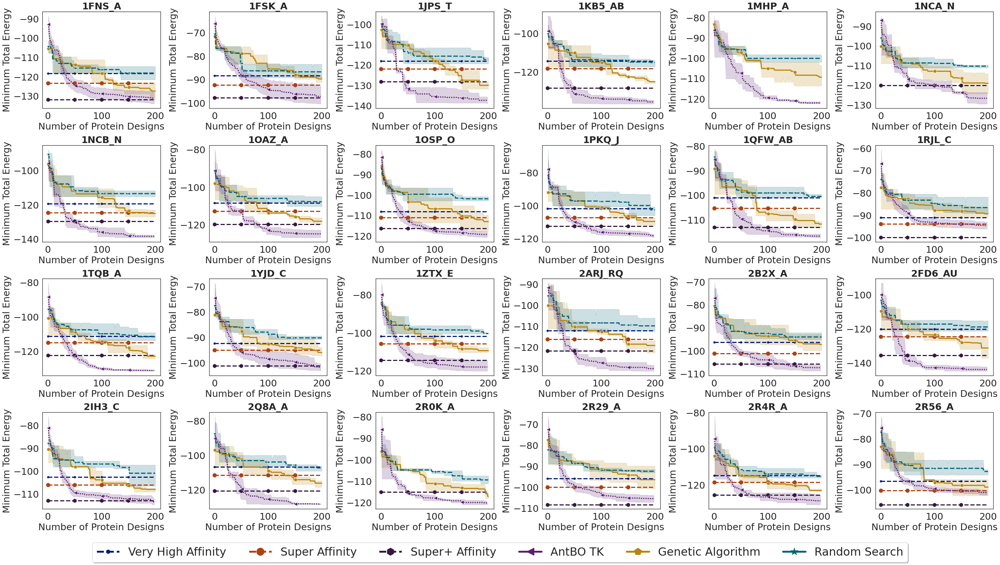

 14%|█████████▎                                                         | 25/179 [09:06<1:07:44, 26.40s/it]

2UZI_R -106.77 -110.94 -116.21
2UZI_R -116.21 -106.77


 15%|█████████▋                                                         | 26/179 [09:23<1:00:20, 23.66s/it]

2VXQ_A -91.32 -94.33 -100.34
2VXQ_A -100.34 -91.32


 15%|██████████▍                                                          | 27/179 [09:41<55:41, 21.98s/it]

2VXT_I -99.73 -103.09 -111.56
2VXT_I -111.56 -99.73


 16%|██████████▍                                                        | 28/179 [10:21<1:08:37, 27.27s/it]

2W9E_A -99.05 -102.73 -110.52


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


2W9E_A -110.52 -99.05


 16%|██████████▊                                                        | 29/179 [10:45<1:05:41, 26.28s/it]

2WUC_I -100.59 -104.43 -111.22


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


2WUC_I -111.22 -100.59


 17%|███████████▏                                                       | 30/179 [11:06<1:01:45, 24.87s/it]

2XQB_A -93.61 -96.79 -105.05


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


2XQB_A -105.05 -93.61


 17%|███████████▌                                                       | 31/179 [11:30<1:00:47, 24.64s/it]

2XWT_C -119.2 -122.99 -129.96


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


2XWT_C -129.96 -119.2


 18%|████████████▎                                                        | 32/179 [11:54<59:51, 24.43s/it]

2YC1_C -96.01 -99.61 -106.81


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


2YC1_C -106.81 -96.01


 18%|████████████▋                                                        | 33/179 [12:16<57:15, 23.53s/it]

2ZCH_P -102.04 -105.6 -110.98
2ZCH_P -110.98 -102.04


 19%|████████████▋                                                      | 34/179 [13:25<1:29:38, 37.10s/it]/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


3B9K_A -116.76 -102.04


 20%|█████████████                                                      | 35/179 [13:52<1:22:21, 34.32s/it]

3BGF_S -106.12 -109.45 -117.46


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


3BGF_S -117.46 -106.12


 20%|█████████████▍                                                     | 36/179 [14:16<1:14:20, 31.19s/it]

3BN9_A -108.54 -111.75 -118.01
3BN9_A -118.01 -108.54


 21%|█████████████▊                                                     | 37/179 [14:38<1:06:49, 28.24s/it]

3CVH_ABC -105.47 -109.15 -118.91
3CVH_ABC -118.91 -105.47


 21%|██████████████▏                                                    | 38/179 [15:01<1:03:16, 26.92s/it]

3DVG_XY -111.17 -115.64 -121.38
3DVG_XY -121.38 -111.17


 22%|██████████████▌                                                    | 39/179 [15:25<1:00:10, 25.79s/it]

3G04_C inf -111.17


 23%|███████████████▊                                                     | 41/179 [15:47<43:54, 19.09s/it]

3GI9_C -132.38 -138.09 -148.78


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


3GI9_C -148.78 -132.38


 23%|████████████████▏                                                    | 42/179 [16:10<45:28, 19.92s/it]

3HI6_A -112.11 -116.2 -125.91
3HI6_A -125.91 -112.11


 24%|████████████████▌                                                    | 43/179 [16:32<46:35, 20.55s/it]

3JBQ_B -113.45 -117.02 -124.83
3JBQ_B -124.83 -113.45


 25%|████████████████▉                                                    | 44/179 [16:55<47:33, 21.14s/it]

3KJ4_A -108.4 -112.55 -119.48
3KJ4_A -119.48 -108.4


 25%|█████████████████▎                                                   | 45/179 [17:17<47:42, 21.36s/it]

3KR3_D -78.41 -81.42 -86.65
3KR3_D -86.65 -78.41


 26%|█████████████████▏                                                 | 46/179 [18:01<1:02:14, 28.08s/it]

3KS0_J -101.7 -106.58 -112.0
3KS0_J -112.0 -101.7


 26%|█████████████████▌                                                 | 47/179 [18:32<1:03:33, 28.89s/it]/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


3L5W_I -100.54 -101.7


 27%|█████████████████▉                                                 | 48/179 [18:58<1:01:16, 28.06s/it]

3L5X_A -89.44 -93.19 -97.5
3L5X_A -97.5 -89.44


 27%|██████████████████▉                                                  | 49/179 [19:22<57:56, 26.74s/it]

3L95_X -109.36 -113.92 -122.97
3L95_X -122.97 -109.36


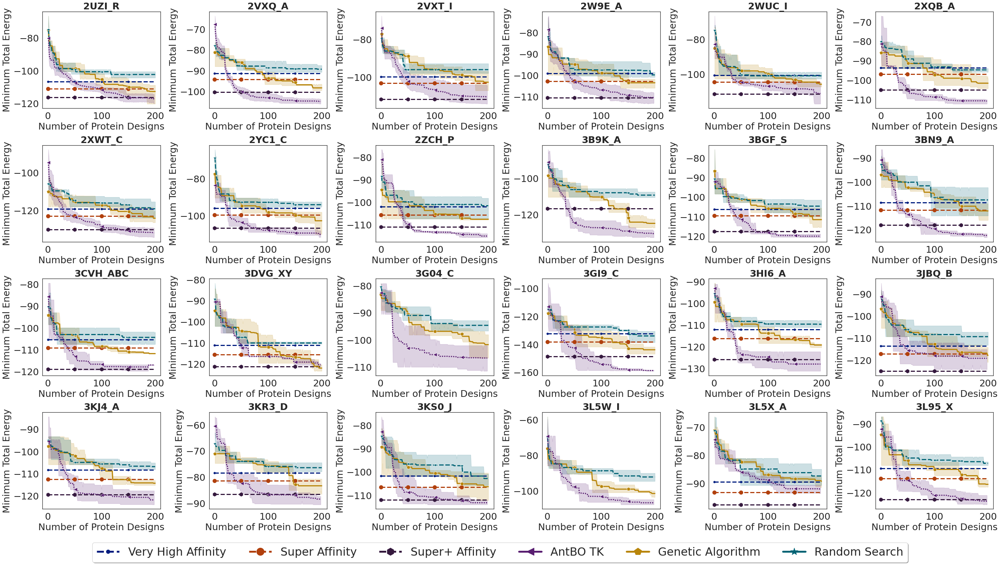

 28%|███████████████████▎                                                 | 50/179 [19:49<57:53, 26.93s/it]

3MJ9_A -103.58 -107.79 -115.38


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


3MJ9_A -115.38 -103.58


 28%|███████████████████▋                                                 | 51/179 [20:11<54:25, 25.51s/it]

3NCY_A -144.59 -149.32 -159.79


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


3NCY_A -159.79 -144.59


 29%|███████████████████▍                                               | 52/179 [21:08<1:13:35, 34.77s/it]

3NFP_I -110.5 -114.87 -120.2
3NFP_I -120.2 -110.5


 30%|███████████████████▊                                               | 53/179 [21:29<1:04:28, 30.70s/it]

3NH7_A -90.55 -93.7 -99.51


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


3NH7_A -99.51 -90.55


 30%|████████████████████▊                                                | 54/179 [21:46<55:27, 26.62s/it]

3NPS_A -125.38 -90.55


 31%|████████████████████▌                                              | 55/179 [22:51<1:18:19, 37.90s/it]

3Q3G_E -105.63 -109.44 -114.4


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


3Q3G_E -114.4 -105.63


 31%|████████████████████▉                                              | 56/179 [23:14<1:09:02, 33.68s/it]

3R08_E -91.36 -95.2 -100.84
3R08_E -100.84 -91.36


 32%|█████████████████████▉                                               | 57/179 [23:33<59:09, 29.09s/it]

3R1G_B -127.26 -131.37 -142.62
3R1G_B -142.62 -127.26


 32%|█████████████████████▋                                             | 58/179 [24:35<1:18:57, 39.16s/it]

3RKD_A -91.73 -96.02 -102.61


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


3RKD_A -102.61 -91.73


 33%|██████████████████████                                             | 59/179 [25:18<1:20:07, 40.06s/it]

3RVV_A -106.55 -111.13 -121.96
3RVV_A -121.96 -106.55


 34%|██████████████████████▍                                            | 60/179 [25:38<1:07:56, 34.26s/it]

3SKJ_E -104.93 -108.74 -114.77


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


3SKJ_E -114.77 -104.93


 34%|██████████████████████▊                                            | 61/179 [26:07<1:03:56, 32.52s/it]

3SO3_A -120.18 -104.93


 35%|███████████████████████▉                                             | 62/179 [26:20<52:24, 26.88s/it]

3SQO_A -111.91 -116.17 -122.89
3SQO_A -122.89 -111.91


 35%|███████████████████████▌                                           | 63/179 [27:08<1:03:44, 32.97s/it]

3TT1_A -139.33 -144.28 -152.77
3TT1_A -152.77 -139.33


 36%|████████████████████████▋                                            | 64/179 [27:23<52:57, 27.63s/it]

3U9P_C -117.99 -121.59 -130.27
3U9P_C -130.27 -117.99


 36%|█████████████████████████                                            | 65/179 [27:35<43:45, 23.03s/it]

3UBX_A -112.92 -117.65 -124.71
3UBX_A -124.71 -112.92


 37%|█████████████████████████▍                                           | 66/179 [27:50<38:37, 20.51s/it]

3V6O_A -112.68 -116.33 -122.24


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


3V6O_A -122.24 -112.68


 37%|█████████████████████████▊                                           | 67/179 [28:07<36:33, 19.58s/it]

3VG9_A -132.58 -137.93 -144.95
3VG9_A -144.95 -132.58


 38%|██████████████████████████▏                                          | 68/179 [28:21<33:07, 17.91s/it]

3WD5_A -110.87 -115.03 -122.29
3WD5_A -122.29 -110.87


 39%|██████████████████████████▌                                          | 69/179 [28:38<32:18, 17.63s/it]

4AEI_A -78.63 -84.43 -95.33
4AEI_A -95.33 -78.63


 39%|██████████████████████████▉                                          | 70/179 [28:55<31:42, 17.45s/it]

4CAD_C -139.62 -144.26 -150.27
4CAD_C -150.27 -139.62


 40%|███████████████████████████▎                                         | 71/179 [29:11<30:25, 16.91s/it]

4DKE_A -124.26 -128.93 -137.11


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


4DKE_A -137.11 -124.26


 40%|███████████████████████████▊                                         | 72/179 [29:29<30:56, 17.35s/it]

4H88_A -107.36 -111.55 -118.76
4H88_A -118.76 -107.36


 41%|████████████████████████████▏                                        | 73/179 [29:48<31:13, 17.67s/it]

4HC1_B -106.59 -110.3 -116.15
4HC1_B -116.15 -106.59


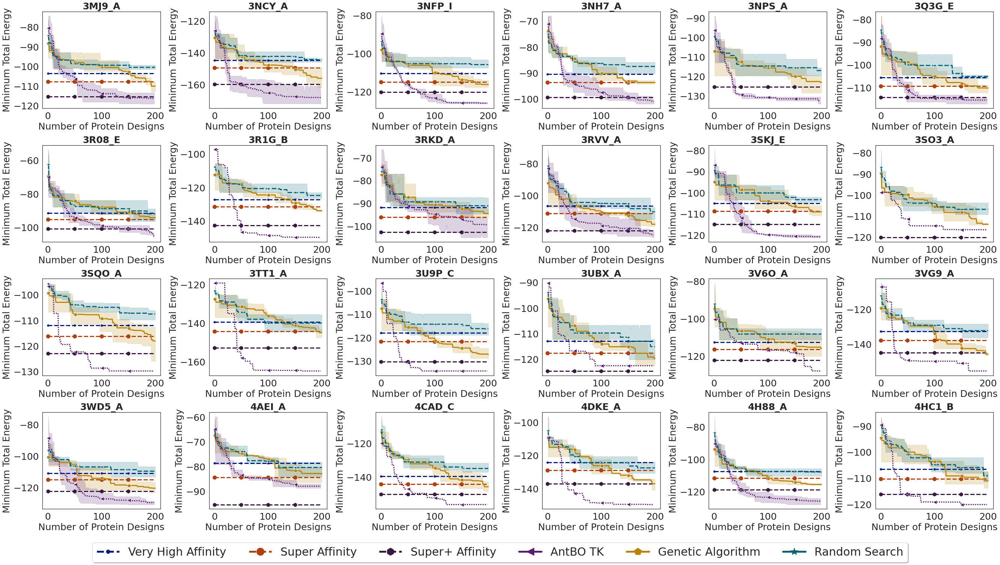

 41%|████████████████████████████▌                                        | 74/179 [30:09<32:48, 18.75s/it]

4HJ0_B -95.55 -98.84 -106.77
4HJ0_B -106.77 -95.55


 42%|████████████████████████████▉                                        | 75/179 [31:13<56:19, 32.50s/it]

4Hj0_A -99.37 -95.55


 42%|████████████████████████████▍                                      | 76/179 [32:17<1:11:50, 41.85s/it]

4I18_R -118.24 -123.7 -131.04
4I18_R -131.04 -118.24


 43%|████████████████████████████▊                                      | 77/179 [32:57<1:09:57, 41.15s/it]

4I77_Z -99.31 -102.89 -109.19
4I77_Z -109.19 -99.31


 44%|██████████████████████████████                                       | 78/179 [33:14<57:04, 33.90s/it]

4IJ3_A -111.21 -99.31


 44%|█████████████████████████████▌                                     | 79/179 [34:19<1:12:00, 43.21s/it]

4K24_A -88.21 -91.48 -96.8
4K24_A -96.8 -88.21


 45%|█████████████████████████████▉                                     | 80/179 [34:40<1:00:45, 36.83s/it]

4K3J_A -107.15 -110.07 -118.05
4K3J_A -118.05 -107.15


 45%|██████████████████████████████▎                                    | 81/179 [35:44<1:13:19, 44.90s/it]

4K9E_C -119.93 -125.01 -134.11


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


4K9E_C -134.11 -119.93


 46%|███████████████████████████████▌                                     | 82/179 [35:59<58:01, 35.89s/it]

4KI5_M -104.73 -108.31 -116.8
4KI5_M -116.8 -104.73


 46%|███████████████████████████████▉                                     | 83/179 [36:18<49:06, 30.69s/it]

4KXZ_A -95.98 -100.16 -107.61


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


4KXZ_A -107.61 -95.98


 47%|████████████████████████████████▍                                    | 84/179 [36:36<42:59, 27.15s/it]

4KXZ_B -125.24 -95.98


 47%|████████████████████████████████▊                                    | 85/179 [37:40<59:23, 37.91s/it]

4KXZ_E -133.45 -95.98


 48%|█████████████████████████████████▏                                   | 86/179 [37:59<50:09, 32.36s/it]

4LQF_A -101.33 -95.98


 49%|█████████████████████████████████▌                                   | 87/179 [38:14<41:33, 27.10s/it]

4LU5_B -97.85 -100.86 -108.44
4LU5_B -108.44 -97.85


 49%|█████████████████████████████████▉                                   | 88/179 [38:50<45:27, 29.97s/it]

4M7L_T -113.33 -97.85


 50%|██████████████████████████████████▎                                  | 89/179 [39:08<39:24, 26.28s/it]

4MXV_B -101.35 -107.06 -112.27


/home/rladmin/anaconda3/envs/DGM/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


4MXV_B -112.27 -101.35


 50%|██████████████████████████████████▋                                  | 90/179 [39:24<34:11, 23.05s/it]

4N9G_C -54.97 -57.35 -62.3
4N9G_C -62.3 -54.97


 51%|███████████████████████████████████                                  | 91/179 [39:54<36:49, 25.11s/it]

4NP4_A -129.28 -134.29 -145.71
4NP4_A -145.71 -129.28


 51%|███████████████████████████████████▍                                 | 92/179 [40:05<30:40, 21.15s/it]

4OII_A -124.82 -129.3 -139.4
4OII_A -139.4 -124.82


 52%|███████████████████████████████████▊                                 | 93/179 [40:13<24:38, 17.19s/it]

4OKV_E -70.13 -72.82 -76.94
4OKV_E -76.94 -70.13


 53%|████████████████████████████████████▏                                | 94/179 [40:25<22:07, 15.61s/it]

4PP1_A -87.27 -93.93 -98.31
4PP1_A -98.31 -87.27


 53%|████████████████████████████████████▌                                | 95/179 [40:41<21:56, 15.68s/it]

4QCI_D -103.92 -107.82 -113.82
4QCI_D -113.82 -103.92


 54%|█████████████████████████████████████                                | 96/179 [40:57<21:45, 15.73s/it]

4QEX_A -107.3 -110.69 -118.85
4QEX_A -118.85 -107.3


 54%|█████████████████████████████████████▍                               | 97/179 [41:08<19:24, 14.20s/it]

4QNP_A -110.18 -114.43 -124.97
4QNP_A -124.97 -110.18


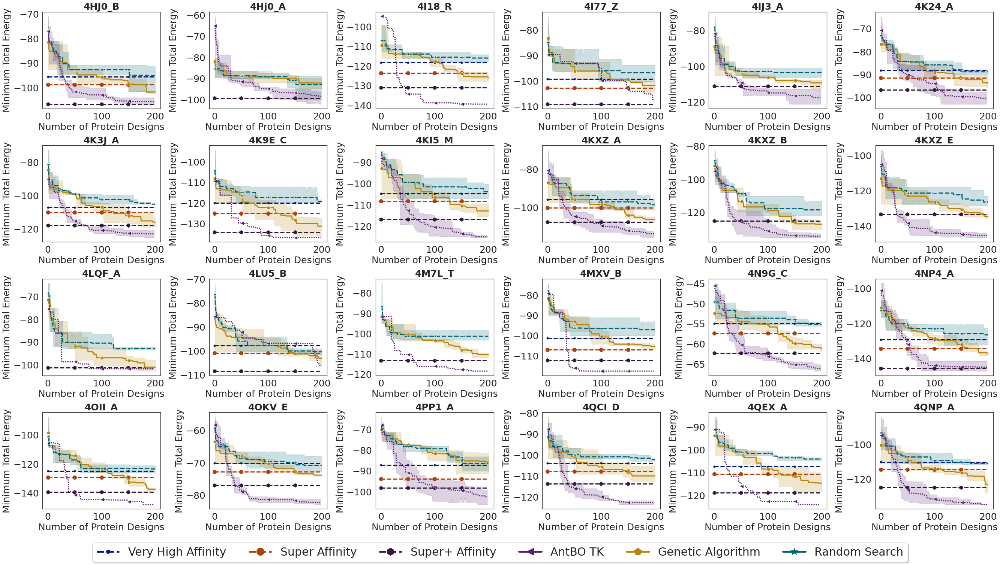

 55%|█████████████████████████████████████▊                               | 98/179 [41:29<22:07, 16.39s/it]

4QWW_A -123.8 -127.83 -141.2
4QWW_A -141.2 -123.8


 55%|██████████████████████████████████████▏                              | 99/179 [41:40<19:34, 14.68s/it]

4R9Y_D -102.99 -106.34 -113.53
4R9Y_D -113.53 -102.99


 56%|█████████████████████████████████████▉                              | 100/179 [41:56<19:47, 15.04s/it]

4RGM_S -98.79 -102.72 -114.84
4RGM_S -114.84 -98.79


 56%|██████████████████████████████████████▎                             | 101/179 [42:06<17:49, 13.71s/it]

4U1G_A -129.73 -134.83 -145.1
4U1G_A -145.1 -129.73


 57%|██████████████████████████████████████▋                             | 102/179 [42:17<16:24, 12.79s/it]

4U6V_A -101.08 -105.04 -116.99
4U6V_A -116.99 -101.08


 58%|███████████████████████████████████████▏                            | 103/179 [42:28<15:22, 12.14s/it]

4WV1_F -95.46 -99.34 -108.68
4WV1_F -108.68 -95.46


 58%|███████████████████████████████████████▌                            | 104/179 [42:43<16:33, 13.25s/it]

4Y5V_C -123.59 -127.33 -137.78
4Y5V_C -137.78 -123.59


 59%|███████████████████████████████████████▉                            | 105/179 [42:54<15:22, 12.46s/it]

4YPG_C -93.91 -98.24 -105.17
4YPG_C -105.17 -93.91


 59%|████████████████████████████████████████▎                           | 106/179 [43:10<16:23, 13.47s/it]

4YUE_C -94.75 -98.72 -106.64
4YUE_C -106.64 -94.75


 60%|████████████████████████████████████████▋                           | 107/179 [43:20<15:08, 12.62s/it]

4ZFG_A -102.9 -107.19 -115.84
4ZFG_A -115.84 -102.9


 60%|█████████████████████████████████████████                           | 108/179 [43:36<16:04, 13.58s/it]

4ZFO_F -83.94 -86.69 -92.31
4ZFO_F -92.31 -83.94


 61%|█████████████████████████████████████████▍                          | 109/179 [43:52<16:37, 14.26s/it]

4ZSO_E -105.9 -108.9 -116.26
4ZSO_E -116.26 -105.9


 61%|█████████████████████████████████████████▊                          | 110/179 [44:03<15:08, 13.16s/it]

5B8C_C -105.21 -109.75 -117.35
5B8C_C -117.35 -105.21


 62%|██████████████████████████████████████████▏                         | 111/179 [44:19<15:49, 13.97s/it]

5BVP_I -108.69 -111.62 -119.76
5BVP_I -119.76 -108.69


 63%|██████████████████████████████████████████▌                         | 112/179 [44:30<14:41, 13.16s/it]

5C0N_A -100.88 -104.01 -110.54
5C0N_A -110.54 -100.88


 63%|██████████████████████████████████████████▉                         | 113/179 [44:46<15:24, 14.01s/it]

5C7X_A -112.37 -116.54 -122.7
5C7X_A -122.7 -112.37


 64%|███████████████████████████████████████████▎                        | 114/179 [45:02<15:48, 14.59s/it]

5CZV_A -110.55 -114.75 -124.03
5CZV_A -124.03 -110.55


 64%|███████████████████████████████████████████▋                        | 115/179 [45:18<15:59, 14.99s/it]

5D93_A -111.08 -114.43 -121.83
5D93_A -121.83 -111.08


 65%|████████████████████████████████████████████                        | 116/179 [45:33<15:55, 15.17s/it]

5DFV_A -93.46 -96.99 -103.63
5DFV_A -103.63 -93.46


 65%|████████████████████████████████████████████▍                       | 117/179 [45:44<14:17, 13.82s/it]

5DHV_M -66.06 -68.41 -72.44
5DHV_M -72.44 -66.06


 66%|████████████████████████████████████████████▊                       | 118/179 [46:00<14:41, 14.45s/it]

5DMI_A -93.48 -97.55 -103.94
5DMI_A -103.94 -93.48


 66%|█████████████████████████████████████████████▏                      | 119/179 [46:16<14:52, 14.87s/it]

5DO2_B -101.89 -105.96 -115.37
5DO2_B -115.37 -101.89


 67%|█████████████████████████████████████████████▌                      | 120/179 [46:32<14:55, 15.18s/it]

5E8D_A -83.51 -86.62 -92.97
5E8D_A -92.97 -83.51


 68%|█████████████████████████████████████████████▉                      | 121/179 [46:48<14:53, 15.40s/it]

5E8E_LH -114.12 -120.55 -127.95
5E8E_LH -127.95 -114.12


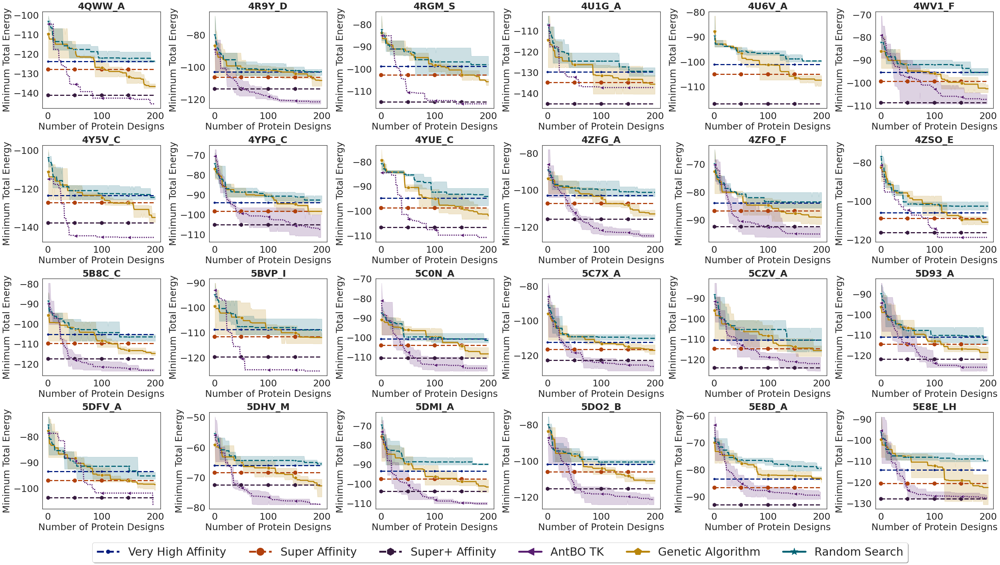

 68%|██████████████████████████████████████████████▎                     | 122/179 [47:09<16:22, 17.24s/it]

5E94_G -100.59 -104.39 -110.91
5E94_G -110.91 -100.59


 69%|██████████████████████████████████████████████▋                     | 123/179 [47:20<14:14, 15.27s/it]

5EII_G -95.28 -98.48 -104.15
5EII_G -104.15 -95.28


 69%|███████████████████████████████████████████████                     | 124/179 [47:30<12:42, 13.87s/it]

5EPM_C -74.93 -77.93 -84.22
5EPM_C -84.22 -74.93


 70%|███████████████████████████████████████████████▍                    | 125/179 [47:46<13:00, 14.46s/it]

5EU7_A -107.0 -111.12 -120.22
5EU7_A -120.22 -107.0


 70%|███████████████████████████████████████████████▊                    | 126/179 [47:57<11:44, 13.29s/it]

5EZO_A -124.65 -129.33 -140.18
5EZO_A -140.18 -124.65


 71%|████████████████████████████████████████████████▏                   | 127/179 [48:07<10:49, 12.50s/it]

5F3B_C -96.18 -100.22 -106.32
5F3B_C -106.32 -96.18


 72%|████████████████████████████████████████████████▋                   | 128/179 [48:18<10:03, 11.84s/it]

5FB8_C -92.62 -96.02 -102.75
5FB8_C -102.75 -92.62


 72%|█████████████████████████████████████████████████                   | 129/179 [48:28<09:33, 11.48s/it]

5H35_C -121.17 -124.77 -133.71
5H35_C -133.71 -121.17


 73%|█████████████████████████████████████████████████▍                  | 130/179 [48:44<10:26, 12.78s/it]

5HDQ_A -113.13 -117.49 -123.0
5HDQ_A -123.0 -113.13


 73%|█████████████████████████████████████████████████▊                  | 131/179 [48:55<09:42, 12.13s/it]

5HI4_B -103.04 -107.07 -112.4
5HI4_B -112.4 -103.04


 74%|██████████████████████████████████████████████████▏                 | 132/179 [49:05<09:08, 11.67s/it]

5IKC_M -89.69 -93.04 -99.29
5IKC_M -99.29 -89.69


 74%|██████████████████████████████████████████████████▌                 | 133/179 [49:21<09:54, 12.93s/it]

5J13_A -92.15 -95.7 -102.27
5J13_A -102.27 -92.15


 75%|██████████████████████████████████████████████████▉                 | 134/179 [49:32<09:10, 12.23s/it]

5JW4_A -123.68 -128.73 -135.55
5JW4_A -135.55 -123.68


 75%|███████████████████████████████████████████████████▎                | 135/179 [49:48<09:45, 13.31s/it]

5JZ7_A -104.17 -107.17 -114.59
5JZ7_A -114.59 -104.17


 77%|████████████████████████████████████████████████████▍               | 138/179 [50:35<10:13, 14.97s/it]

5KTE_A -136.04 -141.34 -150.27
5KTE_A -150.27 -136.04


 78%|█████████████████████████████████████████████████████▏              | 140/179 [50:46<06:50, 10.52s/it]

5L0Q_A -106.38 -109.7 -116.84
5L0Q_A -116.84 -106.38


 79%|█████████████████████████████████████████████████████▌              | 141/179 [51:02<07:29, 11.83s/it]

5LQB_A -104.67 -108.85 -116.33
5LQB_A -116.33 -104.67


 79%|█████████████████████████████████████████████████████▉              | 142/179 [51:17<07:56, 12.87s/it]

5MES_A -112.47 -117.6 -125.79
5MES_A -125.79 -112.47


 80%|██████████████████████████████████████████████████████▎             | 143/179 [51:33<08:12, 13.68s/it]

5T5F_A -110.18 -114.19 -125.54
5T5F_A -125.54 -110.18


 80%|██████████████████████████████████████████████████████▋             | 144/179 [51:49<08:19, 14.28s/it]

5TH9_A -124.06 -127.41 -135.9
5TH9_A -135.9 -124.06


 81%|███████████████████████████████████████████████████████             | 145/179 [52:00<07:30, 13.24s/it]

5TLJ_X -95.5 -99.14 -107.8
5TLJ_X -107.8 -95.5


 82%|███████████████████████████████████████████████████████▍            | 146/179 [52:10<06:51, 12.47s/it]

5TZ2_C -92.41 -96.89 -101.31
5TZ2_C -101.31 -92.41


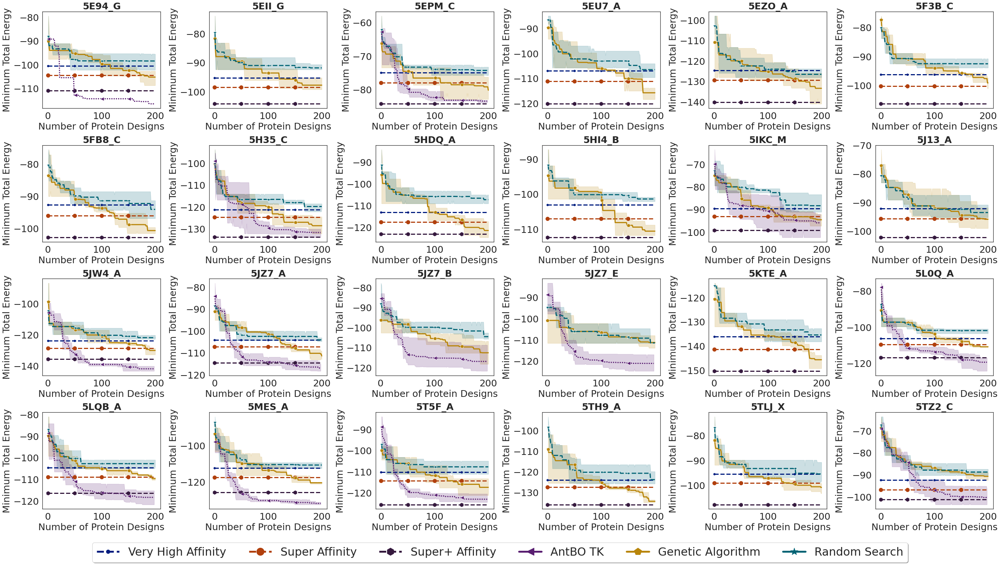

 95%|████████████████████████████████████████████████████████████████▌   | 170/179 [57:19<01:47, 11.90s/it]

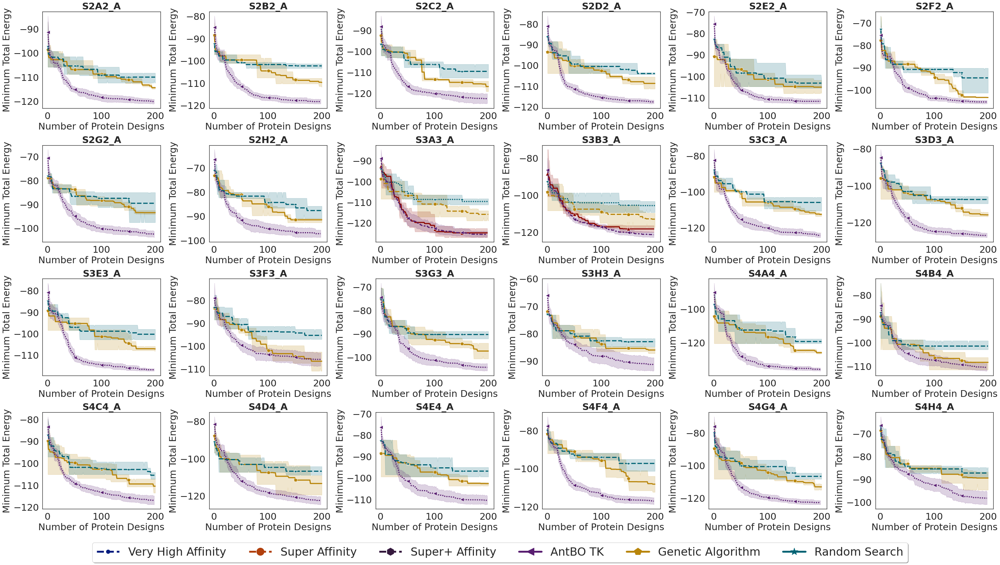

 99%|███████████████████████████████████████████████████████████████████▌| 178/179 [58:59<00:11, 11.98s/it]

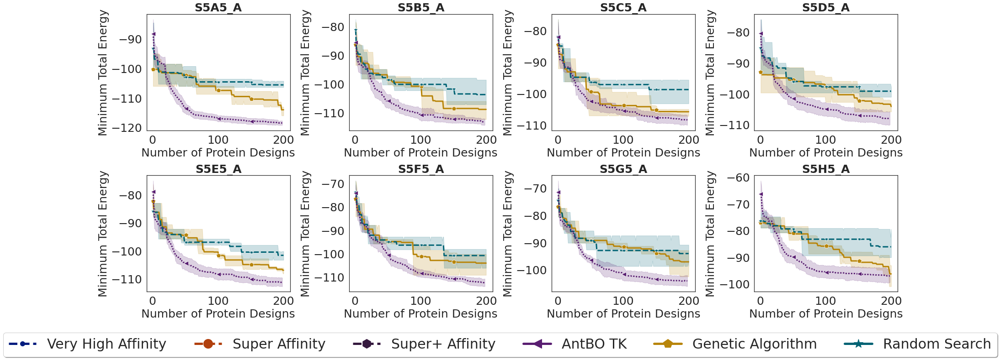

100%|████████████████████████████████████████████████████████████████████| 179/179 [59:12<00:00, 19.85s/it]


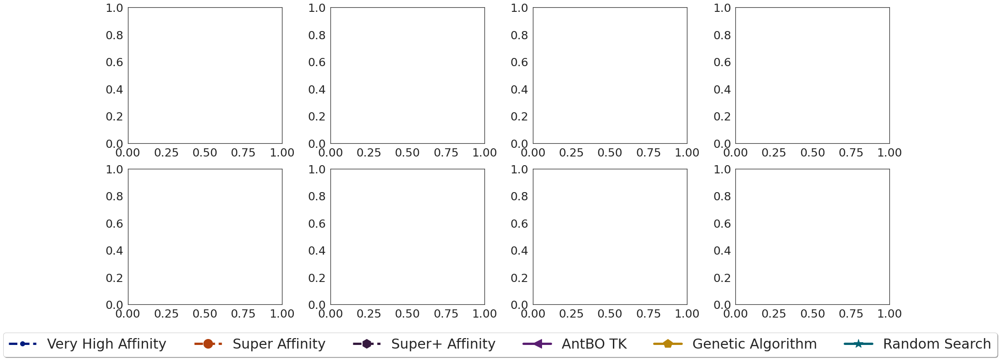

figC in last image 0
Skipped Antigens ['2HFG_R', '3EFD_K', '5KN5_C']


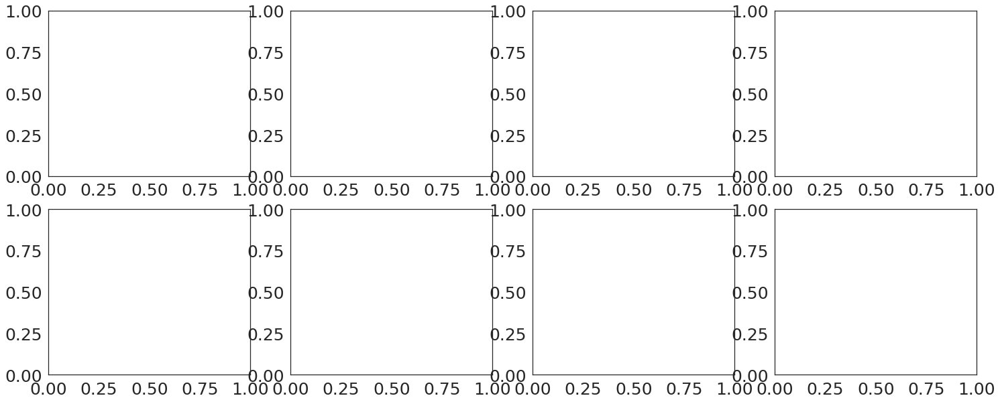

In [126]:
# Plot over all antigens 
import numpy as np
from tqdm import tqdm 
from copy import deepcopy 

# Markers = {'+','o','*','x','v','d','^','s','>','<'}
cols = 6
rows = 4
fig, axs = plt.subplots(nrows=rows, ncols=cols, figsize = (6.2*cols, 5*rows))
axs = axs.reshape(rows, cols)
matplotlib.rc('xtick', labelsize=fsize)
matplotlib.rc('ytick', labelsize=fsize)
row, col = 0, 0
fsize = 25
figC = 0
resetC = 0
total_figures = 0
skipped_antigens = []
remaining_antigens = list(sorted(remaining_antigens))
for antigen in tqdm(remaining_antigens):
    filtered = results[results['Antigen']==antigen]
    
    if filtered.shape[0]>0:
        ax = axs[row, col] 
        if col == (cols-1):
            row += 1
            col = 0
        else:
            col += 1
        # Plot Absolut! Best
        min_best_affin = None
        try:
            tmp = thresholdPd[thresholdPd.AGname==antigen] 
            max_high_aff = tmp[tmp.type=='Heroes']['maxEnergy'].item()
            max_sh_affin = tmp[tmp.type=='SuperHeroes']['maxEnergy'].item()
            min_best_affin = tmp[tmp.type=='SuperHeroes']['minEnergy'].item()
            ax.plot(list(range(0, f_evals)), f_evals * [max_high_aff], marker=markerDINV['High Affinity'], markevery=50, markersize=10,
                     color=colourDINV['High Affinity'], linestyle='--', linewidth=3)
            ax.plot(list(range(0, f_evals)), f_evals * [max_sh_affin], marker=markerDINV['Super Affinity'], markevery=50, markersize=10,
                     color=colourDINV['Super Affinity'], linestyle='--', linewidth=3)
            print(antigen, max_high_aff, max_sh_affin, min_best_affin)
        except:
            pass

        sequences = None
        filenames = glob.glob(f"/mnt/data/CDRdata/RawBindingsMurine/{antigen}/*.txt")
        for i in range(len(filenames)):
            try:
                if i == 0:
                    sequences = pd.read_csv(filenames[i], skiprows=1, sep='\t')
                else:
                    sequences.append(pd.read_csv(filenames[i], skiprows=1, sep='\t'))
            except:
                pass 
        min_energy = np.inf
        if (sequences is not None) or (min_best_affin is not None):
            if sequences is not None:
                min_energy = min(min_energy, sequences['Energy'].values.min())
            if min_best_affin is not None:
                min_energy = min(min_energy, min_best_affin)
            # min_energy *= -1.0
            f_evals = 200
            try:
                assert min_energy<max_high_aff
                ax.plot(list(range(0, f_evals)), f_evals * [min_energy], marker=markerDINV['Absolut! 6.9M'], markevery=50, markersize=10,
                         color=sns.color_palette('rocket')[0], linestyle='--', linewidth=3)    
            except:
                pass
            print(antigen, min_energy,max_high_aff)
        else:
            pass 
        
        
        ax.set_title(f"{antigen}", fontsize=fsize, fontweight="bold")
        ax.set_xlabel('', fontsize=fsize)
        ax.set_ylabel('', fontsize=fsize)
#         ax.grid()
        ax = sns.lineplot(data=filtered, ax=ax,  x='Num BB Evals', y='Best Binding Energy', hue = "Method", legend=False, linewidth=3, palette=colourDINV, style='Method', markers=markerDINV, markevery=50, markersize=10)
        total_figures += 1 
        ax.set_xlabel('Number of Protein Designs', fontsize=fsize)
        ax.set_ylabel('Minimum Total Energy', fontsize=fsize)
#         if row==col and row==0:
# #             handles, labels = ax.get_legend_handles_labels()
# #             labels = replace_labels(labels, LabelDict)
#             for legend_handle in handles_app:
#                 legend_handle.set_markersize(20)
#                 legend_handle.set_linewidth(20)
#                 legend_handle.set_markeredgewidth(20)

        figC += 1
#         plt.show()
    else:
        skipped_antigens.append(antigen)
        continue 
        
    if figC==cols*rows:
        
        ax.plot([], linestyle='--', color=colourDINV['High Affinity'], marker=markerDINV['High Affinity'], linewidth=5, markersize=20, label='Very High Affinity')
        ax.plot([], linestyle='--', color=colourDINV['Super Affinity'], marker=markerDINV['Super Affinity'], linewidth=5, markersize=20, label='Super Affinity')
        ax.plot([], linestyle='--', color=sns.color_palette('rocket')[0], marker=markerDINV['Absolut! 6.9M'], linewidth=5, markersize=20, label='Super+ Affinity')

        for label_n in LabelDict.keys():
            if label_n in ['Absolut! 6.9M', 'Super Affinity', 'High Affinity']:
                pass
            elif label_n in ['BO_transformed_overlap', 'GA', 'RS']:
                ax.plot([], color=colourDINV[label_n], marker=markerDINV[label_n], label=LabelDict[label_n], linewidth=5, markersize=20)
        

        handles_app, labels_app = ax.get_legend_handles_labels()
        n_col_legend = len(labels_app)
        lgd = fig.legend(handles_app, labels_app, bbox_to_anchor=(0.5, 0.0), ncol=n_col_legend, loc='upper center', fancybox=True, shadow=True, fontsize=30)
        fig.tight_layout()
        plt.savefig(os.path.join("/home/rladmin/antigenbinding/plots", f"binding_vs_funct_evals_app_{resetC}.pdf"), bbox_extra_artists=(lgd, ), pad_inches=0.1, bbox_inches='tight')
        plt.show()
        figC = 0 
        if total_figures>160:
            cols = 4
            rows = 2
        fig, axs = plt.subplots(nrows=rows, ncols=cols, figsize = (6.2*cols, 5*rows))
        axs = axs.reshape(rows, cols)
        resetC += 1
        row, col = 0, 0
    
n_col_legend = len(labels_app)
lgd = fig.legend(handles_app, labels_app, bbox_to_anchor=(0.5, 0.0), ncol=n_col_legend, loc='upper center', fancybox=True, shadow=True, fontsize=30)
for legendHandles in lgd.legendHandles:
    legendHandles._sizes = [30]
fig.tight_layout()
plt.savefig(os.path.join("/home/rladmin/antigenbinding/plots", f"binding_vs_funct_evals_app_{resetC}.pdf"), bbox_extra_artists=(lgd, ), pad_inches=0.1, bbox_inches='tight')
plt.show()
fig, axs = plt.subplots(nrows=rows, ncols=cols, figsize = (6.2*cols, 5*rows))
axs = axs.reshape(rows, cols)
print('figC in last image', figC)
print('Skipped Antigens', skipped_antigens)

# RLBO Hybrid

In [ ]:
import numpy as np
import torch

class ReplayBuffer:

    def __init__(self, environment, capacity=10000):
        transition_type_str = self.get_transition_type_str(environment)
        self.buffer = np.zeros(capacity, dtype=transition_type_str)
        self.weights = np.zeros(capacity)
        self.head_idx = 0
        self.count = 0
        self.capacity = capacity
        self.max_weight = 10**-2
        self.delta = 10**-4
        self.indices = None

    def get_transition_type_str(self, environment):
        state_dim = environment.observation_space.shape[0]
        state_dim_str = '' if state_dim == () else str(state_dim)
        state_type_str = environment.observation_space.sample().dtype.name
        action_dim = environment.action_space.shape
        action_dim_str = '' if action_dim == () else str(action_dim)
        action_type_str = environment.action_space.sample().__class__.__name__

        # type str for transition = 'state type, action type, reward type, state type'
        transition_type_str = '{0}{1}, {2}{3}, float32, {0}{1}, bool'.format(state_dim_str, state_type_str,
                                                                             action_dim_str, action_type_str)

        return transition_type_str

    def add_transition(self, transition):
        self.buffer[self.head_idx] = transition
        self.weights[self.head_idx] = self.max_weight

        self.head_idx = (self.head_idx + 1) % self.capacity
        self.count = min(self.count + 1, self.capacity)

    def sample_minibatch(self, size=100):
        set_weights = self.weights[:self.count] + self.delta
        probabilities = set_weights / sum(set_weights)
        self.indices = np.random.choice(range(self.count), size, p=probabilities, replace=False)
        return self.buffer[self.indices]

    def update_weights(self, prediction_errors):
        max_error = max(prediction_errors)
        self.max_weight = max(self.max_weight, max_error)
        self.weights[self.indices] = prediction_errors

    def get_size(self):
        return self.count


class Network(torch.nn.Module):

    def __init__(self, input_dimension, output_dimension, output_activation=torch.nn.Identity()):
        super(Network, self).__init__()
        self.layer_1 = torch.nn.Linear(in_features=input_dimension, out_features=16)
        self.layer_2 = torch.nn.Linear(in_features=16, out_features=16)
        self.output_layer = torch.nn.Linear(in_features=16, out_features=output_dimension)
        self.output_activation = output_activation

    def forward(self, inpt):
        layer_1_output = torch.nn.functional.relu(self.layer_1(inpt.float()))
        layer_2_output = torch.nn.functional.relu(self.layer_2(layer_1_output))
        output = self.output_activation(self.output_layer(layer_2_output))
        return output



class SACAgent:

    ALPHA_INITIAL = 1.
    REPLAY_BUFFER_BATCH_SIZE = 100
    DISCOUNT_RATE = 1.0
    LEARNING_RATE = 10 ** -4
    SOFT_UPDATE_INTERPOLATION_FACTOR = 0.01

    def __init__(self, environment):
        self.environment = environment
        self.state_dim = self.environment.observation_space.shape[0]
        self.action_dim = self.environment.action_space.n
        self.critic_local = Network(input_dimension=self.state_dim,
                                    output_dimension=self.action_dim)
        self.critic_local2 = Network(input_dimension=self.state_dim,
                                     output_dimension=self.action_dim)
        self.critic_optimiser = torch.optim.Adam(self.critic_local.parameters(), lr=self.LEARNING_RATE)
        self.critic_optimiser2 = torch.optim.Adam(self.critic_local2.parameters(), lr=self.LEARNING_RATE)

        self.critic_target = Network(input_dimension=self.state_dim,
                                     output_dimension=self.action_dim)
        self.critic_target2 = Network(input_dimension=self.state_dim,
                                      output_dimension=self.action_dim)

        self.soft_update_target_networks(tau=1.)

        self.actor_local = Network(
            input_dimension=self.state_dim,
            output_dimension=self.action_dim,
            output_activation=torch.nn.Softmax(dim=1)
        )
        self.actor_optimiser = torch.optim.Adam(self.actor_local.parameters(), lr=self.LEARNING_RATE)

        self.replay_buffer = ReplayBuffer(self.environment)

        self.target_entropy = 0.98 * -np.log(1 / self.environment.action_space.n)
        self.log_alpha = torch.tensor(np.log(self.ALPHA_INITIAL), requires_grad=True)
        self.alpha = self.log_alpha
        self.alpha_optimiser = torch.optim.Adam([self.log_alpha], lr=self.LEARNING_RATE)

    def get_next_action(self, state, evaluation_episode=False):
        if evaluation_episode:
            discrete_action = self.get_action_deterministically(state)
        else:
            discrete_action = self.get_action_nondeterministically(state)
        return discrete_action
    
    def temperature_loss(self, log_action_probabilities):
        alpha_loss = -(self.log_alpha * (log_action_probabilities + self.target_entropy).detach()).mean()
        return alpha_loss

    def get_action_nondeterministically(self, state):
        action_probabilities = self.get_action_probabilities(state)
        discrete_action = np.random.choice(range(self.action_dim), p=action_probabilities)
        return discrete_action

    def get_action_deterministically(self, state):
        action_probabilities = self.get_action_probabilities(state)
        discrete_action = np.argmax(action_probabilities)
        return discrete_action


    def train_on_transition(self, state, discrete_action, next_state, reward, done):
        transition = (state, discrete_action, reward, next_state, done)
        self.train_networks(transition)

    def train_networks(self, transition):
        # Set all the gradients stored in the optimisers to zero.
        self.critic_optimiser.zero_grad()
        self.critic_optimiser2.zero_grad()
        self.actor_optimiser.zero_grad()
        self.alpha_optimiser.zero_grad()
        # Calculate the loss for this transition.
        self.replay_buffer.add_transition(transition)
        # Compute the gradients based on this loss, i.e. the gradients of the loss with respect to the Q-network
        # parameters.
        if self.replay_buffer.get_size() >= self.REPLAY_BUFFER_BATCH_SIZE:
            # get minibatch of 100 transitions from replay buffer
            minibatch = self.replay_buffer.sample_minibatch(self.REPLAY_BUFFER_BATCH_SIZE)
            minibatch_separated = list(map(list, zip(*minibatch)))

            # unravel transitions to get states, actions, rewards and next states
            states_tensor = torch.tensor(np.array(minibatch_separated[0]))
            actions_tensor = torch.tensor(np.array(minibatch_separated[1]))
            rewards_tensor = torch.tensor(np.array(minibatch_separated[2])).float()
            next_states_tensor = torch.tensor(np.array(minibatch_separated[3]))
            done_tensor = torch.tensor(np.array(minibatch_separated[4]))

            critic_loss, critic2_loss = \
                self.critic_loss(states_tensor, actions_tensor, rewards_tensor, next_states_tensor, done_tensor)

            critic_loss.backward()
            critic2_loss.backward()
            self.critic_optimiser.step()
            self.critic_optimiser2.step()

            actor_loss, log_action_probabilities = self.actor_loss(states_tensor)

            actor_loss.backward()
            self.actor_optimiser.step()

            alpha_loss = self.temperature_loss(log_action_probabilities)

            alpha_loss.backward()
            self.alpha_optimiser.step()
            self.alpha = self.log_alpha.exp()

            self.soft_update_target_networks()

    def critic_loss(self, states_tensor, actions_tensor, rewards_tensor, next_states_tensor, done_tensor):
        with torch.no_grad():
            action_probabilities, log_action_probabilities = self.get_action_info(next_states_tensor)
            next_q_values_target = self.critic_target.forward(next_states_tensor)
            next_q_values_target2 = self.critic_target2.forward(next_states_tensor)
            soft_state_values = (action_probabilities * (
                    torch.min(next_q_values_target, next_q_values_target2) - self.alpha * log_action_probabilities
            )).sum(dim=1)

            next_q_values = rewards_tensor + ~done_tensor * self.DISCOUNT_RATE*soft_state_values

        soft_q_values = self.critic_local(states_tensor).gather(1, actions_tensor.unsqueeze(-1)).squeeze(-1)
        soft_q_values2 = self.critic_local2(states_tensor).gather(1, actions_tensor.unsqueeze(-1)).squeeze(-1)
        critic_square_error = torch.nn.MSELoss(reduction="none")(soft_q_values, next_q_values)
        critic2_square_error = torch.nn.MSELoss(reduction="none")(soft_q_values2, next_q_values)
        weight_update = [min(l1.item(), l2.item()) for l1, l2 in zip(critic_square_error, critic2_square_error)]
        self.replay_buffer.update_weights(weight_update)
        critic_loss = critic_square_error.mean()
        critic2_loss = critic2_square_error.mean()
        return critic_loss, critic2_loss

    def actor_loss(self, states_tensor,):
        action_probabilities, log_action_probabilities = self.get_action_info(states_tensor)
        q_values_local = self.critic_local(states_tensor)
        q_values_local2 = self.critic_local2(states_tensor)
        inside_term = self.alpha * log_action_probabilities - torch.min(q_values_local, q_values_local2)
        policy_loss = (action_probabilities * inside_term).sum(dim=1).mean()
        return policy_loss, log_action_probabilities

    def get_action_info(self, states_tensor):
        action_probabilities = self.actor_local.forward(states_tensor)
        z = action_probabilities == 0.0
        z = z.float() * 1e-8
        log_action_probabilities = torch.log(action_probabilities + z)
        return action_probabilities, log_action_probabilities

    def get_action_probabilities(self, state):
        state_tensor = torch.tensor(state, dtype=torch.float32).unsqueeze(0)
        action_probabilities = self.actor_local.forward(state_tensor)
        return action_probabilities.squeeze(0).detach().numpy()

    def soft_update_target_networks(self, tau=SOFT_UPDATE_INTERPOLATION_FACTOR):
        self.soft_update(self.critic_target, self.critic_local, tau)
        self.soft_update(self.critic_target2, self.critic_local2, tau)

    def soft_update(self, target_model, origin_model, tau):
        for target_param, local_param in zip(target_model.parameters(), origin_model.parameters()):
            target_param.data.copy_(tau * local_param.data + (1 - tau) * target_param.data)

    def predict_q_values(self, state):
        q_values = self.critic_local(state)
        q_values2 = self.critic_local2(state)
        return torch.min(q_values, q_values2)

In [ ]:
config = load_config("/home/rladmin/antigenbinding/bo/config_combhebo.yaml")
absolut_config = {"antigen": '1OB1_C',
                      "path": '/home/rladmin/antigenbinding/Absolut1/',
                      "process": config['bbox']['process'],
                      'startTask': config['bbox']['startTask']}
dim = 11
# Defining the fitness function
absolut_binding_energy = Absolut(absolut_config)

def function(x):
    x = x.astype(int)
    return absolut_binding_energy.Energy(x)

In [ ]:
function(np.ones((2,11)))

In [ ]:
import gym
from gym import spaces
import numpy as np
import os
import subprocess
import pandas as pd
import csv

from itertools import groupby
import re
import time



class BindingEnvironmentRefac(gym.Env):
    """Custom Environment that follows gym interface"""

    def __init__(self, config, evaluator, rank=0, positive_reward=False):
        super().__init__()
        # Define action and observation space
        # They must be gym.spaces objects
        # Example when using discrete actions:
        self.env_name = config["environment_name"]

        self.n_sequences = config["n_sequences"]
        self.n_dimensions = config["dimensions"]
        self.positive_reward = positive_reward
        self.evaluator = evaluator

        if(self.env_name=="sequence_optim"):
            self.action_space = spaces.Discrete(self.n_dimensions)
            self.observation_space = spaces.MultiBinary(self.n_sequences * (self.n_dimensions + 1))
            self.past_obs = np.zeros((self.n_sequences * (self.n_dimensions + 1),))
            self.maximum_steps = 11
            self.current_step = 0
            self.rank = str(rank)
            self.file = "results_cpu_{}.csv".format(self.rank)
            csv_columns = ["Index", "LastValue", "Time", "LastProtein"]
        elif(self.env_name=="batch_optim"):
            self.action_space = spaces.Tuple((spaces.Discrete(self.n_sequences), spaces.Discrete(self.n_dimensions)))
            self.observation_space = spaces.Tuple((spaces.Discrete(self.n_sequences), spaces.Discrete(self.n_dimensions+1)))
            self.file = "results.csv"
            self.best_value = 0
            self.best_protein = None
            self.current_step = 0
            self.maximum_steps = 1
            csv_columns = ["Index", "LastValue", "BestValue", "Time", "LastProtein", "BestProtein"]
        else:
            raise NotImplementedError("{} is not an environment.".format(self.env_name))

        self.recorded_energy = {}
        self.start_time = time.time()
        self.index = 1

    def step(self, action):
        if(self.env_name == "sequence_optim"):
            new_obs = np.zeros((self.n_sequences, (self.n_dimensions + 1))).astype(int)
            one_hot_action = np.zeros((self.n_dimensions + 1,)).astype(int)
            one_hot_action[action] = 1
            seq_act_past_obs = self.past_obs.reshape((self.n_sequences, (self.n_dimensions + 1)))
            new_obs[:-1] = seq_act_past_obs[1:]
            new_obs[-1] = one_hot_action
        else:
            new_obs = action

        if (self.current_step < self.maximum_steps - 1):
            reward = 0
            info = {}
            self.current_step += 1
            done = False
        else:
            #convert multibinary to discrete
            if(self.env_name== "sequence_optim"):
                eval_obs = np.zeros((1, self.n_dimensions + 1)).astype(int)
                for i, seq in enumerate(new_obs):
                    eval_obs[0, i] = np.where(seq == 1)[0].item()
            else:
                eval_obs = new_obs

            reward, seq = self.evaluator(eval_obs)
            if(self.env_name == "sequence_optim"):
                reward = reward[0]
                seq = seq[0]

            info = {"Reward": reward}
            done = True

        if(self.env_name=="sequence_optim"):
            new_obs = new_obs.flatten()
            self.past_obs = new_obs

        if(done):
            if(self.positive_reward==True):
                reward *= -1
                reward /= 110.0
        return new_obs, reward, done, info

    def reset(self):

        if(self.env_name == "sequence_optim"):
            observation = np.zeros((self.n_sequences, (self.n_dimensions + 1))).astype(int)
            observation[:, -1] = 1
            observation = observation.flatten()
        else:
            observation = np.zeros((self.n_sequences, self.n_dimensions)).astype(int) + (self.n_dimensions+1)

        self.current_step = 0
        self.past_obs = observation

        return self.past_obs  # reward, done, info can't be included


In [ ]:
config = {"environment_name": "sequence_optim", "n_sequences": 11, "dimensions": 20}
env = BindingEnvironmentRefac(config, function, positive_reward=True)

In [ ]:
import matplotlib.pyplot as plt
from tqdm import tqdm
TRAINING_EVALUATION_RATIO = 10
RUNS = 3
EPISODES_PER_RUN = 200
STEPS_PER_EPISODE = 12

In [ ]:
agent_results = []
for run in range(RUNS):
    agent = SACAgent(env)
    run_results = []
    for episode_number in tqdm(range(EPISODES_PER_RUN)):
        print('\r', f'Run: {run + 1}/{RUNS} | Episode: {episode_number + 1}/{EPISODES_PER_RUN}', end=' ')
#         evaluation_episode = episode_number % TRAINING_EVALUATION_RATIO == 0
        evaluation_episode = False
        episode_reward = 0
        state = env.reset()
        done = False
        i = 0
        while not done and i < STEPS_PER_EPISODE:
            i += 1
            action = agent.get_next_action(state, evaluation_episode=False)
            next_state, reward, done, info = env.step(action)
            if not evaluation_episode:
                agent.train_on_transition(state, action, next_state, reward, done)
            episode_reward += reward
            state = next_state
        if True:
            run_results.append(episode_reward)
            
        if episode_number % TRAINING_EVALUATION_RATIO == 0:
#             n_results = episode_number // TRAINING_EVALUATION_RATIO
            n_results = episode_number
            results_mean = [np.mean([agent_result[n] for agent_result in [-110.0*np.maximum.accumulate(run_results)]]) for n in range(n_results)]
            results_std = [np.std([agent_result[n] for agent_result in [-110.0*np.maximum.accumulate(run_results)]]) for n in range(n_results)]
            mean_plus_std = [m + s for m, s in zip(results_mean, results_std)]
            mean_minus_std = [m - s for m, s in zip(results_mean, results_std)]

            x_vals = list(range(len(results_mean)))

            ax = plt.gca()
            ax.set_title('1OB1_C')
            ax.set_ylabel('Binding Energy')
            ax.set_xlabel('Acquisition Step')
            ax.plot(x_vals, results_mean, label='Average Result', color='blue')
            ax.plot(x_vals, mean_plus_std, color='blue', alpha=0.1)
            ax.plot(x_vals, mean_minus_std, color='blue', alpha=0.1)
            ax.fill_between(x_vals, y1=mean_minus_std, y2=mean_plus_std, alpha=0.1, color='blue')
            plt.legend(loc='best')
            plt.savefig('Discrete_SAC_Antigen.png')
            plt.show()
            
            
    agent_results.append(-110.0*np.maximum.accumulate(run_results))

    
n_results = episode_number // TRAINING_EVALUATION_RATIO
results_mean = [np.mean([agent_result[n] for agent_result in agent_results]) for n in range(n_results)]
results_std = [np.std([agent_result[n] for agent_result in agent_results]) for n in range(n_results)]
mean_plus_std = [m + s for m, s in zip(results_mean, results_std)]
mean_minus_std = [m - s for m, s in zip(results_mean, results_std)]

x_vals = list(range(len(results_mean)))
x_vals = [x_val * (TRAINING_EVALUATION_RATIO - 1) for x_val in x_vals]

ax = plt.gca()
ax.set_ylabel('Episode Score')
ax.set_xlabel('Training Episode')
ax.plot(x_vals, results_mean, label='Average Result', color='blue')
ax.plot(x_vals, mean_plus_std, color='blue', alpha=0.1)
ax.plot(x_vals, mean_minus_std, color='blue', alpha=0.1)
ax.fill_between(x_vals, y1=mean_minus_std, y2=mean_plus_std, alpha=0.1, color='blue')
plt.legend(loc='best')
plt.savefig('Discrete_SAC_Antigen.png')
plt.show()
    
env.close()


# COMBO-SAC

In [ ]:
from pymoo.algorithms.soo.nonconvex.ga import GA
from pymoo.factory import get_mutation, get_crossover, get_termination
from pymoo.optimize import minimize
from pymoo.core.problem import Problem
import numpy as np
import random 

def sample_neighbour_ordinal(x, n_categories):
    """Same as above, but the variables are represented ordinally."""
    try:
        x_pert = deepcopy(x)
        # Chooose a variable to modify
        choice = random.randint(0, len(n_categories) - 1)
        # Obtain the current value.
        curr_val = x[choice]
        options = [i for i in range(n_categories[choice]) if i != curr_val]
        x_pert[choice] = random.choice(options)
        return x_pert
    except:
        return sample_neighbour_ordinal(x, n_categories)

def neighbourhood_init(x_center_local, pop_size):
    n_categories = np.arange(0, 20,1)
    pop = np.array([sample_neighbour_ordinal(x_center_local, n_categories) for _ in range((pop_size))])
    pop[0] = x_center_local
    return pop

In [ ]:
class CDRH3Prob(Problem):
    """CDRH3 Problem For pymoo.
    Maximise f_acq but taking the negative in  _evaluate to perform minimisation overall.
    A solution is considered as feasible of all constraint violations are less than zero."""

    def __init__(self, f_acq, n_var=11, n_obj=1, n_constr=0, xl=0, xu=19, device=torch.device('cpu'), dtype=torch.float32):
        super().__init__(n_var=n_var,
                         n_obj=n_obj,
                         n_constr=n_constr if cdr_constraints else 0,
                         xl=xl,
                         xu=xu)
        self.f_acq = f_acq
        self.device = device
        self.dtype = dtype

    def _evaluate(self, X, out, *args, **kwargs):
        with torch.no_grad():
            new_x = torch.from_numpy(X)
            acq_x = -1.0 * self.f_acq(new_x).detach().cpu().numpy()
        out["F"] = acq_x

In [ ]:
pop_size = 200
seq_len = 11 
init_pop = neighbourhood_init(best_x, pop_size)
algorithm = GA(pop_size=pop_size,
              n_offsprings=pop_size,
              sampling=init_pop,
              crossover=get_crossover("int_sbx", eta = 20, prob = 0.9, prob_per_variable=1.0/seq_len),
              mutation=get_mutation("int_pm", eta = 20),
              eliminate_duplicates=False)

In [ ]:
class NeuralCOMB:

    REPLAY_BUFFER_BATCH_SIZE = 100
    LEARNING_RATE = 10 ** -3

    def __init__(self, environment):
        self.environment = environment
        self.state_dim = self.environment.observation_space.shape[0]
        self.critic_local = Network(input_dimension=self.state_dim,
                                    output_dimension=1)
        self.critic_local2 = Network(input_dimension=self.state_dim,
                                    output_dimension=1)
        self.critic_optimiser = torch.optim.Adam(self.critic_local.parameters(), lr=self.LEARNING_RATE)
        self.critic_optimiser2 = torch.optim.Adam(self.critic_local2.parameters(), lr=self.LEARNING_RATE)

        self.replay_buffer = ReplayBuffer(self.environment)
        self.best_x = None 
        self.best_x_r = -np.ing

    def get_next_action(self, state, evaluation_episode=False):
        """Here we perform local search optimisation around the min of the dual critics."""
        pop_size = 200
        seq_len = 11 
        init_pop = neighbourhood_init(best_x, pop_size)
        algorithm = GA(pop_size=pop_size,
                      n_offsprings=pop_size,
                      sampling=init_pop,
                      crossover=get_crossover("int_sbx", eta = 20, prob = 0.9, prob_per_variable=1.0/seq_len),
                      mutation=get_mutation("int_pm", eta = 20),
                      eliminate_duplicates=False)
        problem = CDRH3Prob(n_obj=n_obj, n_var=seq_len, f_acq=f, f2_acq=f2, f3_acq=f3, cdr_constraints=cdr_constraints, device=device, dtype=dtype)
        termination = get_termination("n_gen", seq_len*20)
        res = minimize(problem,
                 algorithm,
                 termination,
                 seed=seed,
                 verbose=False)
        
        return NotImplemented

    def train_on_transition(self, state, discrete_action, next_state, reward, done):
        transition = (state, discrete_action, reward, next_state, done)
        self.train_networks(transition)
        # Save Best X 
        if self.best_x_r<reward:
            self.best_x = state

    def train_networks(self, transition):
        # Set all the gradients stored in the optimisers to zero.
        self.critic_optimiser.zero_grad()
        self.critic_optimiser2.zero_grad()
        # Calculate the loss for this transition.
        self.replay_buffer.add_transition(transition)
        # Compute the gradients based on this loss, i.e. the gradients of the loss with respect to the Q-network
        # parameters.
        if self.replay_buffer.get_size() >= self.REPLAY_BUFFER_BATCH_SIZE:
            # get minibatch of 100 transitions from replay buffer
            minibatch = self.replay_buffer.sample_minibatch(self.REPLAY_BUFFER_BATCH_SIZE)
            minibatch_separated = list(map(list, zip(*minibatch)))

            # unravel transitions to get states, actions, rewards and next states
            states_tensor = torch.tensor(np.array(minibatch_separated[0]))
            rewards_tensor = torch.tensor(np.array(minibatch_separated[2])).float()

            critic_loss, critic2_loss = \
                self.critic_loss(states_tensor, rewards_tensor)

            critic_loss.backward()
            critic2_loss.backward()
            self.critic_optimiser.step()
            self.critic_optimiser2.step()

    def critic_loss(self, states_tensor, rewards_tensor):
        soft_q_values = self.critic_local(states_tensor)
        soft_q_values2 = self.critic_local2(states_tensor)

        
        critic_square_error = torch.nn.MSELoss(reduction="none")(soft_q_values, rewards_tensor)
        critic2_square_error = torch.nn.MSELoss(reduction="none")(soft_q_values2, rewards_tensor)

        weight_update = [min(l1.item(), l2.item()) for l1, l2 in zip(critic_square_error, critic2_square_error)]
        self.replay_buffer.update_weights(weight_update)
        
        critic_loss = critic_square_error.mean()
        critic2_loss = critic2_square_error.mean()
        return critic_loss, critic2_loss
    
    def predict_q_values(self, state):
        q_values = self.critic_local(state)
        q_values2 = self.critic_local2(state)
        return torch.min(q_values, q_values2)



# RL


In [ ]:
from environment.binding_environment import BindingEnvironment
from task.tools import Absolut
from utilities.config_utils import load_config
import numpy as np
import torch
import torch.nn as nn
from torch.nn import Module
import math
from model.base import BaseModel
from torch import Tensor
from torch.nn import TransformerEncoder, TransformerEncoderLayer
from torch.distributions.categorical import Categorical

def generate_square_subsequent_mask(sz: int) -> Tensor:
    """Generates an upper-triangular matrix of -inf, with zeros on diag."""
    return torch.triu(torch.ones(sz, sz) * float('-inf'), diagonal=1)

class PositionalEncoding(nn.Module):

    def __init__(self, d_model: int = 20, max_len: int = 11):
        super().__init__()
        position = torch.arange(max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2) * (-math.log(10000.0) / d_model))
        pe = torch.zeros(max_len, 1, d_model)
        pe[:, 0, 0::2] = torch.sin(position * div_term)
        pe[:, 0, 1::2] = torch.cos(position * div_term)
        self.register_buffer('pe', pe)

    def forward(self, x: Tensor) -> Tensor:
        """
        Args:
            x: Tensor, shape [seq_len, batch_size, embedding_dim]
        """
        x = x + self.pe[:x.size(0)]
        return x


class TransformerModel(BaseModel, Module):
    def __init__(self, d_model=32):
        BaseModel.__init__(self)
        Module.__init__(self)
        super().__init__()
        self.device = 'cpu'
        self.create_network(d_model)
        self.n_token = 11
        self.n_head = 1
        self.d_hid = 16
        self.dropout = 0.0
        self.n_layers = 3
        self.d_model = 32


    def create_network(self, d_model):
        self.pos_encoder = PositionalEncoding(d_model).to(self.device)
        encoder_layers = TransformerEncoderLayer(d_model, 1, d_model, 0.0, batch_first=True).to(self.device)
        self.transformer_encoder = TransformerEncoder(encoder_layers, 3).to(self.device)
        self.encoder = nn.Embedding(20, d_model)
        self.decoder = nn.Linear(d_model, 20)
        self.softmax = nn.Softmax()

    def forward(self, x, **kwargs):
        src_mask = generate_square_subsequent_mask(x.shape[1])

        src = self.encoder(x) * math.sqrt(self.d_model)
        src = self.pos_encoder(src)
        print(src.shape)
        output = self.transformer_encoder(src, src_mask)
        output = self.decoder(output)
        output = self.softmax(output)
#         output = torch.swapaxes(output, 0, 1)
        return output

#     def predict(self, *args, seq_len=1, **kwargs):
#         """Evalutaion mode prediction"""
#         self.eval()
#         with torch.no_grad():
#             temperature = self.temperature
#             seed = seed
#             char2idx = 
#             idx2char = {v: k for k, v in char2idx.items()}
#             start_seq = torch.zeros(11*20)
#             gen_seq = ''
#             for c in range(seq_len):
#                 output = self.forward(start_seq)
#                 output = output / temperature
#                 char_index = Categorical(output).sample()[0, -1]
#                 gen_seq += idx2char[char_index.cpu().item()]
#                 start_seq = char_index.unsqueeze(0).unsqueeze(1)

        

    def save(self, path):
        torch.save(self.state_dict(), path)

    def load(self, path):
        loaded_state_dict = torch.load(path)
        self.load_state_dict(loaded_state_dict)
        self.eval()

In [ ]:
config = load_config("/home/rladmin/antigenbinding/bo/config_combhebo.yaml")
absolut_config = {"antigen": None,
                      "path": config['bbox']['path'],
                      "process": config['bbox']['process'],
                      'startTask': config['bbox']['startTask']}
dim = 11

model = TransformerModel()

In [ ]:
seq = torch.randint(0,20,(1,11))

In [ ]:
out = model(seq)